In [1]:
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.ticker import FormatStrFormatter
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec
import numpy as np
from pyuvdata import UVCal, UVData
import os
import sys
import glob
import uvtools as uvt
from astropy.time import Time
from astropy.coordinates import EarthLocation, AltAz, Angle
from astropy.coordinates import SkyCoord as sc
import pandas
import warnings 
import copy
from hera_notebook_templates import utils
import hera_qm
from hera_mc import cm_hookup
import h5py
import importlib
from scipy import stats
from IPython.display import display, HTML
from scipy.signal import find_peaks
#warnings.filterwarnings('ignore')

from scipy import signal
from numpy.fft import ifft
from numpy.random import default_rng

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
display(HTML("<style>.container { width:100% !important; }</style>"))

could not import sklearn


In [2]:
#get data location
JD = 2459144
data_path = '/lustre/aoc/projects/hera/lberkhou/2459144'
ant_metrics_ext = ".known_good.ant_metrics.hdf5"
statuses = 'RF_ok,digital_ok,digital_maintenance,calibration_ok,RF_maintenance'
utc = Time(JD, format='jd').datetime
print(f'JD = {JD}')
print(f'Date = {utc.month}-{utc.day}-{utc.year}')
print(f'data_path = "{data_path}"')

JD = 2459144
Date = 10-21-2020
data_path = "/lustre/aoc/projects/hera/lberkhou/2459144"


In [3]:
def delay_transform(data, freq_array):
    '''
    Compute the scaled and shifted delay transform of data. 
    
    Parameters
    ----------
    data: array
        Array of data to be delay transformed. If multi-dimensional,
        must have frequency as the last dimension.
    freq_array: array
        Frequency array. Length must be equal to last dimension of data.
    
    Returns
    -------
    delay_data: complex array
        Array of delay-transformed data. Has the same shape as data.
    delay_array: array
        Array of delay modes. Has the same length as freq_array.
    '''
    # make sure data array is numpy array
    data = np.array(data)
    # check that frequency array and data frequency axis match
    if len(freq_array) != data.shape[-1]:
        print('Length of frequency array must equal length of data frequency axis')
        return
    # get number of frequencies
    N = len(freq_array)
    # get frequency spacing
    delta_nu = np.unique(np.diff(freq_array))
    # check that frequencies are evenly spaced
    if len(delta_nu) > 1:
        print('frequency array must be evenly spaced')
        return
    # compute amplitude scaling factor
    amp_factor = N * delta_nu
    # compute delay array spacing
    delta_tau = 1 / (N * delta_nu)
    # make delay array
    delay_array = np.arange(0, N * delta_tau, delta_tau)
    # compute frequency shift term
    # note: 1j is how python defines the imaginary number i
    freq_shift = np.exp(1j * 2 * np.pi * freq_array[0] * delay_array)
    # delay transform the data
    delay_data = amp_factor * freq_shift * ifft(data)
    return delay_data, delay_array

In [4]:
def plot_delay_spectrum(delay_data, delay_array, f, scale='linear', plot_half=False):
    if plot_half:
        stop_ind = int(len(delay_data) / 2)
        plot_delay_data = delay_data[0 : stop_ind]
        plot_delay_array = delay_array[0 : stop_ind]
    else:
        plot_delay_data = delay_data
        plot_delay_array = delay_array
    fig, axes = plt.subplots(nrows=2, ncols=2,figsize = (12, 8))
    ax = axes[0, 0]
    ax.plot(plot_delay_array, plot_delay_data.real, zorder = 0)
    axmin, axmax = ax.get_ylim()
    ax.set_title('real')
    ax.set_yscale(scale)
    ax.vlines(1/f, ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(2/f, ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(3/f, ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(4/f, ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(5/f, ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(2.7 , ymin = 0, ymax = 10**9, color = 'red', ls = '-')
    ax = axes[0, 1]
    ax.plot(plot_delay_array, plot_delay_data.imag, zorder = 0)
    ax.set_title('imaginary')
    ax.set_yscale(scale)
    ax.vlines(1/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(2/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(3/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(4/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(5/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(2.7 , ymin = 0, ymax = 10**9, color = 'red', ls = '-')
    ax = axes[1, 0]
    ax.plot(plot_delay_array, np.abs(plot_delay_data), zorder = 0)
    ax.set_xlabel(r'$\tau$ ($\mu$s)', fontsize=14)
    ax.set_title('amplitude')
    ax.set_yscale(scale)
    ax.vlines(1/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(2/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(3/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(4/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(5/f, ymin = 0, ymax = 10**9, color = 'k', ls = '--')
    ax.vlines(2.7 , ymin = 0, ymax = 10**9, color = 'red', ls = '-')
    ax = axes[1, 1]
    ax.vlines(1/f, ymin = 0, ymax = 10, color = 'k', ls = '--')
    ax.vlines(2/f, ymin = 0, ymax = 10, color = 'k', ls = '--')
    ax.vlines(3/f, ymin = 0, ymax = 10, color = 'k', ls = '--')
    ax.vlines(4/f, ymin = 0, ymax = 10, color = 'k', ls = '--')
    ax.vlines(5/f, ymin = 0, ymax = 10, color = 'k', ls = '--')
    ax.vlines(2.7 , ymin = 0, ymax = 10, color = 'red', ls = '-')
    ax.plot(plot_delay_array, np.angle(plot_delay_data), zorder = 0)
    ax.set_title('phase')
    ax.set_yscale(scale)
    ax.set_xlabel(r'$\tau$ ($\mu$s)', fontsize=14)
    #create another line at 2.7 microsecs
    plt.show()
    plt.close()

In [5]:
def hyperfine_delay_transform(data, freq_array, start_ind, stop_ind):
    '''
    Compute the scaled and shifted delay transform of data. 
    
    Parameters
    ----------
    data: array
        Array of data to be delay transformed. If multi-dimensional,
        must have frequency as the last dimension.
    freq_array: array
        Frequency array. Length must be equal to last dimension of data.
    start_ind: integer
        Index of tau value to start kappa array
    stop_ind: integer
        Index of tau value to end kappa array
    
    Returns
    -------
    delay_data: complex array
        Array of delay-transformed data. Has the same shape as data.
    delay_array: array
        Array of delay modes. Has the same length as freq_array.
    '''
    # make sure data array is numpy array
    data = np.array(data)
    # check that frequency array and data frequency axis match
    if len(freq_array) != data.shape[-1]:
        print('Length of frequency array must equal length of data frequency axis')
        return
    # get number of frequencies
    N = len(freq_array)
    # generate blackman-harris window
    window = signal.blackmanharris(N)
    # calculate window normalizatin
    wnorm = N / np.sum(window)
    # get frequency spacing
    delta_nu = np.unique(np.diff(freq_array))
    # check that frequencies are evenly spaced
    if len(delta_nu) > 1:
        print('frequency array must be evenly spaced')
        return
    # compute delay array spacing
    delta_tau = 1 / (N * delta_nu)
    # make delay array (tau_j)
    delay_array = np.arange(0, N * delta_tau, delta_tau)
    # get kappa array
    kappa = np.linspace(start_ind, stop_ind, int(N/2))
    kappa = kappa[:, np.newaxis]
    n = np.arange(N)
    # get hyperfine delay array (tau_kappa)
    hf_delay_array = np.linspace(delay_array[start_ind], delay_array[stop_ind], int(N/2))
    # compute frequeny shift term
    freq_shift = np.exp(1j * 2 * np.pi * freq_array[0] * hf_delay_array)
    # hyperfine delay transform the windowed data
    hf_delay_data = window * data * np.exp(-1j * 2 * np.pi * kappa * n / N)
    # sum over n and normalize
    hf_delay_data = delta_nu * wnorm * freq_shift * np.sum(hf_delay_data, axis=1)
    return hf_delay_data, hf_delay_array

In [6]:
def plot_four_clocks (ant1, ant2, ant3, ant4):
    fig, ax = plt.subplots(2 , 2, figsize = (15,12))

    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    clocks1, _ = find_peaks(np.average(data1, axis=0), distance=400)
    clocks2, _ = find_peaks(np.average(data2, axis=0), distance=400)
    ax[0,0].plot(freq,np.average(data1, axis=0))
    ax[0,0].plot(freq[clocks1],np.average(data1, axis=0)[clocks1],"xr")
    ax[0,0].plot(freq,np.average(data2, axis=0))
    ax[0,0].plot(freq[clocks2],np.average(data2, axis=0)[clocks2],"xr")
    ax[0,0].set_yscale('log')
    ax[0,0].set_xlabel(f'Frequency (MHz) of antenna {ant1}')

    data3 = uvd.get_data(ant2,ant2,'XX')
    data4 = uvd.get_data(ant2,ant2,'YY')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    clocks3, _ = find_peaks(np.average(data3, axis=0), distance=400)
    clocks4, _ = find_peaks(np.average(data4, axis=0), distance=400)
    ax[0,1].plot(freq,np.average(data3, axis=0))
    ax[0,1].plot(freq[clocks3],np.average(data3, axis=0)[clocks3],"xr")
    ax[0,1].plot(freq,np.average(data4, axis=0))
    ax[0,1].plot(freq[clocks4],np.average(data4, axis=0)[clocks4],"xr")
    ax[0,1].set_yscale('log')
    ax[0,1].set_xlabel(f'Frequency (MHz) of antenna {ant2}')

    data5 = uvd.get_data(ant3,ant3,'XX')
    data6 = uvd.get_data(ant3,ant3,'YY')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    clocks5, _ = find_peaks(np.average(data5, axis=0), distance=400)
    clocks6, _ = find_peaks(np.average(data6, axis=0), distance=400)
    ax[1,0].plot(freq,np.average(data5, axis=0))
    ax[1,0].plot(freq[clocks5],np.average(data5, axis=0)[clocks5],"xr")
    ax[1,0].plot(freq,np.average(data6, axis=0))
    ax[1,0].plot(freq[clocks6],np.average(data6, axis=0)[clocks6],"xr")
    ax[1,0].set_yscale('log')
    ax[1,0].set_xlabel(f'Frequency (MHz) of antenna {ant3}')

    data7 = uvd.get_data(ant4,ant4,'XX')
    data8 = uvd.get_data(ant4,ant4,'YY')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    clocks7, _ = find_peaks(np.average(data7, axis=0), distance=400)
    clocks8, _ = find_peaks(np.average(data8, axis=0), distance=400)
    fig = plt.figure(figsize=(12,12))
    ax[1,1].plot(freq,np.average(data7, axis=0))
    ax[1,1].plot(freq[clocks7],np.average(data7, axis=0)[clocks7],"xr")
    ax[1,1].plot(freq,np.average(data8, axis=0))
    ax[1,1].plot(freq[clocks8],np.average(data8, axis=0)[clocks8],"xr")
    ax[1,1].set_yscale('log')
    ax[1,1].set_xlabel(f'Frequency (MHz) of antenna {ant4}')

    #fig = plt.figure(figsize=(12,12))
    #plt.plot(freq,data1[187,:])
    #plt.plot(freq,data2[187,:])
    #plt.yscale('log')
    #plt.xlabel('Frequency (MHz)')
    #print (len(freq))
    print (freq[128], freq[640], freq[1152])
    print (freq[128], freq[640], freq[1152])

In [7]:
def plot_four_noclocks (ant1, ant2, ant3, ant4):
    #print(clocks1)
    # print((-np.average(data1, axis=0)).argsort()[:3])
    fig, ax = plt.subplots(2 , 2, figsize = (15,12))
    #axmin, axmax = ax.get_ylim()
    #ax = axes[0, 0]
    
    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')
    data3 = uvd.get_data(ant2,ant2,'XX')
    data4 = uvd.get_data(ant2,ant2,'YY')
    data5 = uvd.get_data(ant3,ant3,'XX')
    data6 = uvd.get_data(ant3,ant3,'YY')
    data7 = uvd.get_data(ant4,ant4,'XX')
    data8 = uvd.get_data(ant4,ant4,'YY')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[0,0].plot(freq[0:768],data1_avg[0:768])
    ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[0,0].plot(freq[0:768],data2_avg[0:768])
    ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")

    ax[0,0].vlines(50.07, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(57.39, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(63.56, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(70.78, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(78.85, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(87.69, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(95.04, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(102.68, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(111.56, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(115.78, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].vlines(122.47, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,0].set_yscale('log')
    ax[0,0].set_xlabel(f'Frequency (MHz) of antenna {ant1}')


    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    peaks3, _ = find_peaks(data3_avg[0:768], distance=40)
    peaks4, _ = find_peaks(data4_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[0,1].plot(freq[0:768],data3_avg[0:768])
    ax[0,1].plot(freq[peaks3],data3_avg[peaks3],"xr")
    ax[0,1].plot(freq[0:768],data4_avg[0:768])
    ax[0,1].plot(freq[peaks4],data4_avg[peaks4],"xr")

    ax[0,1].vlines(50.07, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(57.39, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(63.56, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(70.78, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(78.85, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(87.69, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(95.04, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(102.68, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(111.56, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(115.78, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].vlines(122.47, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[0,1].set_yscale('log')
    ax[0,1].set_xlabel(f'Frequency (MHz) of antenna {ant2}')

    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
    peaks5, _ = find_peaks(data5_avg[0:768], distance=40)
    peaks6, _ = find_peaks(data6_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,0].plot(freq[0:768],data5_avg[0:768])
    ax[1,0].plot(freq[peaks5],data5_avg[peaks5],"xr")
    ax[1,0].plot(freq[0:768],data6_avg[0:768])
    ax[1,0].plot(freq[peaks6],data6_avg[peaks6],"xr")

    ax[1,0].vlines(50.07, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(57.39, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(63.56, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(70.78, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(78.85, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(87.69, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(95.04, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(102.68, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(111.56, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(115.78, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].vlines(122.47, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,0].set_yscale('log')
    ax[1,0].set_xlabel(f'Frequency (MHz) of antenna {ant3}')

    data7_avg = np.average(data7, axis=0)
    data7_avg[128] = (data7_avg[127] + data7_avg[129])/2
    data7_avg[1152] = (data7_avg[1151] + data7_avg[1153])/2
    data7_avg[640] = (data7_avg[639] + data7_avg[641])/2
    data8_avg = np.average(data8, axis=0)
    data8_avg[128] = (data8_avg[127] + data8_avg[129])/2
    data8_avg[1152] = (data8_avg[1151] + data8_avg[1153])/2
    data8_avg[640] = (data8_avg[639] + data8_avg[641])/2
    peaks7, _ = find_peaks(data7_avg[0:768], distance=40)
    peaks8, _ = find_peaks(data8_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,1].plot(freq[0:768],data7_avg[0:768])
    ax[1,1].plot(freq[peaks7],data7_avg[peaks7],"xr")
    ax[1,1].plot(freq[0:768],data8_avg[0:768])
    ax[1,1].plot(freq[peaks8],data8_avg[peaks8],"xr")

    ax[1,1].vlines(50.07, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(57.39, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(63.56, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(70.78, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(78.85, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(87.69, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(95.04, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(102.68, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(111.56, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(115.78, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].vlines(122.47, ymin = 0, ymax = 10**6, color = 'k', ls = '--')
    ax[1,1].set_yscale('log')
    ax[1,1].set_xlabel(f'Frequency (MHz) of antenna {ant4}')

    print (f'Antenna{ant1} xx and yy')
    print(freq[peaks1[0:11]])
    print(freq[peaks2[0:11]])
    print (f'Antenna{ant2} xx and yy')
    print(freq[peaks3[0:11]])
    print(freq[peaks4[0:11]])
    print (f'Antenna{ant3} xx and yy')
    print(freq[peaks5[0:11]])
    print(freq[peaks6[0:11]])
    print (f'Antenna{ant4} xx and yy')
    print(freq[peaks7[0:11]])
    print(freq[peaks8[0:11]])

In [8]:
def plot_four_noclocks_even (ant1, ant2, ant3, ant4, start, space, num):
    #print(clocks1)
    # print((-np.average(data1, axis=0)).argsort()[:3])
    fig, ax = plt.subplots(2 , 2, figsize = (15,12))
    
    #ax = axes[0, 0]
    
    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')
    data3 = uvd.get_data(ant2,ant2,'XX')
    data4 = uvd.get_data(ant2,ant2,'YY')
    data5 = uvd.get_data(ant3,ant3,'XX')
    data6 = uvd.get_data(ant3,ant3,'YY')
    data7 = uvd.get_data(ant4,ant4,'XX')
    data8 = uvd.get_data(ant4,ant4,'YY')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax[0,0].plot(freq[0:768],data1_avg[0:768], label = f'XX: first peak {freq[peaks1[0]]:.3f}')
    ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[0,0].plot(freq[0:768],data2_avg[0:768], label = f'YY: first peak {freq[peaks2[0]]:.3f}')
    ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax[0,0].legend()
    
    axmin, axmax = ax[0,0].get_ylim()
    
    lines = np.arange(0,num,1)
    number = 0
        
    for i in lines:
        ax[0,0].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
        number = (number + 1)
        
    ax[0,0].set_yscale('log')
    ax[0,0].set_xlabel(f'Frequency (MHz) of antenna {ant1}')


    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    peaks3, _ = find_peaks(data3_avg[0:768], distance=40)
    peaks4, _ = find_peaks(data4_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[0,1].plot(freq[0:768],data3_avg[0:768], label = f'XX: first peak {freq[peaks3][0]:.3f}')
    ax[0,1].plot(freq[peaks3],data3_avg[peaks3],"xr")
    ax[0,1].plot(freq[0:768],data4_avg[0:768], label = f'YY: first peak {freq[peaks4][0]:.3f}')
    ax[0,1].plot(freq[peaks4],data4_avg[peaks4],"xr")
    ax[0,1].legend()
    
    axmin, axmax = ax[0,1].get_ylim()
    number = 0
    
    for i in lines:
        ax[0,1].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
        number = (number + 1)

    ax[0,1].set_yscale('log')
    ax[0,1].set_xlabel(f'Frequency (MHz) of antenna {ant2}')

    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
    peaks5, _ = find_peaks(data5_avg[0:768], distance=40)
    peaks6, _ = find_peaks(data6_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,0].plot(freq[0:768],data5_avg[0:768], label = f'XX: first peak {freq[peaks5][0]:.3f}')
    ax[1,0].plot(freq[peaks5],data5_avg[peaks5],"xr")
    ax[1,0].plot(freq[0:768],data6_avg[0:768], label = f'YY: first peak {freq[peaks6][0]:.3f}')
    ax[1,0].plot(freq[peaks6],data6_avg[peaks6],"xr")
    ax[1,0].legend()
    
    axmin, axmax = ax[1,0].get_ylim()
    number = 0
    
    for i in lines:
        ax[1,0].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
        number = (number + 1)

    ax[1,0].set_yscale('log')
    ax[1,0].set_xlabel(f'Frequency (MHz) of antenna {ant3}')

    data7_avg = np.average(data7, axis=0)
    data7_avg[128] = (data7_avg[127] + data7_avg[129])/2
    data7_avg[1152] = (data7_avg[1151] + data7_avg[1153])/2
    data7_avg[640] = (data7_avg[639] + data7_avg[641])/2
    data8_avg = np.average(data8, axis=0)
    data8_avg[128] = (data8_avg[127] + data8_avg[129])/2
    data8_avg[1152] = (data8_avg[1151] + data8_avg[1153])/2
    data8_avg[640] = (data8_avg[639] + data8_avg[641])/2
    peaks7, _ = find_peaks(data7_avg[0:768], distance=40)
    peaks8, _ = find_peaks(data8_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,1].plot(freq[0:768],data7_avg[0:768], label = f'XX: first peak {freq[peaks7][0]:.3f}')
    ax[1,1].plot(freq[peaks7],data7_avg[peaks7],"xr")
    ax[1,1].plot(freq[0:768],data8_avg[0:768], label = f'YY: first peak{freq[peaks8][0]:.3f}')
    ax[1,1].plot(freq[peaks8],data8_avg[peaks8],"xr")
    ax[1,1].legend()
    
    axmin, axmax = ax[1,1].get_ylim()
    number = 0
    
    for i in lines:
        ax[1,1].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
        number = (number + 1)

    ax[1,1].set_yscale('log')
    ax[1,1].set_xlabel(f'Frequency (MHz) of antenna {ant4}')

    print(freq[peaks1[0:11]])
    print(freq[peaks2[0:11]]) #difference in frequency is ~7.2MHz

In [9]:
def plot_four_noclocks_even_yy (ant1, ant2, ant3, ant4, start, space, num):
    #print(clocks1)
    # print((-np.average(data1, axis=0)).argsort()[:3])
    fig, ax = plt.subplots(2 , 2, figsize = (15,12))
    
    #ax = axes[0, 0]
    
    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')
    data3 = uvd.get_data(ant2,ant2,'XX')
    data4 = uvd.get_data(ant2,ant2,'YY')
    data5 = uvd.get_data(ant3,ant3,'XX')
    data6 = uvd.get_data(ant3,ant3,'YY')
    data7 = uvd.get_data(ant4,ant4,'XX')
    data8 = uvd.get_data(ant4,ant4,'YY')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax[0,0].plot(freq[0:768],data1_avg[0:768], label = f'XX: first peak {freq[peaks1[0]]:.3f}')
    ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[0,0].plot(freq[0:768],data2_avg[0:768], label = f'YY: first peak {freq[peaks2[0]]:.3f}')
    ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax[0,0].legend()
    
    axmin, axmax = ax[0,0].get_ylim()
    
    lines = np.arange(0,num,1)
    number = 0
        
    for i in lines:
        ax[0,0].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
        number = (number + 1)
        
    ax[0,0].set_yscale('log')
    ax[0,0].set_xlabel(f'Frequency (MHz) of antenna {ant1}')


    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    peaks3, _ = find_peaks(data3_avg[0:768], distance=40)
    peaks4, _ = find_peaks(data4_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[0,1].plot(freq[0:768],data3_avg[0:768], label = f'XX: first peak {freq[peaks3][0]:.3f}')
    ax[0,1].plot(freq[peaks3],data3_avg[peaks3],"xr")
    ax[0,1].plot(freq[0:768],data4_avg[0:768], label = f'YY: first peak {freq[peaks4][0]:.3f}')
    ax[0,1].plot(freq[peaks4],data4_avg[peaks4],"xr")
    ax[0,1].legend()
    
    axmin, axmax = ax[0,1].get_ylim()
    number = 0
        
    for i in lines:
        ax[0,1].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
        number = (number + 1)
        
    ax[0,1].set_yscale('log')
    ax[0,1].set_xlabel(f'Frequency (MHz) of antenna {ant2}')

    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
    peaks5, _ = find_peaks(data5_avg[0:768], distance=40)
    peaks6, _ = find_peaks(data6_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,0].plot(freq[0:768],data5_avg[0:768], label = f'XX: first peak {freq[peaks5][0]:.3f}')
    ax[1,0].plot(freq[peaks5],data5_avg[peaks5],"xr")
    ax[1,0].plot(freq[0:768],data6_avg[0:768], label = f'YY: first peak {freq[peaks6][0]:.3f}')
    ax[1,0].plot(freq[peaks6],data6_avg[peaks6],"xr")
    ax[1,0].legend()
    
    axmin, axmax = ax[1,0].get_ylim()
    number = 0
        
    for i in lines:
        ax[1,0].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
        number = (number + 1)
        
    ax[1,0].set_yscale('log')
    ax[1,0].set_xlabel(f'Frequency (MHz) of antenna {ant3}')

    data7_avg = np.average(data7, axis=0)
    data7_avg[128] = (data7_avg[127] + data7_avg[129])/2
    data7_avg[1152] = (data7_avg[1151] + data7_avg[1153])/2
    data7_avg[640] = (data7_avg[639] + data7_avg[641])/2
    data8_avg = np.average(data8, axis=0)
    data8_avg[128] = (data8_avg[127] + data8_avg[129])/2
    data8_avg[1152] = (data8_avg[1151] + data8_avg[1153])/2
    data8_avg[640] = (data8_avg[639] + data8_avg[641])/2
    peaks7, _ = find_peaks(data7_avg[0:768], distance=40)
    peaks8, _ = find_peaks(data8_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,1].plot(freq[0:768],data7_avg[0:768], label = f'XX: first peak {freq[peaks7][0]:.3f}')
    ax[1,1].plot(freq[peaks7],data7_avg[peaks7],"xr")
    ax[1,1].plot(freq[0:768],data8_avg[0:768], label = f'YY: first peak{freq[peaks8][0]:.3f}')
    ax[1,1].plot(freq[peaks8],data8_avg[peaks8],"xr")
    ax[1,1].legend()
    
    axmin, axmax = ax[1,1].get_ylim()
    number = 0
        
    for i in lines:
        ax[1,1].vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
        number = (number + 1)
        
    ax[1,1].set_yscale('log')
    ax[1,1].set_xlabel(f'Frequency (MHz) of antenna {ant4}')

    print(freq[peaks1[0:11]])
    print(freq[peaks2[0:11]]) #difference in frequency is ~7.2MHz

In [10]:
def plot_both(ant1, ant2, ant3, ant4, space1, space2): #plot spaces by yy and xx
     #print(clocks1)
    # print((-np.average(data1, axis=0)).argsort()[:3])
    fig, ax = plt.subplots(2 , 2, figsize = (15,12))
    
    #ax = axes[0, 0]
    
    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')
    data3 = uvd.get_data(ant2,ant2,'XX')
    data4 = uvd.get_data(ant2,ant2,'YY')
    data5 = uvd.get_data(ant3,ant3,'XX')
    data6 = uvd.get_data(ant3,ant3,'YY')
    data7 = uvd.get_data(ant4,ant4,'XX')
    data8 = uvd.get_data(ant4,ant4,'YY')
    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax[0,0].plot(freq[0:768],data1_avg[0:768], label = f'XX: first peak {freq[peaks1[0]]:.3f}')
    ax[0,0].plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax[0,0].plot(freq[0:768],data2_avg[0:768], label = f'YY: first peak {freq[peaks2[0]]:.3f}')
    ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax[0,0].legend()
    
    axmin, axmax = ax[0,0].get_ylim()

    ax[0,0].vlines(freq[peaks2[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,0].vlines(freq[peaks2[0]]+(space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,0].vlines(freq[peaks2[0]]+(2*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,0].vlines(freq[peaks2[0]]+(3*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,0].vlines(freq[peaks2[0]]+(4*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]], ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(2*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(3*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(4*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(5*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(6*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(7*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(8*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(9*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(10*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].vlines(freq[peaks1[0]]+(11*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,0].set_yscale('log')
    ax[0,0].set_xlabel(f'Frequency (MHz) of antenna {ant1}')


    data3_avg = np.average(data3, axis=0)
    data3_avg[128] = (data3_avg[127] + data3_avg[129])/2
    data3_avg[1152] = (data3_avg[1151] + data3_avg[1153])/2
    data3_avg[640] = (data3_avg[639] + data3_avg[641])/2
    data4_avg = np.average(data4, axis=0)
    data4_avg[128] = (data4_avg[127] + data4_avg[129])/2
    data4_avg[1152] = (data4_avg[1151] + data4_avg[1153])/2
    data4_avg[640] = (data4_avg[639] + data4_avg[641])/2
    peaks3, _ = find_peaks(data3_avg[0:768], distance=40)
    peaks4, _ = find_peaks(data4_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[0,1].plot(freq[0:768],data3_avg[0:768], label = f'XX: first peak {freq[peaks3][0]:.3f}')
    ax[0,1].plot(freq[peaks3],data3_avg[peaks3],"xr")
    ax[0,1].plot(freq[0:768],data4_avg[0:768], label = f'YY: first peak {freq[peaks4][0]:.3f}')
    ax[0,1].plot(freq[peaks4],data4_avg[peaks4],"xr")
    ax[0,1].legend()
    
    axmin, axmax = ax[0,1].get_ylim()

    ax[0,1].vlines(freq[peaks4[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,1].vlines(freq[peaks4[0]]+(space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,1].vlines(freq[peaks4[0]]+(2*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,1].vlines(freq[peaks4[0]]+(3*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,1].vlines(freq[peaks4[0]]+(4*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]], ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(2*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(3*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(4*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(5*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(6*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(7*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(8*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(9*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(10*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].vlines(freq[peaks3[0]]+(11*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[0,1].set_yscale('log')
    ax[0,1].set_xlabel(f'Frequency (MHz) of antenna {ant2}')

    data5_avg = np.average(data5, axis=0)
    data5_avg[128] = (data5_avg[127] + data5_avg[129])/2
    data5_avg[1152] = (data5_avg[1151] + data5_avg[1153])/2
    data5_avg[640] = (data5_avg[639] + data5_avg[641])/2
    data6_avg = np.average(data6, axis=0)
    data6_avg[128] = (data6_avg[127] + data6_avg[129])/2
    data6_avg[1152] = (data6_avg[1151] + data6_avg[1153])/2
    data6_avg[640] = (data6_avg[639] + data6_avg[641])/2
    peaks5, _ = find_peaks(data5_avg[0:768], distance=40)
    peaks6, _ = find_peaks(data6_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,0].plot(freq[0:768],data5_avg[0:768], label = f'XX: first peak {freq[peaks5][0]:.3f}')
    ax[1,0].plot(freq[peaks5],data5_avg[peaks5],"xr")
    ax[1,0].plot(freq[0:768],data6_avg[0:768], label = f'YY: first peak {freq[peaks6][0]:.3f}')
    ax[1,0].plot(freq[peaks6],data6_avg[peaks6],"xr")
    ax[1,0].legend()
    
    axmin, axmax = ax[1,0].get_ylim()

    ax[1,0].vlines(freq[peaks6[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,0].vlines(freq[peaks6[0]]+(space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,0].vlines(freq[peaks6[0]]+(2*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,0].vlines(freq[peaks6[0]]+(3*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,0].vlines(freq[peaks6[0]]+(4*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]], ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(2*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(3*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(4*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(5*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(6*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(7*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(8*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(9*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(10*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].vlines(freq[peaks5[0]]+(11*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,0].set_yscale('log')
    ax[1,0].set_xlabel(f'Frequency (MHz) of antenna {ant3}')

    data7_avg = np.average(data7, axis=0)
    data7_avg[128] = (data7_avg[127] + data7_avg[129])/2
    data7_avg[1152] = (data7_avg[1151] + data7_avg[1153])/2
    data7_avg[640] = (data7_avg[639] + data7_avg[641])/2
    data8_avg = np.average(data8, axis=0)
    data8_avg[128] = (data8_avg[127] + data8_avg[129])/2
    data8_avg[1152] = (data8_avg[1151] + data8_avg[1153])/2
    data8_avg[640] = (data8_avg[639] + data8_avg[641])/2
    peaks7, _ = find_peaks(data7_avg[0:768], distance=40)
    peaks8, _ = find_peaks(data8_avg[0:768], distance=40)
    fig = plt.figure(figsize=(12,12))
    ax[1,1].plot(freq[0:768],data7_avg[0:768], label = f'XX: first peak {freq[peaks7][0]:.3f}')
    ax[1,1].plot(freq[peaks7],data7_avg[peaks7],"xr")
    ax[1,1].plot(freq[0:768],data8_avg[0:768], label = f'YY: first peak{freq[peaks8][0]:.3f}')
    ax[1,1].plot(freq[peaks8],data8_avg[peaks8],"xr")
    ax[1,1].legend()
    
    axmin, axmax = ax[1,1].get_ylim()

    ax[1,1].vlines(freq[peaks8[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,1].vlines(freq[peaks8[0]]+(space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,1].vlines(freq[peaks8[0]]+(2*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,1].vlines(freq[peaks8[0]]+(3*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,1].vlines(freq[peaks8[0]]+(4*space1), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]], ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(2*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(3*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(4*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(5*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(6*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(7*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(8*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(9*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(10*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    ax[1,1].vlines(freq[peaks7[0]]+(11*space2), ymin = 0, ymax = axmax, color = 'red', ls = '--')
    
    ax[1,1].set_yscale('log')
    ax[1,1].set_xlabel(f'Frequency (MHz) of antenna {ant4}')

In [3]:
# Load in data
HHfiles, difffiles, HHautos, diffautos, uvdx, uvdy = utils.load_data(data_path,JD)
    
uvd = UVData()
unread = True
readInd=0
while unread and readInd<len(HHautos):
    try:
        uvd.read(HHautos[readInd])
        unread = False
    except:
        readInd += 1
        continue
use_ants = utils.get_use_ants(uvd,statuses,JD)
print(f'This day contains {len(use_ants)} antennas of the given status category.')
uvd.read(HHautos[::10], skip_bad_files=True, antenna_nums = use_ants)
lsts = uvd.lst_array
uvdx.select(antenna_nums=use_ants)
uvdy.select(antenna_nums=use_ants)

1862 sum files found between JDs 2459144.25108 and 2459144.66738
1862 diff files found between JDs 2459144.25108 and 2459144.66738
1862 sum auto files found between JDs 2459144.25108 and 2459144.66738
1862 diff auto files found between JDs 2459144.25108 and 2459144.66738
This day contains 71 antennas of the given status category.


In [12]:
def single_plotp1_test_xx (ant1, space):    
    fig, ax = plt.subplots(1 , 1, figsize = (15,12))

        #ax = axes[0, 0]

    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')

    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    #     data2_avg = np.average(data2, axis=0)
    #     data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    #     data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    #     data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    #     peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax.plot(freq[0:768],data1_avg[0:768], label = f'XX: first peak {freq[peaks1[0]]:.3f}')
    ax.plot(freq[peaks1],data1_avg[peaks1],"xr")
    #     ax[0,0].plot(freq[0:768],data2_avg[0:768], label = f'YY: first peak {freq[peaks2[0]]:.3f}')
    #     ax[0,0].plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax.legend()

    axmin, axmax = ax.get_ylim()

    ax.vlines(freq[peaks1[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(2*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(3*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(4*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(5*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(6*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(7*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(8*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(9*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(10*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(11*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.set_yscale('log')
    ax.set_xlabel(f'Frequency (MHz) of antenna {ant1} XX')

In [13]:
def single_plotp1_test_yy (ant1, space):    
    fig, ax = plt.subplots(1 , 1, figsize = (15,12))

        #ax = axes[0, 0]

    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')

    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
#     ax.plot(freq[0:768],data1_avg[0:768], label = f'XX: first peak {freq[peaks1[0]]:.3f}')
#     ax.plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax.plot(freq[0:768],data2_avg[0:768], label = f'YY: first peak {freq[peaks2[0]]:.3f}')
    ax.plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax.legend()

    axmin, axmax = ax.get_ylim()

    ax.vlines(freq[peaks1[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(2*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(3*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(4*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(5*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(6*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(7*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(8*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(9*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(10*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks1[0]]+(11*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.set_yscale('log')
    ax.set_xlabel(f'Frequency (MHz) of antenna {ant1} YY')

In [14]:
def single_plotp2_test_xx (ant1, space):    
    fig, ax = plt.subplots(1 , 1, figsize = (15,12))

        #ax = axes[0, 0]

    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')

    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    ax.plot(freq[0:768],data1_avg[0:768], label = f'XX: first peak {freq[peaks1[0]]:.3f}')
    ax.plot(freq[peaks1],data1_avg[peaks1],"xr")
#     ax.plot(freq[0:768],data2_avg[0:768], label = f'YY: first peak {freq[peaks2[0]]:.3f}')
#     ax.plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax.legend()

    axmin, axmax = ax.get_ylim()

    ax.vlines(freq[peaks2[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(2*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(3*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(4*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(5*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(6*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(7*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(8*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(9*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(10*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(11*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.set_yscale('log')
    ax.set_xlabel(f'Frequency (MHz) of antenna {ant1} XX')

In [15]:
def custom_single_plot (ant1, space, start, num, graph_type):    #antenna, space between lines, which peak/value to start at, how many lines
    fig, ax = plt.subplots(1 , 1, figsize = (15,12))

        #ax = axes[0, 0]

    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')

    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
    
    if graph_type == 'xx':
        ax.plot(freq[0:768],data1_avg[0:768], label = f'XX: first peak {freq[peaks1[0]]:.3f}')
        ax.plot(freq[peaks1],data1_avg[peaks1],"xr")
    else:
        ax.plot(freq[0:768],data2_avg[0:768], label = f'YY: first peak {freq[peaks2[0]]:.3f}')
        ax.plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax.legend()

    axmin, axmax = ax.get_ylim()
    number = 0
    
    lines = np.arange(0,num,1)

    if type(start)== float:
        for i in lines:
            ax.vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
            number = (number + 1)
        
    else:
        for i in lines:
            number = 1
            ax.vlines(start+space*number, ymin = 0, ymax = axmax, color = 'k', ls = '--')
            number = (number + 1)
    
#     ax.vlines(freq[peaks2[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(2*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(3*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(4*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(5*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(6*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(7*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(8*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(9*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(10*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(11*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.set_yscale('log')
    ax.set_xlabel(f'Frequency (MHz) of antenna {ant1} XX')

In [16]:
def single_plotp2_test_yy (ant1, space):    
    fig, ax = plt.subplots(1 , 1, figsize = (15,12))

        #ax = axes[0, 0]

    data1 = uvd.get_data(ant1,ant1,'XX')
    data2 = uvd.get_data(ant1,ant1,'YY')

    freq = uvd.freq_array[0]*1e-6 #converted to MegaHz

    data1_avg = np.average(data1, axis=0)
    data1_avg[128] = (data1_avg[127] + data1_avg[129])/2
    data1_avg[1152] = (data1_avg[1151] + data1_avg[1153])/2
    data1_avg[640] = (data1_avg[639] + data1_avg[641])/2
    data2_avg = np.average(data2, axis=0)
    data2_avg[128] = (data2_avg[127] + data2_avg[129])/2
    data2_avg[1152] = (data2_avg[1151] + data2_avg[1153])/2
    data2_avg[640] = (data2_avg[639] + data2_avg[641])/2
    peaks1, _ = find_peaks(data1_avg[0:768], distance=40)
    peaks2, _ = find_peaks(data2_avg[0:768], distance=40)
#     ax.plot(freq[0:768],data1_avg[0:768], label = f'XX: first peak {freq[peaks1[0]]:.3f}')
#     ax.plot(freq[peaks1],data1_avg[peaks1],"xr")
    ax.plot(freq[0:768],data2_avg[0:768], label = f'YY: first peak {freq[peaks2[0]]:.3f}')
    ax.plot(freq[peaks2],data2_avg[peaks2],"xr")
    ax.legend()

    axmin, axmax = ax.get_ylim()

    ax.vlines(freq[peaks2[0]], ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(2*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(3*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.vlines(freq[peaks2[0]]+(4*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(5*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(6*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(7*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(8*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(9*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(10*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(11*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(12*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(13*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(14*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
#     ax.vlines(freq[peaks2[0]]+(15*space), ymin = 0, ymax = axmax, color = 'k', ls = '--')
    ax.set_yscale('log')
    ax.set_xlabel(f'Frequency (MHz) of antenna {ant1} YY')

## Sky Coverage Map 

Map of the sky (made using the Haslam 408MHz map). The RA/DEC range covered by this night of observation is shaded based on a 12 degree FWHM of the beam. Horizontal dashed lines represent the stripe that HERA can observe, while the shaded region is what was observed on this night. Vertical lines represent the beginning and ending LSTs of this observation. Selected sources are labelled, sources included are those in the GLEAM 4Jy catalog with a flux >10.9 Jy. Note that the map is clipped at the northern horizon.

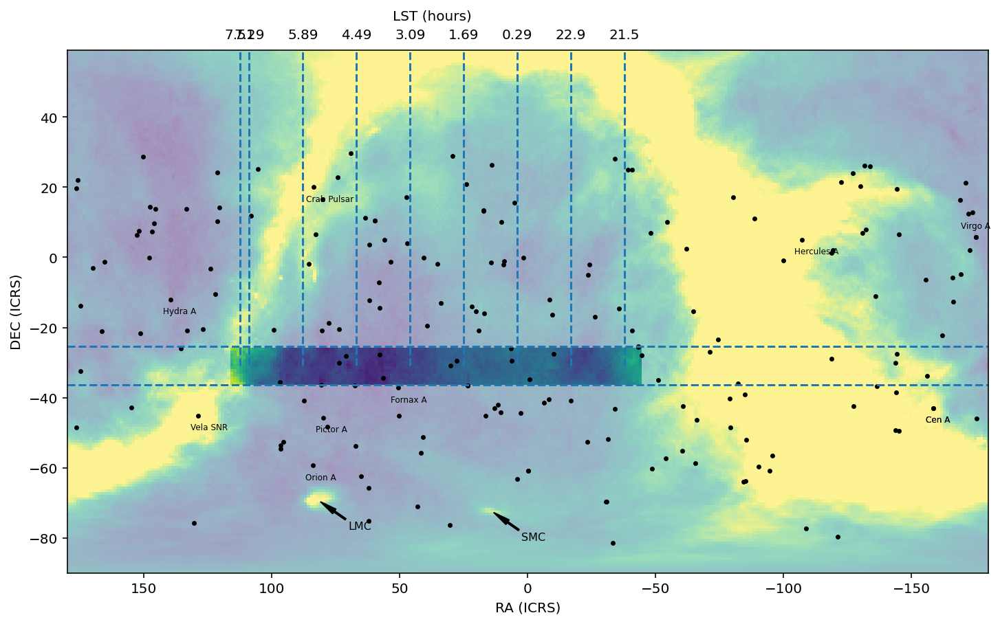

In [7]:
sources = utils.gather_source_list()
utils.plot_sky_map(uvd,dec_pad=55,ra_pad=55,clip=False,sources=sources)

## LST Coverage

Shows the LSTs (in hours) and JDs for which data is collected. Green represents data, red means no data.

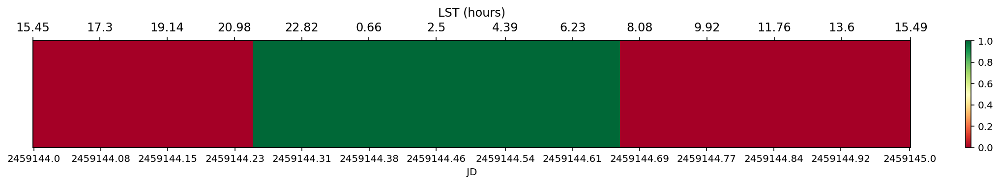

In [5]:
utils.plot_lst_coverage(uvd)

62.5457763671875 125.0457763671875 187.5457763671875
62.5457763671875 125.0457763671875 187.5457763671875


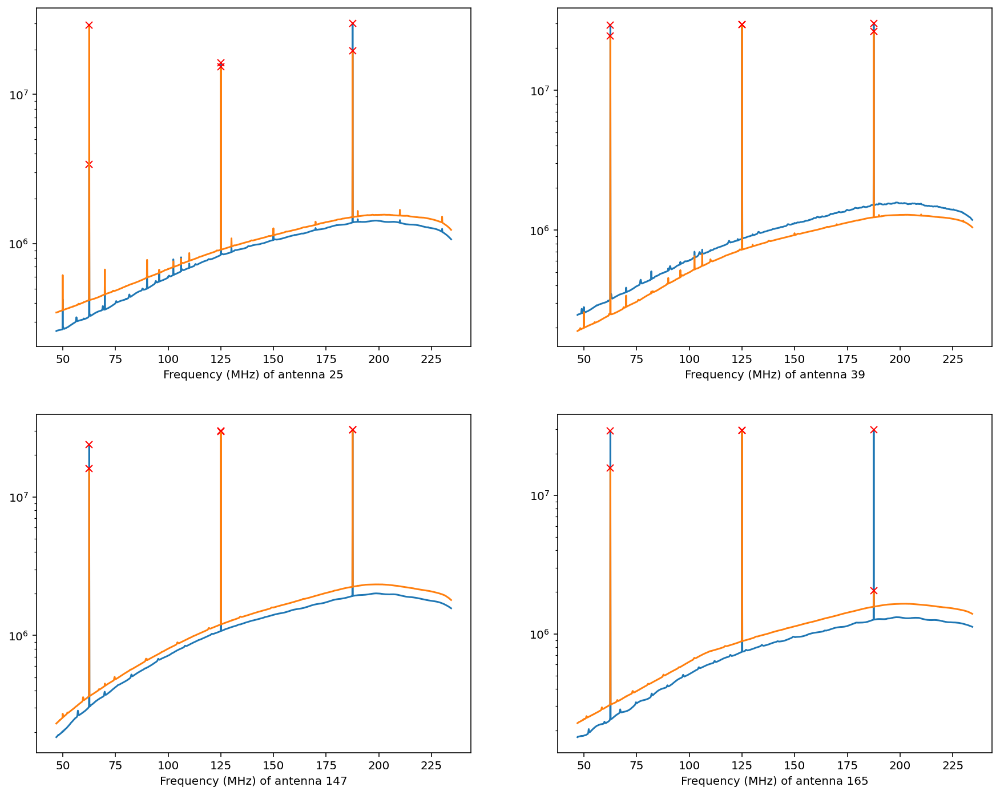

<Figure size 864x864 with 0 Axes>

In [18]:
plot_four_clocks(25,39,147,165)

Antenna25 xx and yy
[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]
Antenna39 xx and yy
[ 49.97253418  58.0291748   62.9119873   69.99206543  76.95007324
  81.95495605  90.86608887  98.43444824 106.12487793 116.13464355
 122.97058105]
[ 49.97253418  56.56433105  62.42370605  69.99206543  75.85144043
  82.68737793  90.01159668  95.74890137 106.12487793 124.92370605
 130.05065918]
Antenna147 xx and yy
[ 50.94909668  57.17468262  62.42370605  69.86999512  82.56530762
  95.38269043 108.07800293 124.92370605 133.71276855]
[ 52.1697998   59.61608887  67.18444824  74.6307373   82.19909668
  89.52331543 104.41589355 110.03112793 119.43054199 124.92370605
 134.32312012]
Antenna165 xx and yy
[ 47.04284668  52.29187012  59.73815918  67.18444824  74.752807

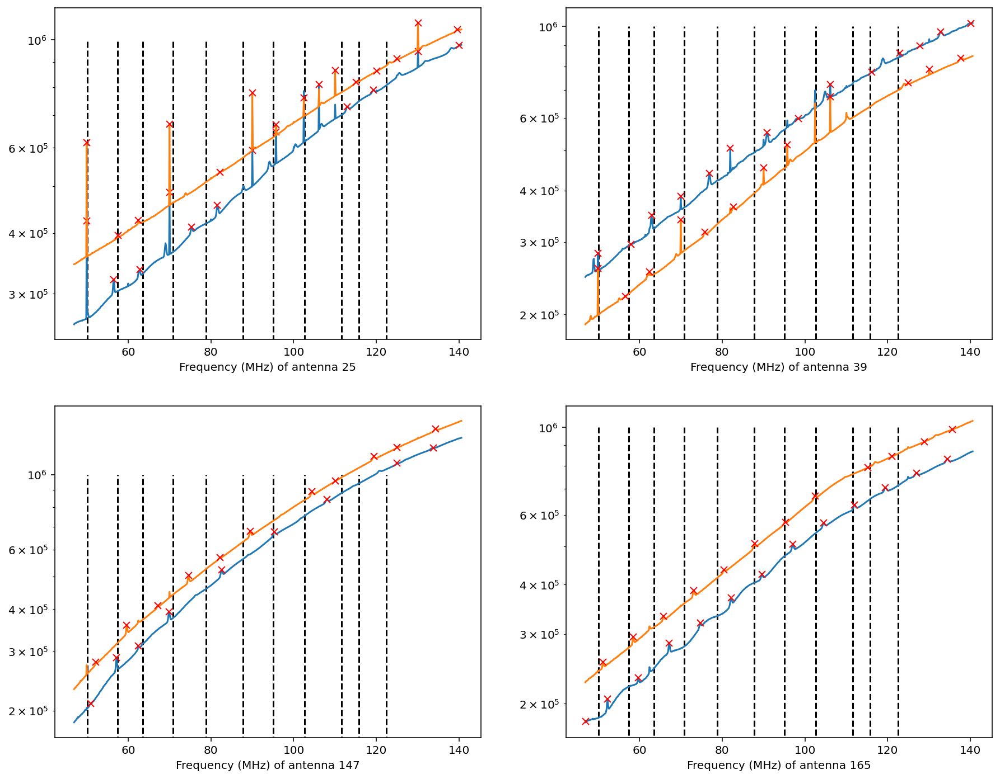

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [34]:
plot_four_noclocks(25,39,147,165)

[0 1 2 3 4 5]


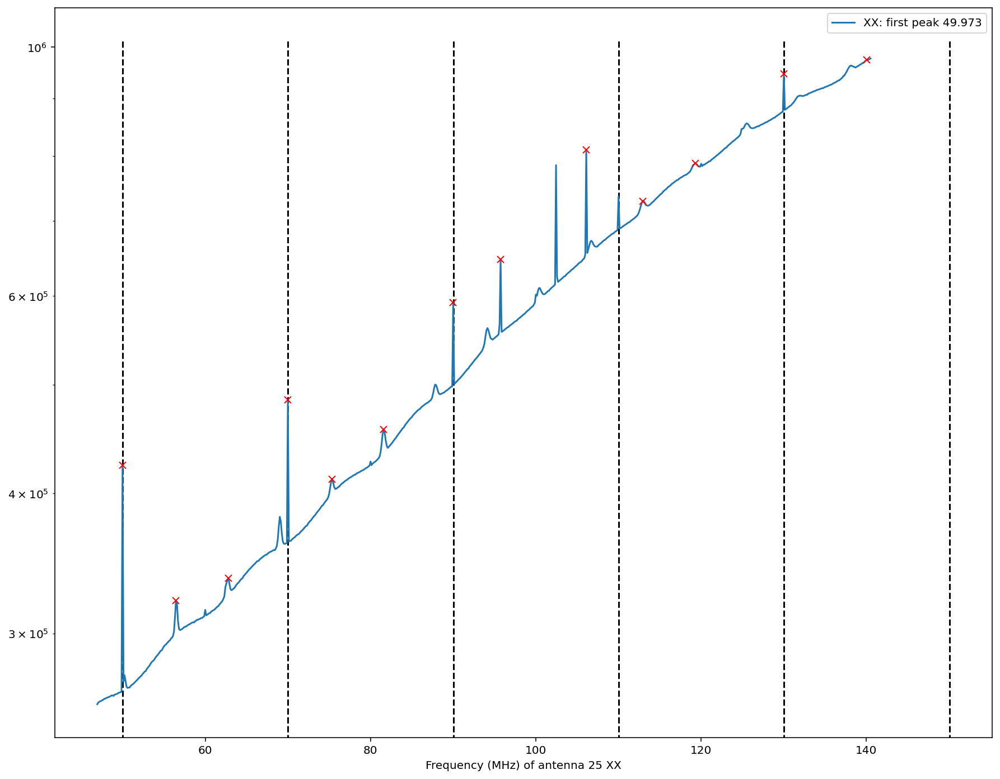

In [18]:
length = np.arange(0,6,1)
custom_single_plot(25, 20.025, 49.97, length)
print (length)

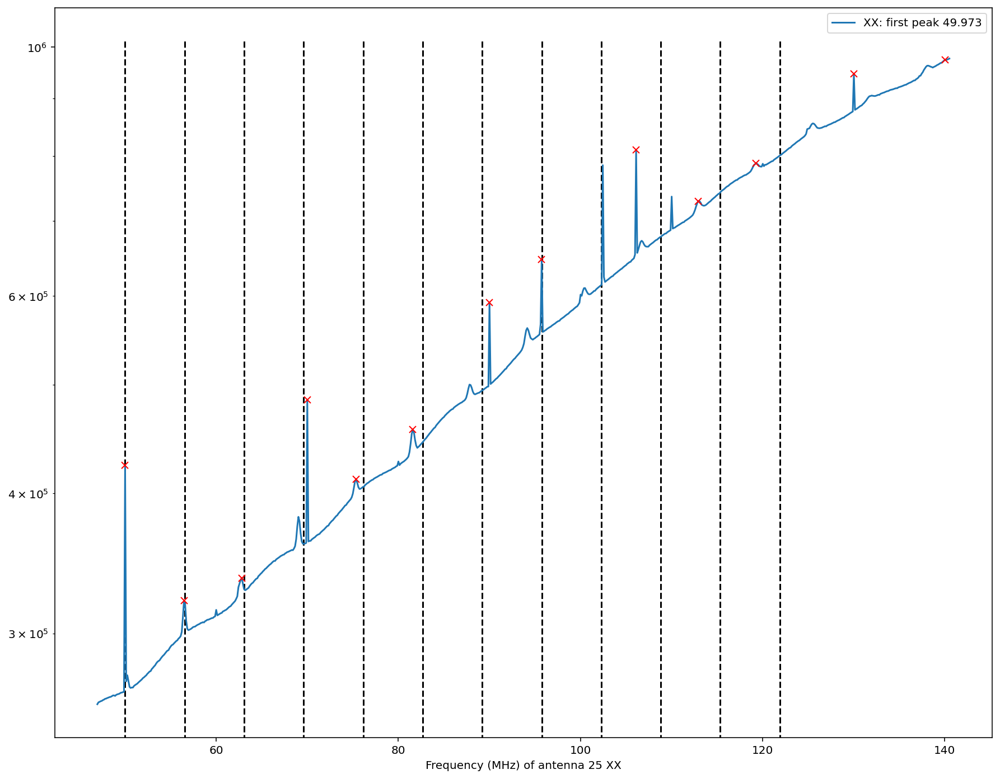

In [57]:
single_plotp1_test_xx(25, 6.54) #This number was found by finding the difference between the first and eight peak using big peaks

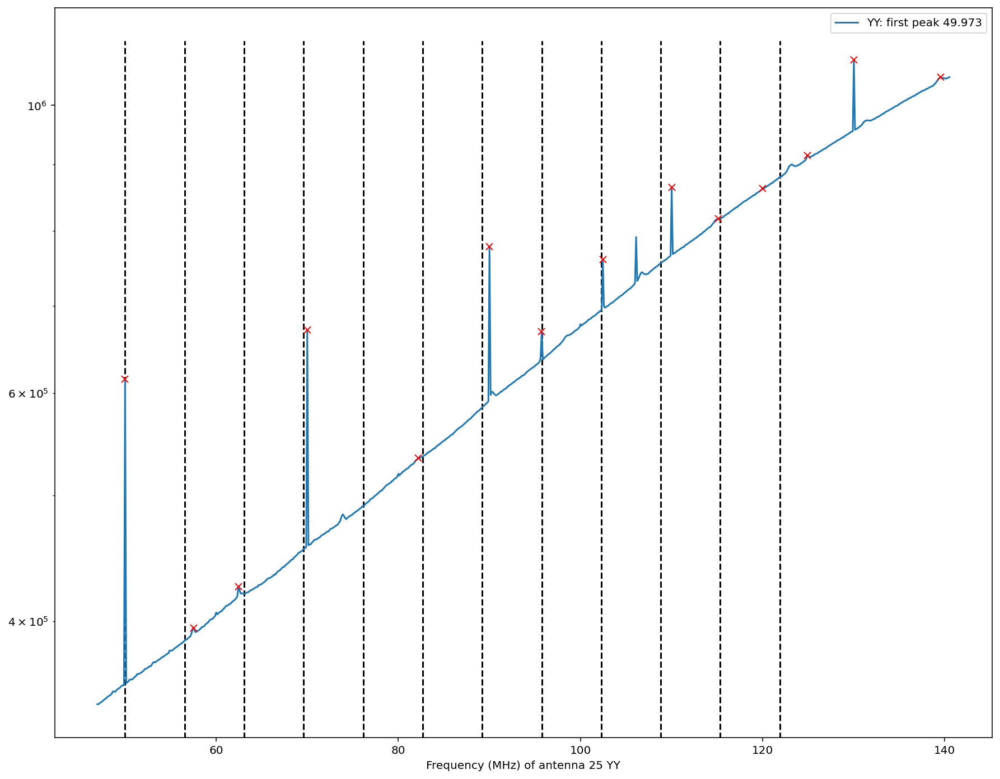

In [49]:
single_plotp1_test_yy(25, 6.54) #overlay of xx polarization using big peaks

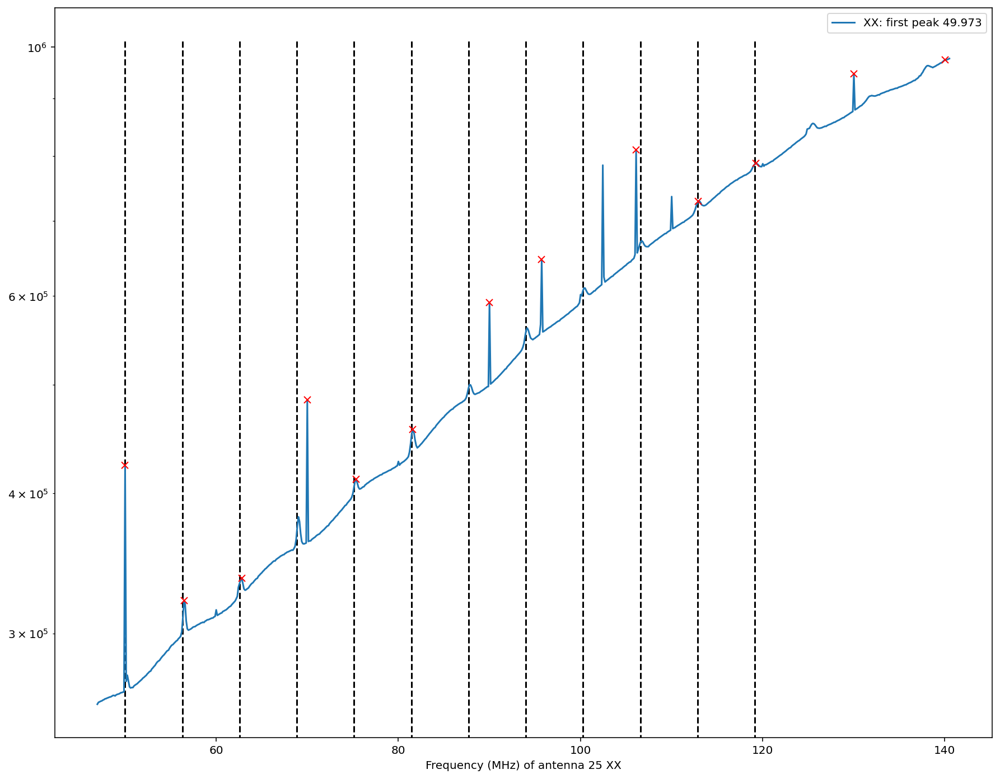

In [50]:
single_plotp1_test_xx(25, 6.29) #this number was found by finding the difference in the second and sixth peak using the small peaks.

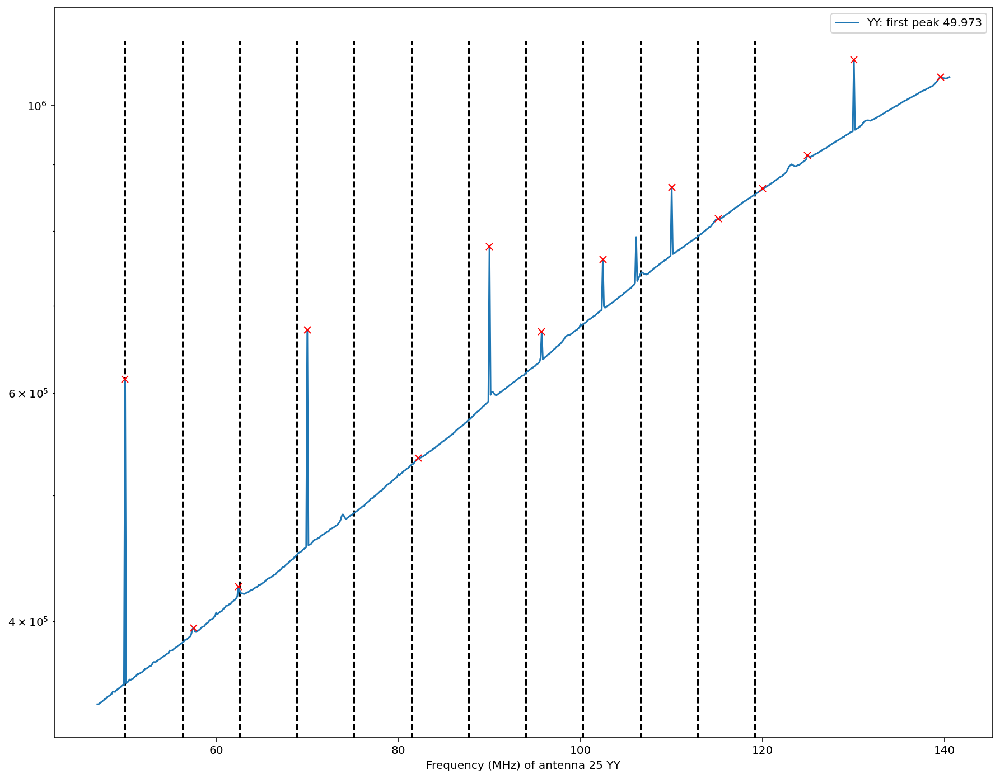

In [58]:
single_plotp1_test_yy(25, 6.29) #overlay of xx polarization using small peaks

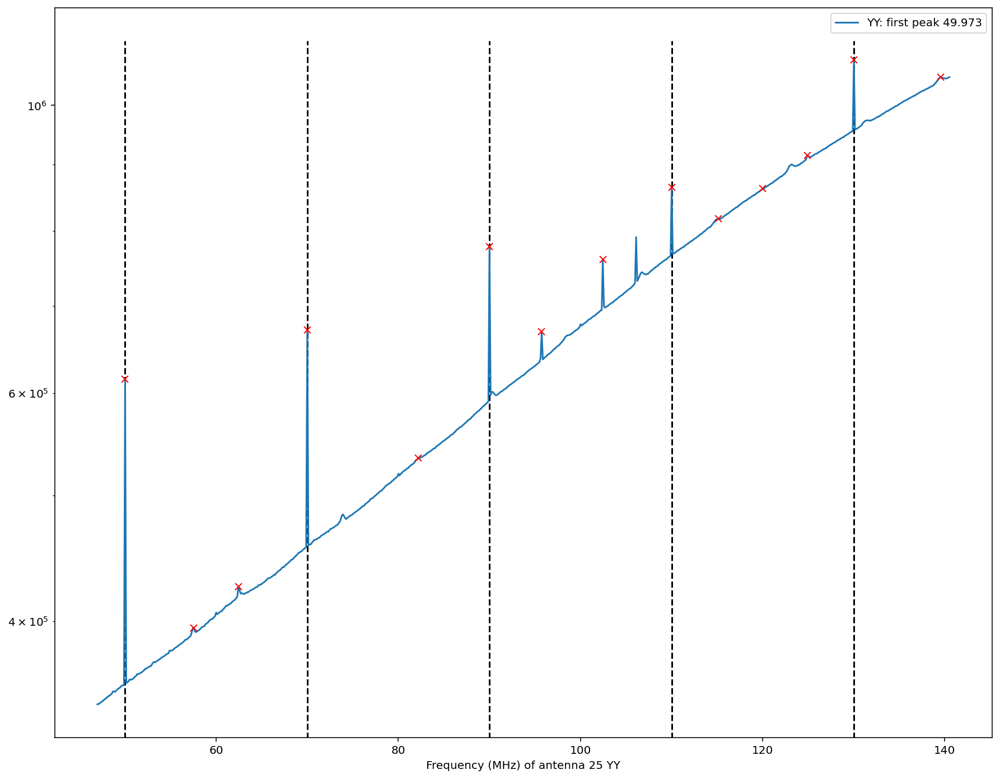

In [16]:
single_plotp2_test_yy(25, 20.025)

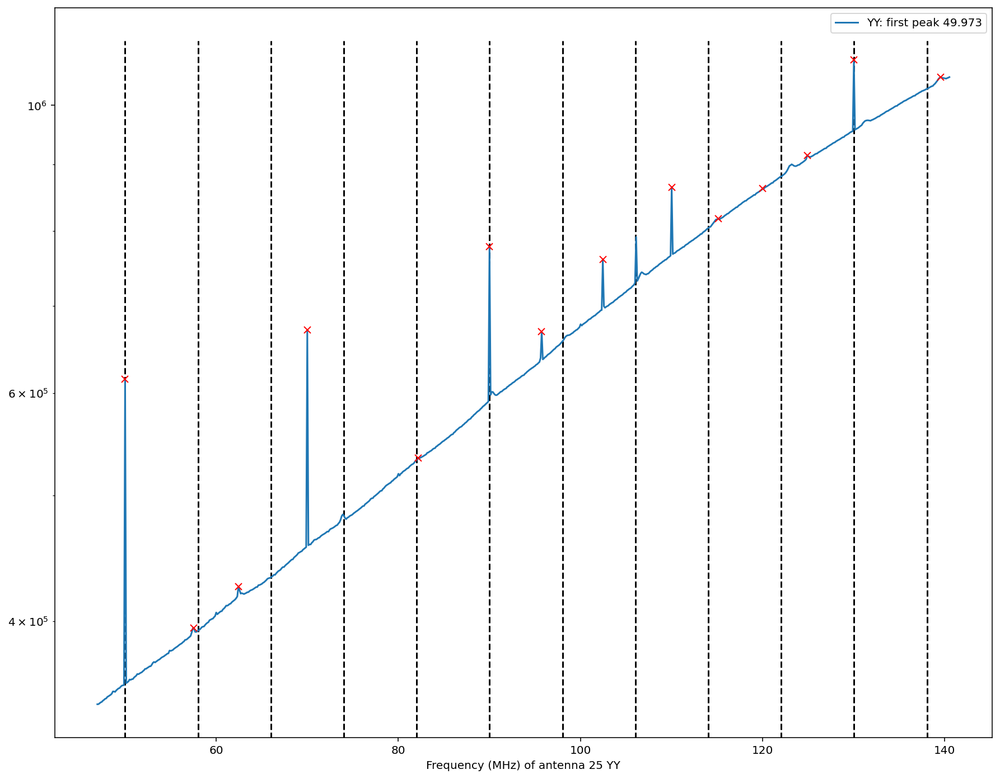

In [74]:
single_plotp2_test_yy(25, 8.01) #difference found between first and sixth peaks using big peaks

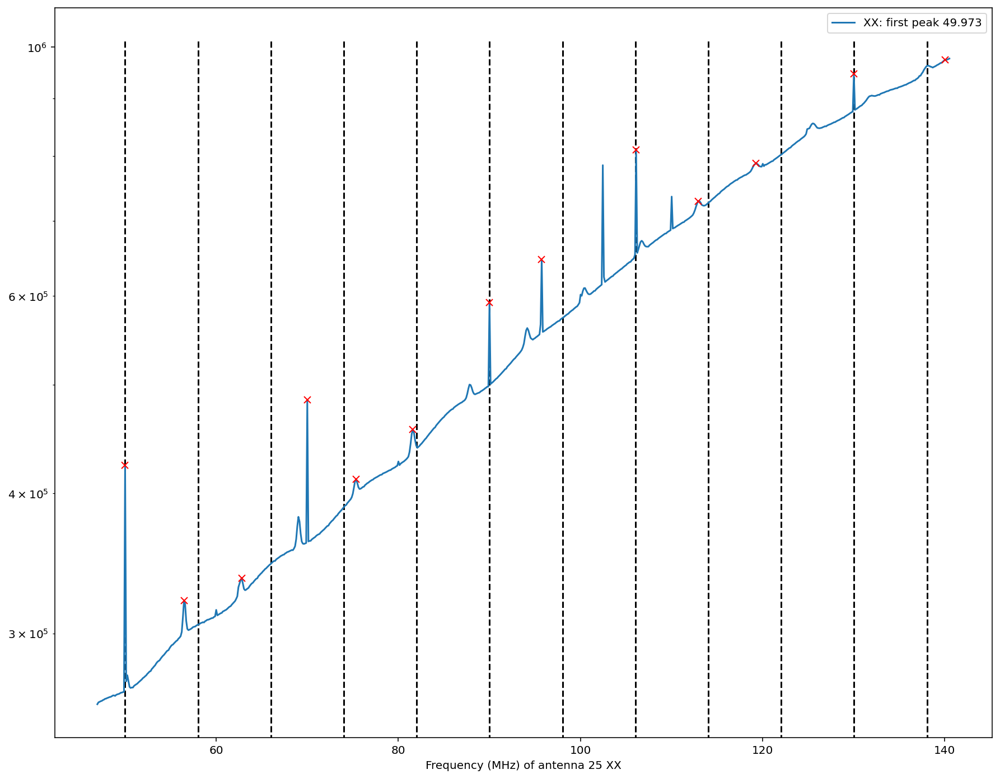

In [64]:
single_plotp2_test_xx(25, 8.01) #overlay of YY polarization using big peaks

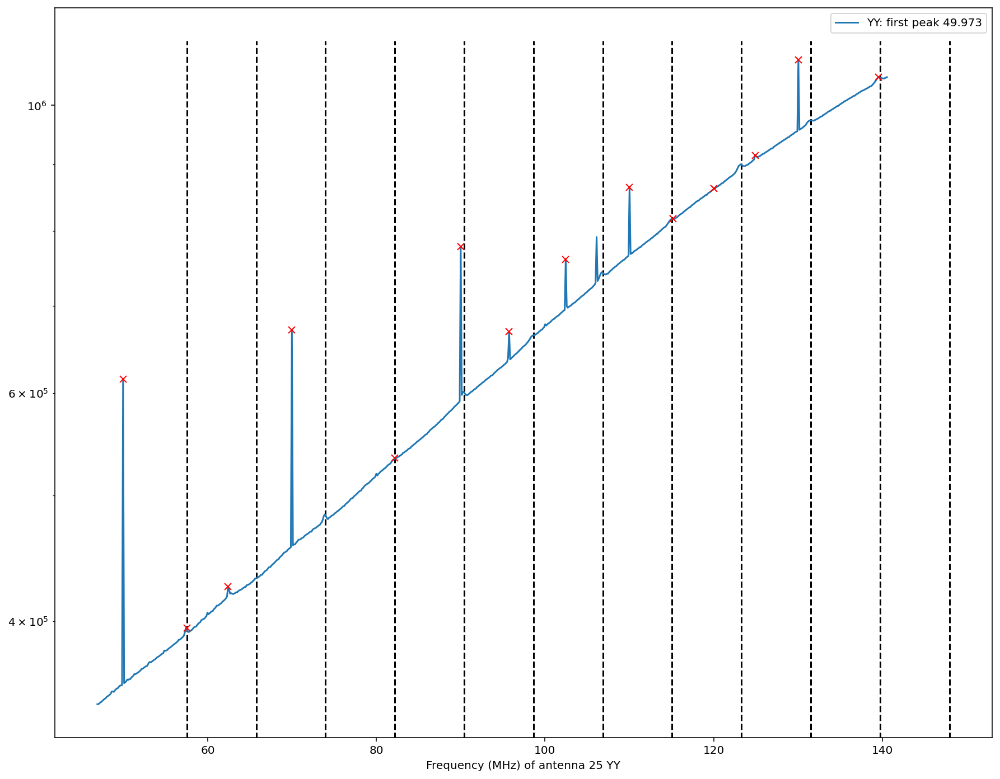

In [67]:
single_plotp2_test_yy(25, 8.22) #difference found using the second and fifth peaks. small peaks

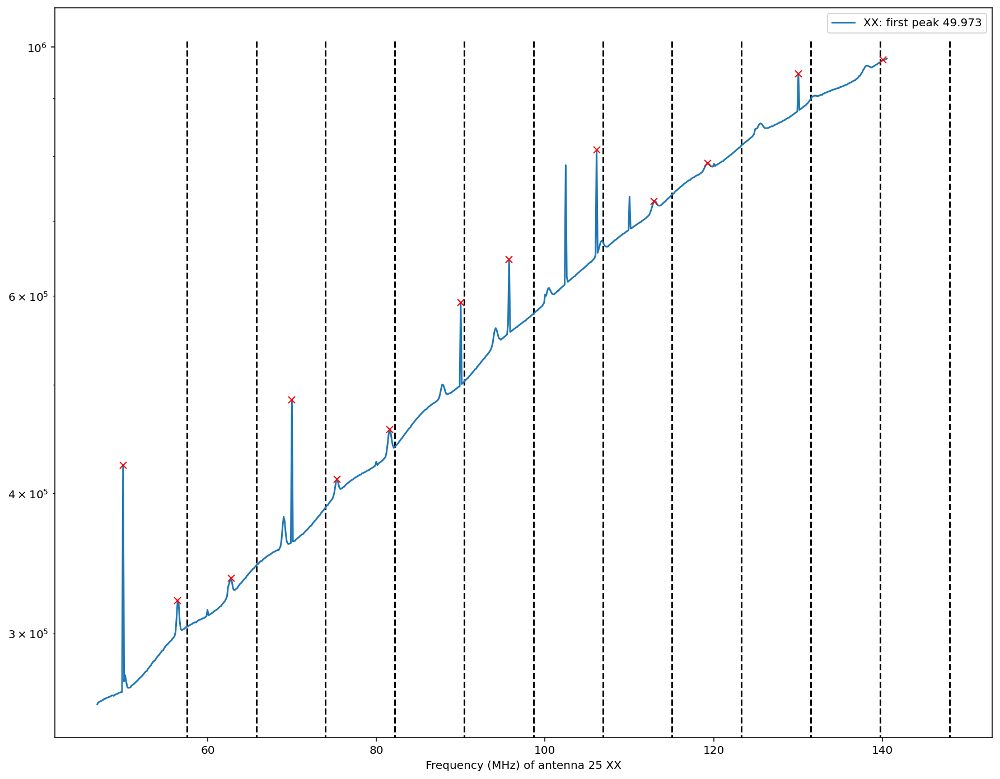

In [70]:
single_plotp2_test_xx(25, 8.22) #overlay of YY polarization using small peaks

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


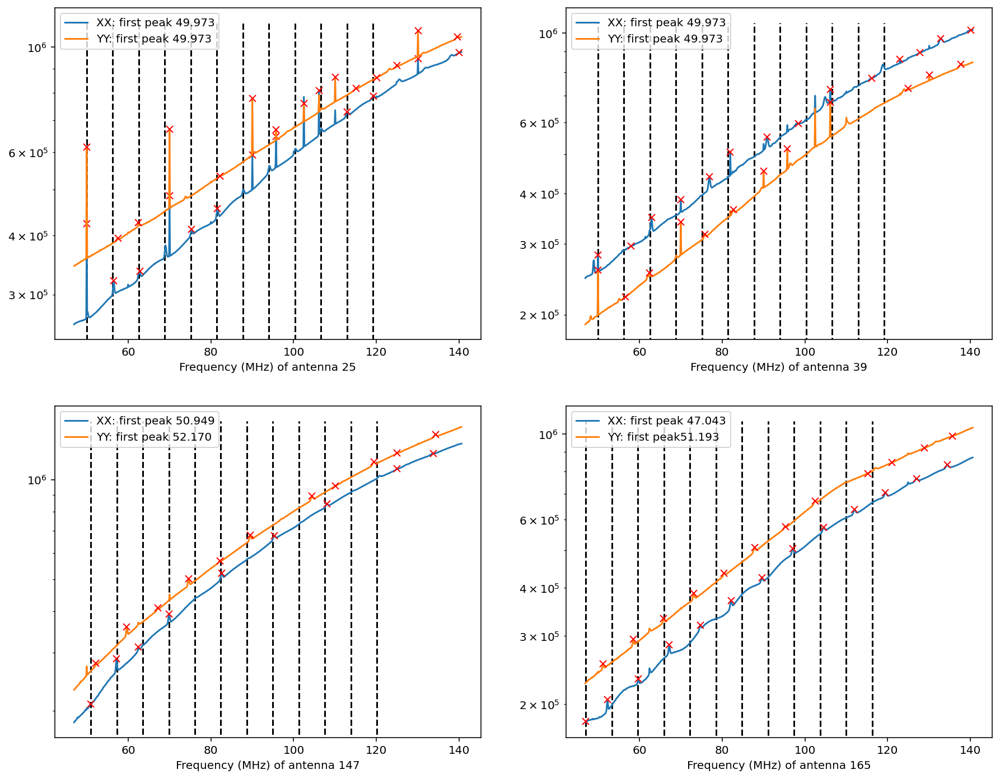

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [10]:
plot_four_noclocks_even(25,39,147,165,6.29) #xx using small peaks based off of ant 25

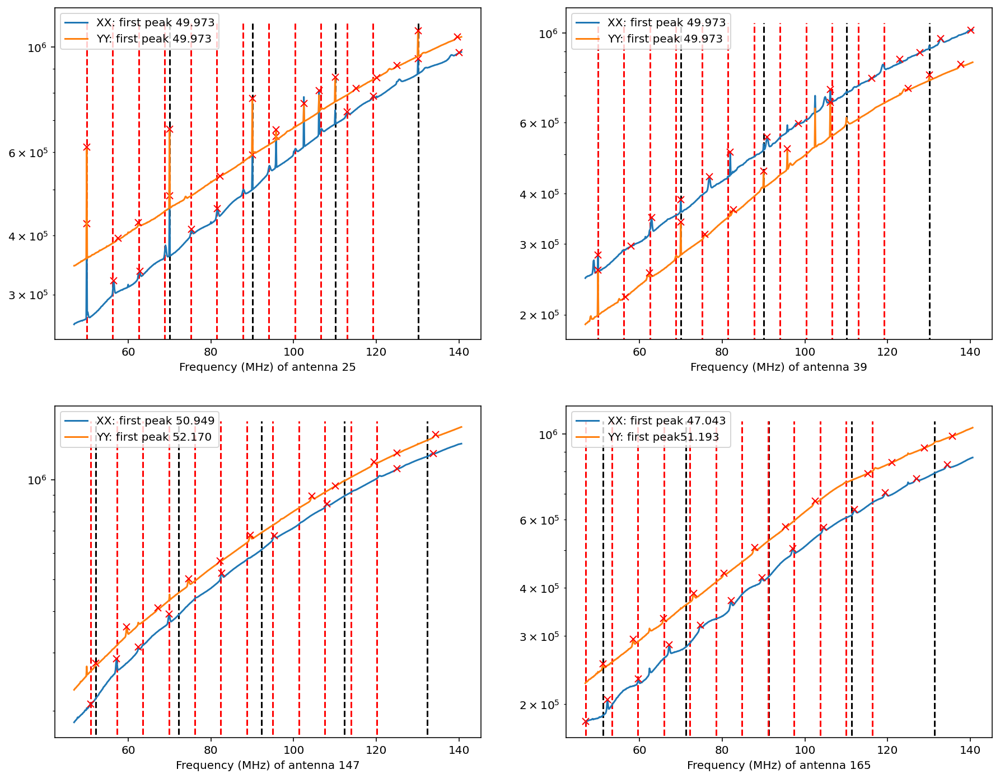

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [26]:
plot_both(25,39,147,165,20.025,6.29) #plot in order of yy and then xx

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]
[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


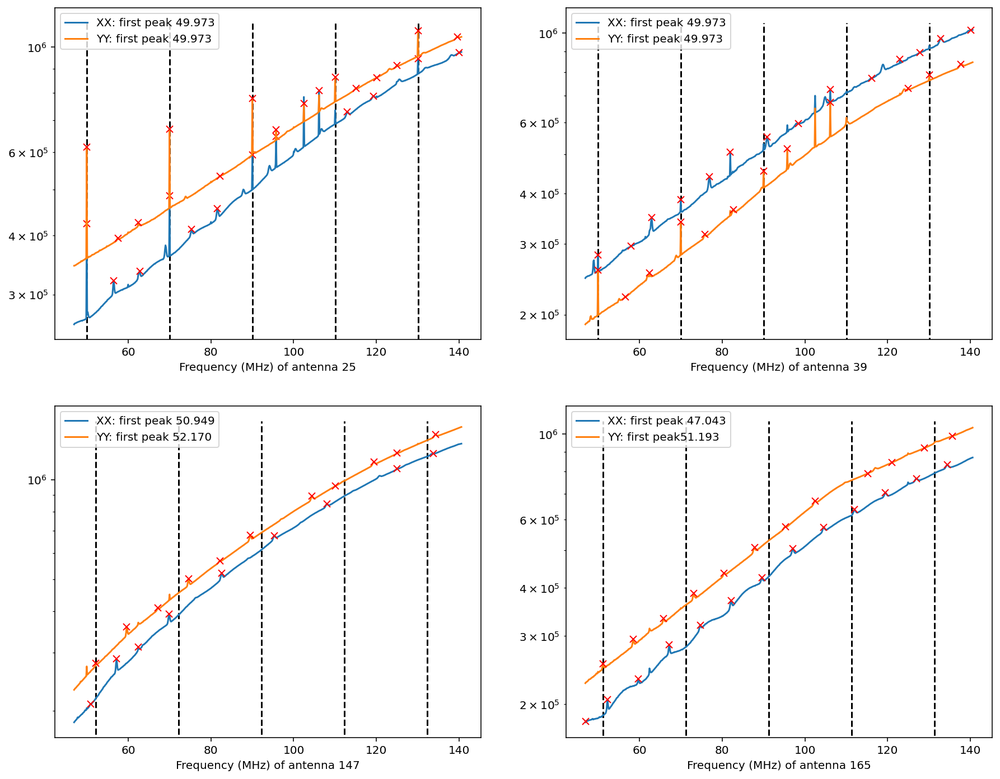

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

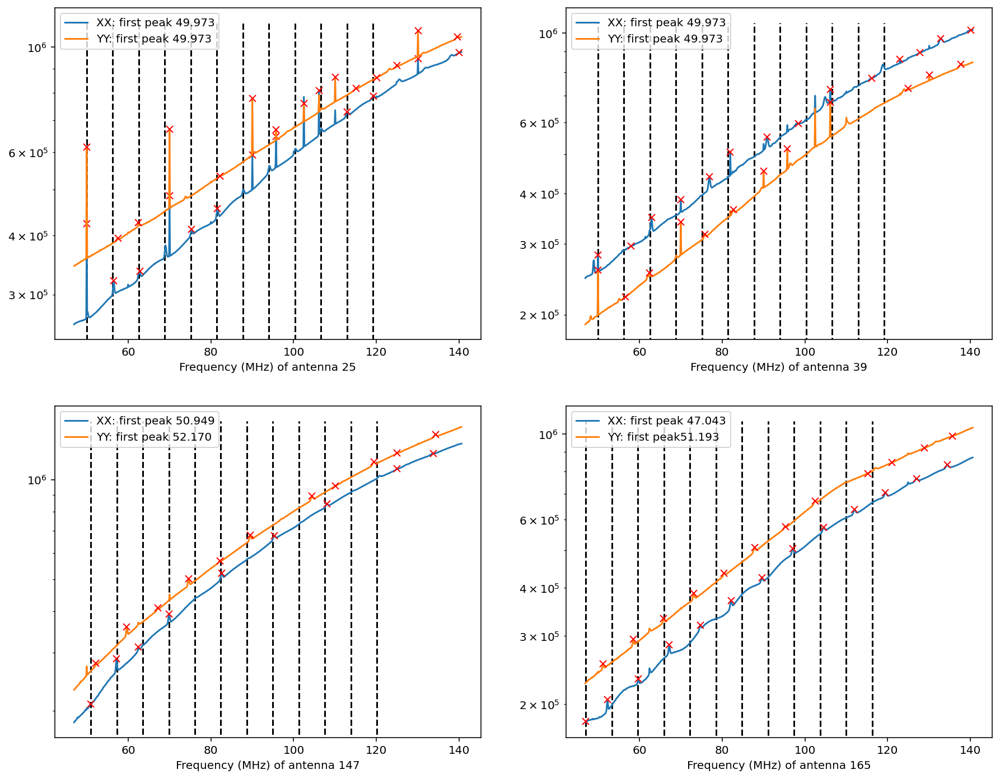

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [19]:
plot_four_noclocks_even_yy(25,39,147,165,20.025)

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


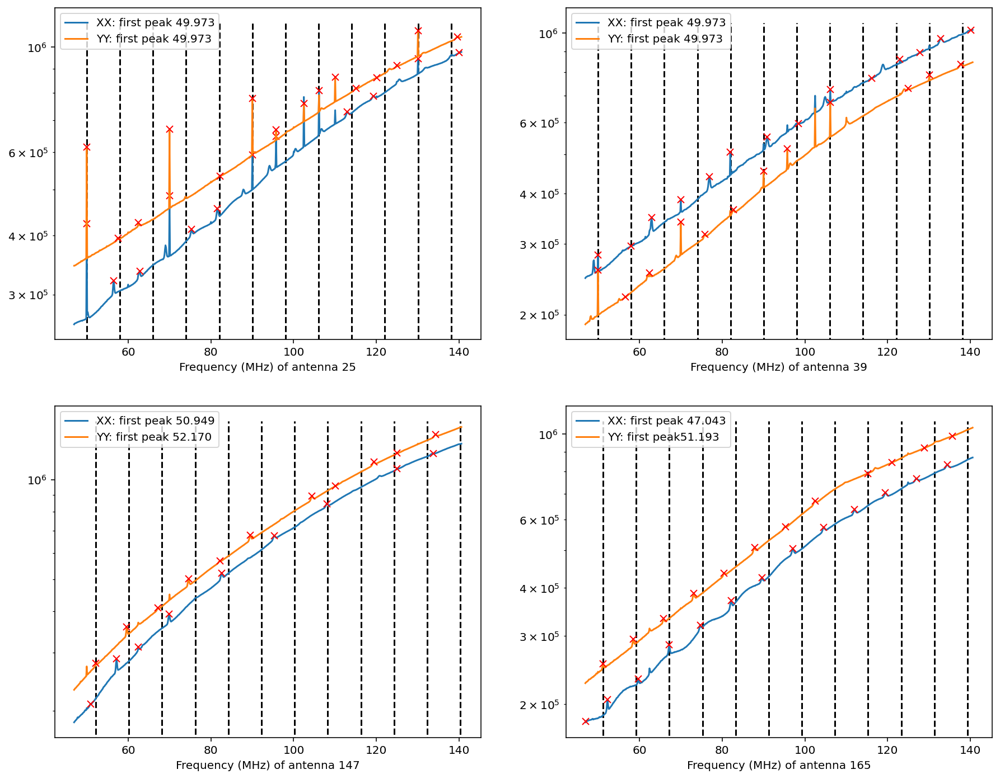

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [19]:
plot_four_noclocks_even_yy(25,39,147,165,8.01)#yy using big peaks based off of ant 25

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


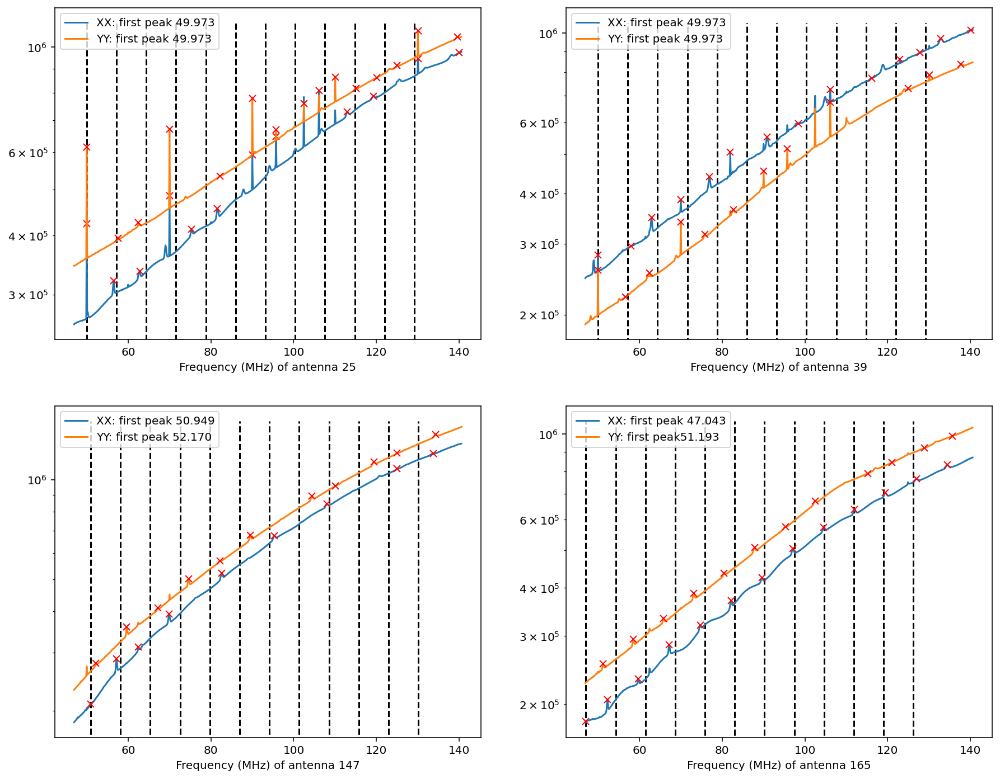

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [78]:
plot_four_noclocks_even(25,39,147,165,7.2)

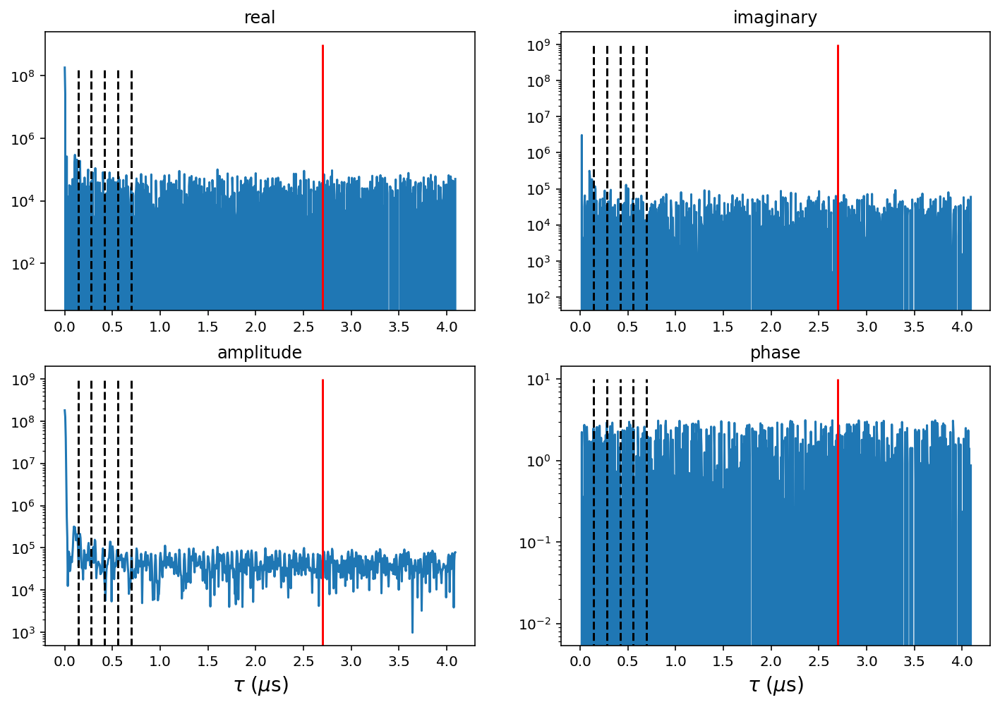

In [10]:
N = len(freq)
window = signal.blackmanharris(N)
wnorm = N / np.sum(window)
delay_data1, delay_array1 = delay_transform(window*data1_avg, freq)
stop_ind = int(len(delay_data1) / 2)
plot_delay_spectrum(wnorm*delay_data1, delay_array1, 7.2, plot_half=True, scale='log')

# delay_data1, delay_array1 = delay_transform(data1_avg, freq)
# stop_ind = int(len(delay_data1) / 2)
# plot_delay_spectrum(delay_data1, delay_array1, plot_half=True, scale='log')

# delay_data1, delay_array1 = delay_transform(data1[187,:], freq)
# stop_ind = int(len(delay_data1) / 2)
# plot_delay_spectrum(delay_data1, delay_array1, plot_half=True, scale='log')

In [11]:
hf_delay_data1, hf_delay_array1 = hyperfine_delay_transform(data1_avg, freq, 11, 100)
plot_delay_spectrum(hf_delay_data1, hf_delay_array1)

TypeError: plot_delay_spectrum() missing 1 required positional argument: 'f'

In [ ]:
delay_data2, delay_array2 = delay_transform(data2[187,:], freq)
stop_ind = int(len(delay_data2) / 2)
plot_delay_spectrum(delay_data2, delay_array2, plot_half=True, scale='log')

In [ ]:
indicies = np.nonzero(np.abs(delay_data2[10:200]) == np.max(np.abs(delay_data2[10:200])))
print (indicies[0])

In [ ]:
hf_delay_data2, hf_delay_array2 = hyperfine_delay_transform(data2[187,:], freq, 0, 200)
plot_delay_spectrum(hf_delay_data2, hf_delay_array2)

In [ ]:
hf_delay_data2, hf_delay_array2 = hyperfine_delay_transform(data2[187,:], freq, 11, 200)
plot_delay_spectrum(hf_delay_data2, hf_delay_array2)

62.5457763671875 125.0457763671875 187.5457763671875
62.5457763671875 125.0457763671875 187.5457763671875


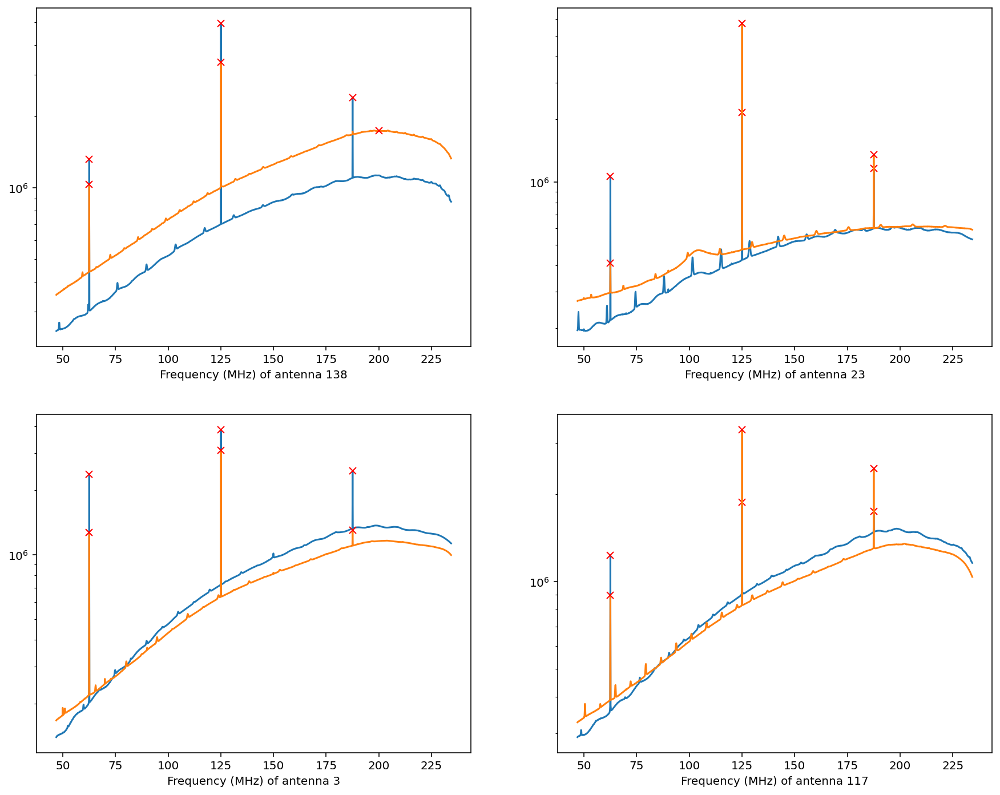

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [31]:
plot_four_clocks(138,23,3,117)

Antenna138 xx and yy
[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]
Antenna23 xx and yy
[ 47.40905762  54.61120605  60.9588623   69.25964355  74.50866699
  80.00183105  88.05847168  95.62683105 101.48620605 106.61315918
 115.03601074]
[ 47.77526855  53.39050293  62.42370605  68.64929199  78.04870605
  83.90808105  93.67370605  99.28894043 104.17175293 109.54284668
 114.54772949]
Antenna3 xx and yy
[ 48.75183105  53.63464355  62.42370605  69.99206543  74.87487793
  82.32116699  89.76745605  97.33581543 104.78210449 112.47253418
 119.79675293]
[ 49.97253418  60.47058105  65.59753418  74.14245605  80.12390137
  87.57019043  94.77233887 102.21862793 109.29870605 117.11120605
 123.94714355]
Antenna117 xx and yy
[ 48.62976074  56.56433105  62.667846

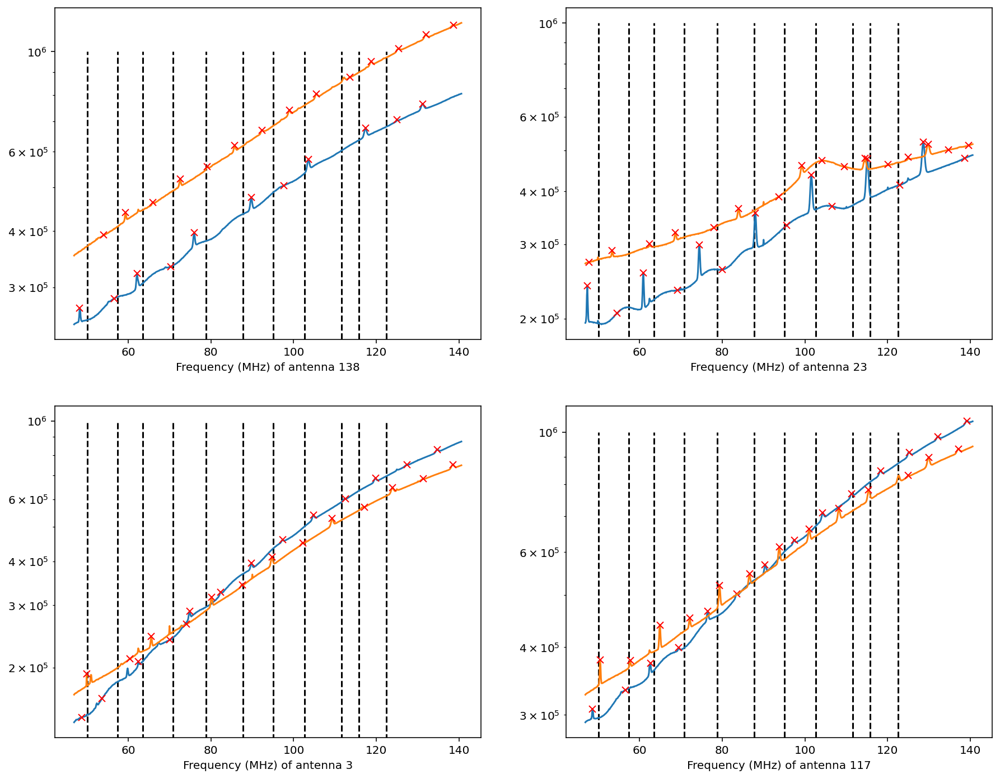

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [21]:
plot_four_noclocks(138, 23, 3, 117)

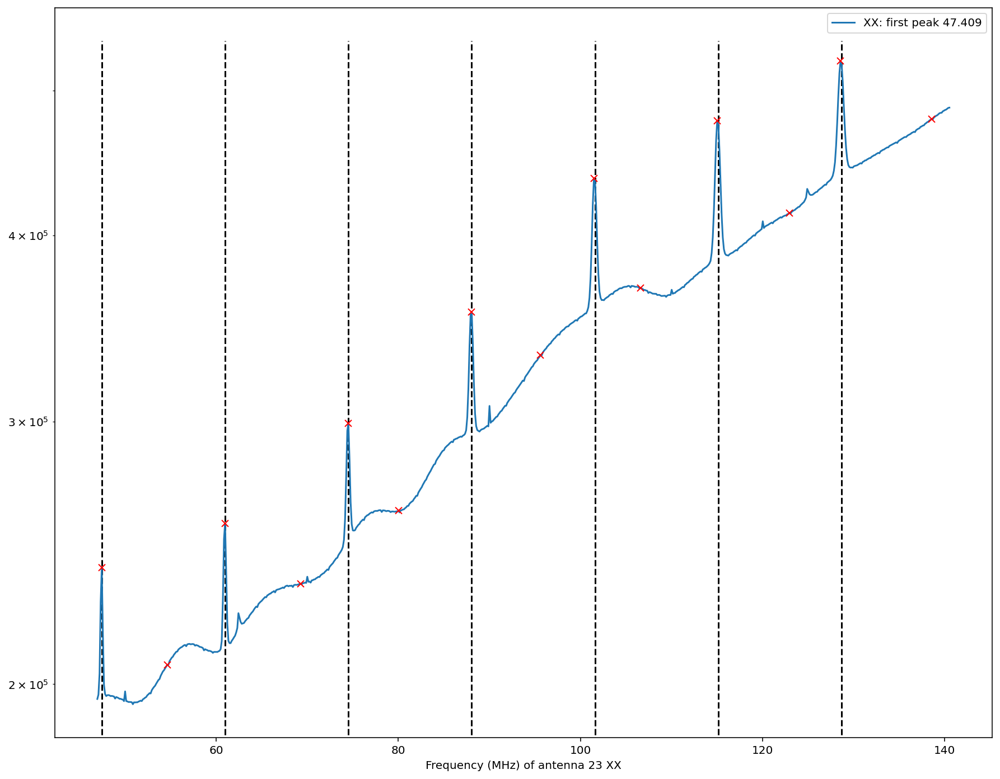

In [67]:
custom_single_plot(23, 13.55, 47.409, 7, 'xx') #spacing 13.55 found using 3rd and 5th peaks

[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]


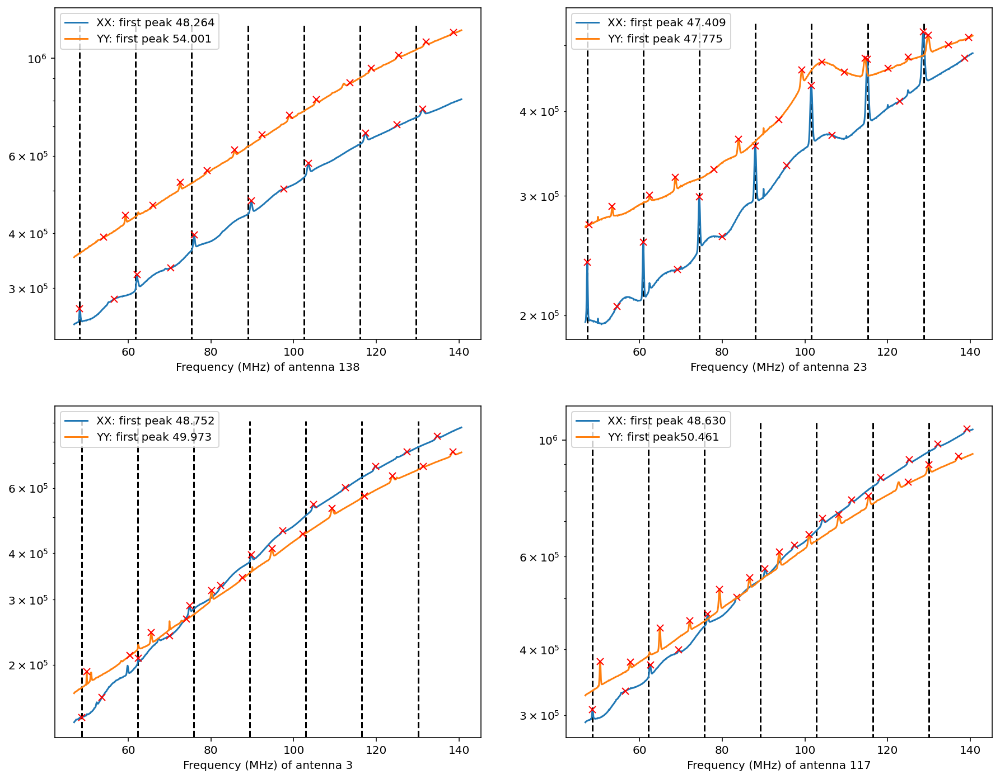

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [76]:
plot_four_noclocks_even(138, 23, 3, 117, 13.55, 7) #difference found using ant 23 peaks 3 & 5 xx

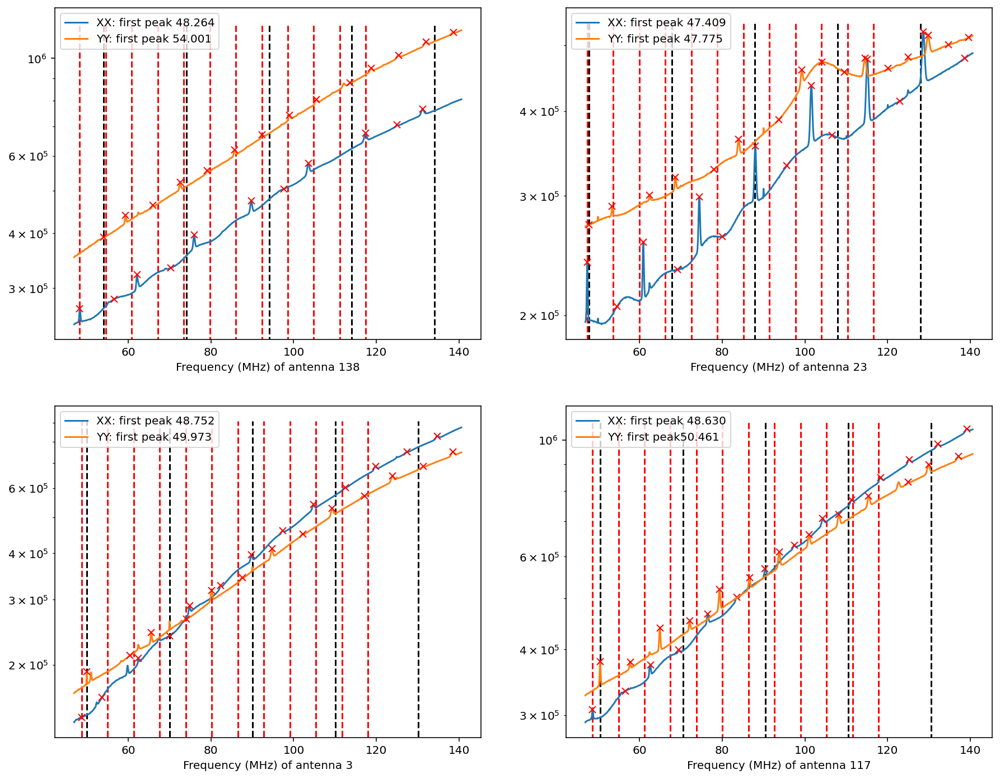

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [27]:
plot_both(138, 23, 3, 117, 20.025, 6.29) #plot in order of yy and then xx

[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]


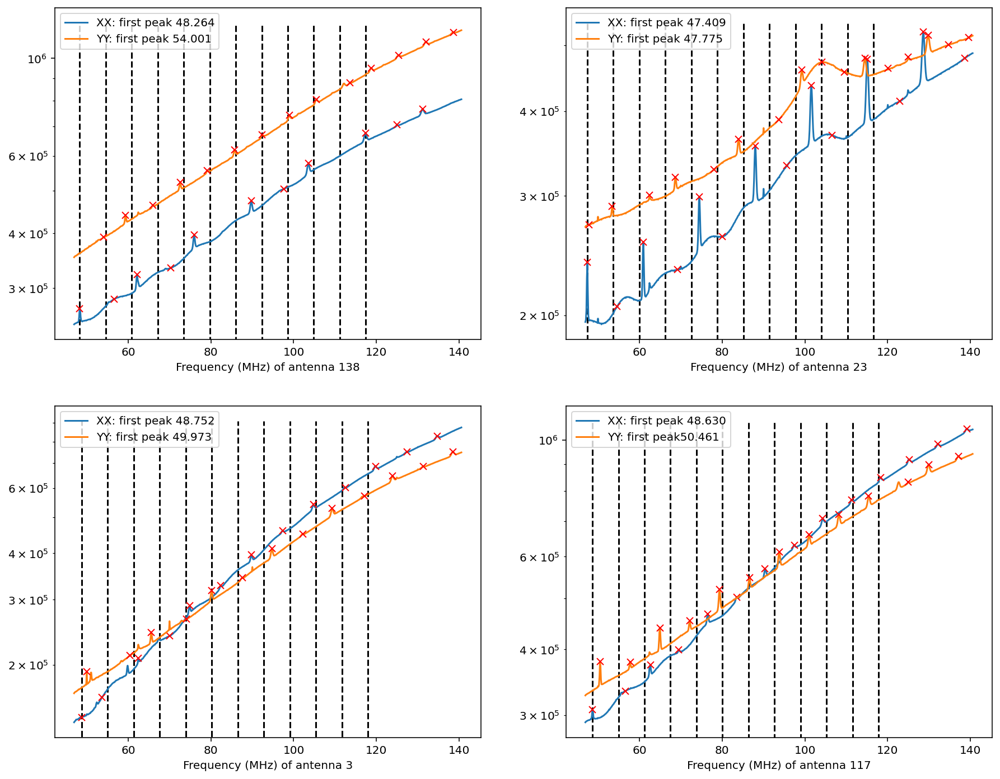

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [11]:
plot_four_noclocks_even(138, 23, 3, 117, 6.29)#xx using small peaks based off of ant 25

[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]


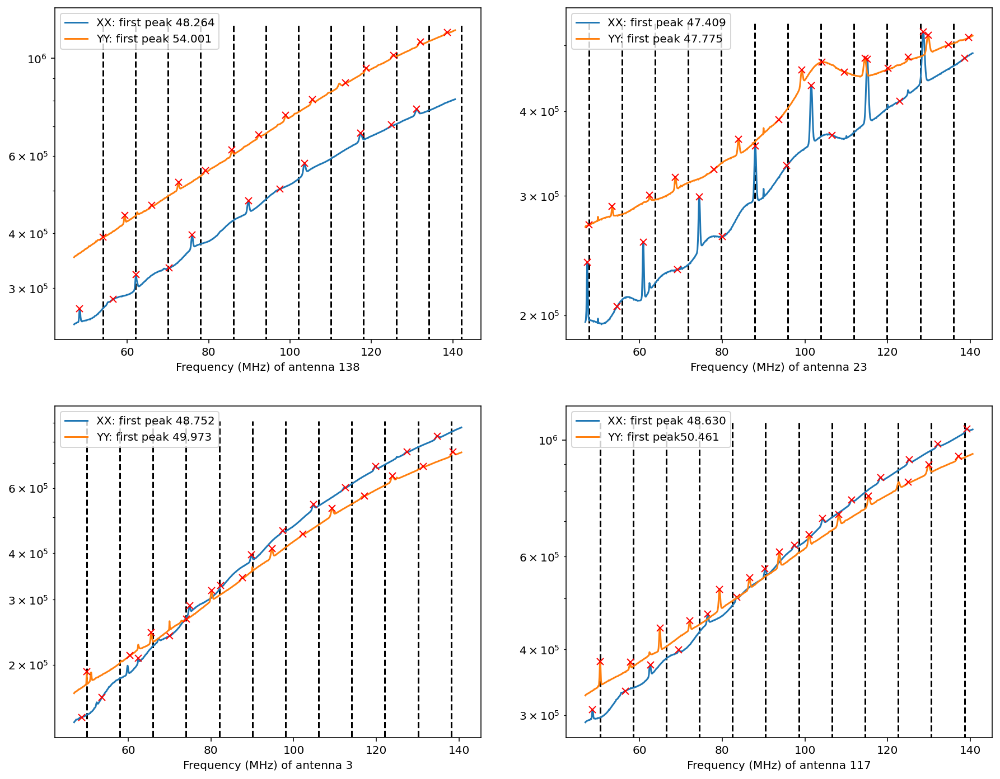

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [20]:
plot_four_noclocks_even_yy(138, 23, 3, 117, 8.01)#yy using big peaks based off of ant 25

[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]


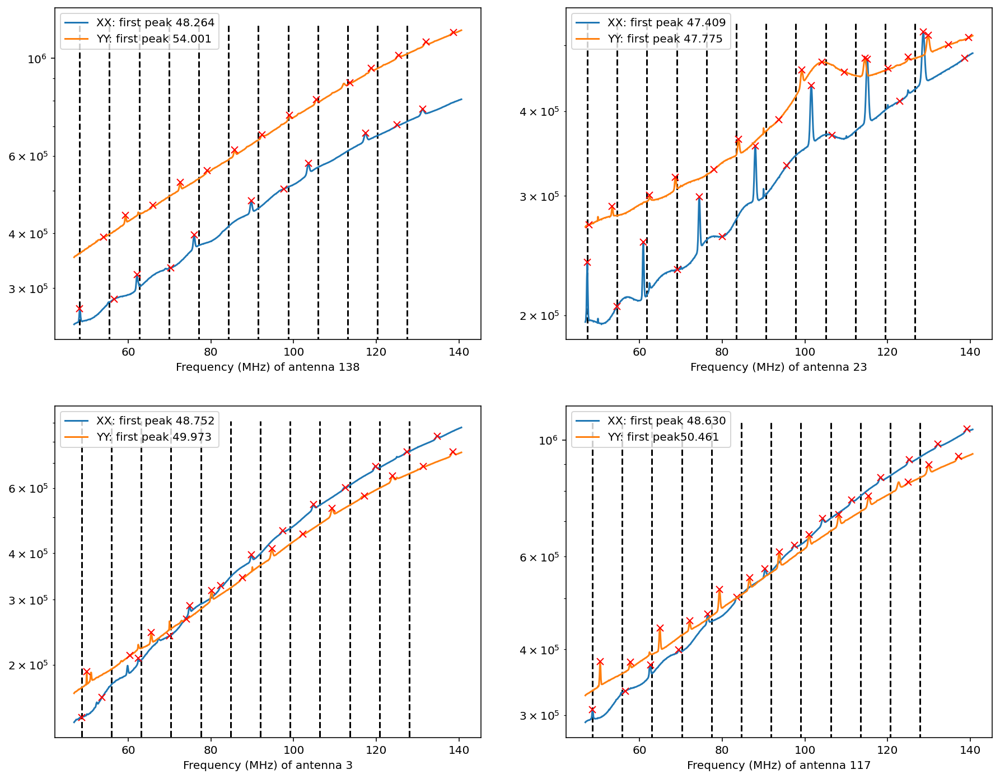

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [79]:
plot_four_noclocks_even(138, 23, 3, 117, 7.2)

In [ ]:
N = len(freq)
window = signal.blackmanharris(N)
wnorm = N / np.sum(window)
delay_data138yy, delay_array138yy = delay_transform(window*data138yy_avg, freq)
stop_ind = int(len(delay_data138yy) / 2)
plot_delay_spectrum(wnorm*delay_data138yy, delay_array138yy, 7.2, plot_half=True, scale='log')

# delay_data138yy, delay_array138yy = delay_transform(data138yy_avg, freq)
# stop_ind = int(len(delay_data138yy) / 2)
# plot_delay_spectrum(delay_data138yy, delay_array138yy, plot_half=True, scale='log')

In [ ]:
hf_delay_data138yy, hf_delay_array138yy = hyperfine_delay_transform(data138yy_avg, freq, 11, 200)
plot_delay_spectrum(hf_delay_data138yy, hf_delay_array138yy)

62.5457763671875 125.0457763671875 187.5457763671875
62.5457763671875 125.0457763671875 187.5457763671875


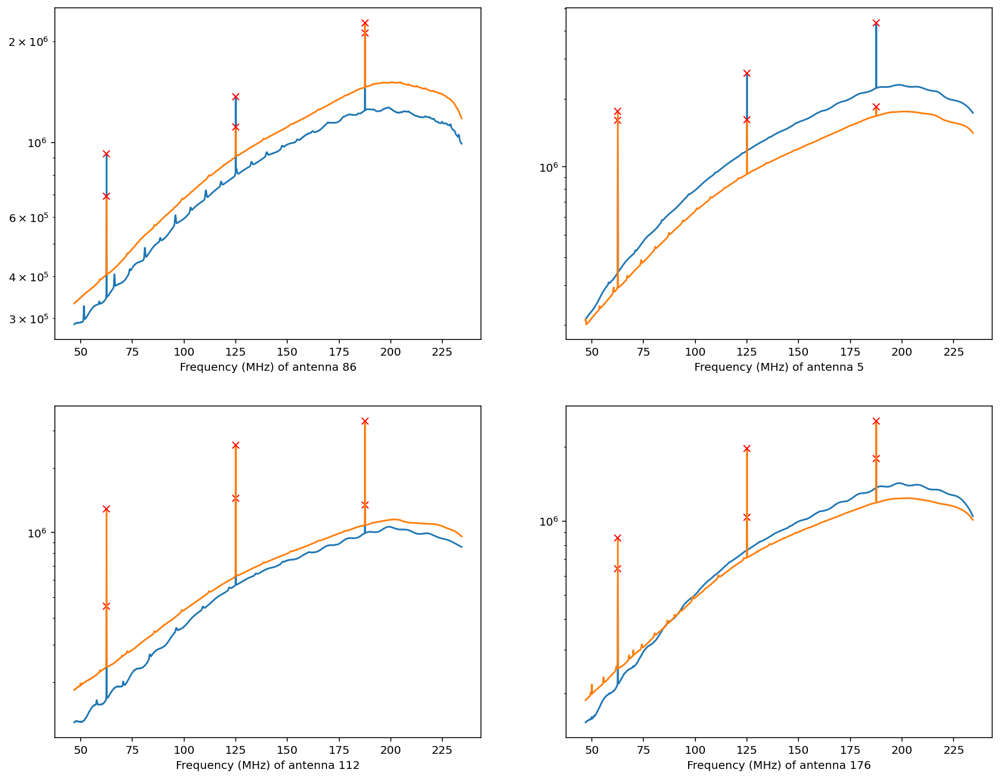

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [34]:
plot_four_clocks(86,5,112,176)

Antenna86 xx and yy
[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]
Antenna5 xx and yy
[ 62.42370605  70.96862793  83.90808105  96.96960449 109.90905762
 122.84851074 135.66589355]
[ 47.04284668  53.75671387  60.47058105  67.18444824  73.89831543
  80.61218262  87.3260498   94.03991699 100.75378418 107.58972168
 114.42565918]
Antenna112 xx and yy
[ 48.01940918  56.56433105  62.42370605  70.60241699  79.5135498
  87.81433105  96.35925293 109.17663574 121.99401855 128.82995605
 134.68933105]
[ 49.36218262  54.61120605  60.47058105  66.32995605  72.55554199
  78.04870605  85.73913574  91.72058105  99.0447998  112.10632324
 121.01745605]
Antenna176 xx and yy
[ 51.07116699  56.93054199  62.42370605  69.99206543  78.04870605
  87.81433105 109.29870605 117.11120605 124.92370605

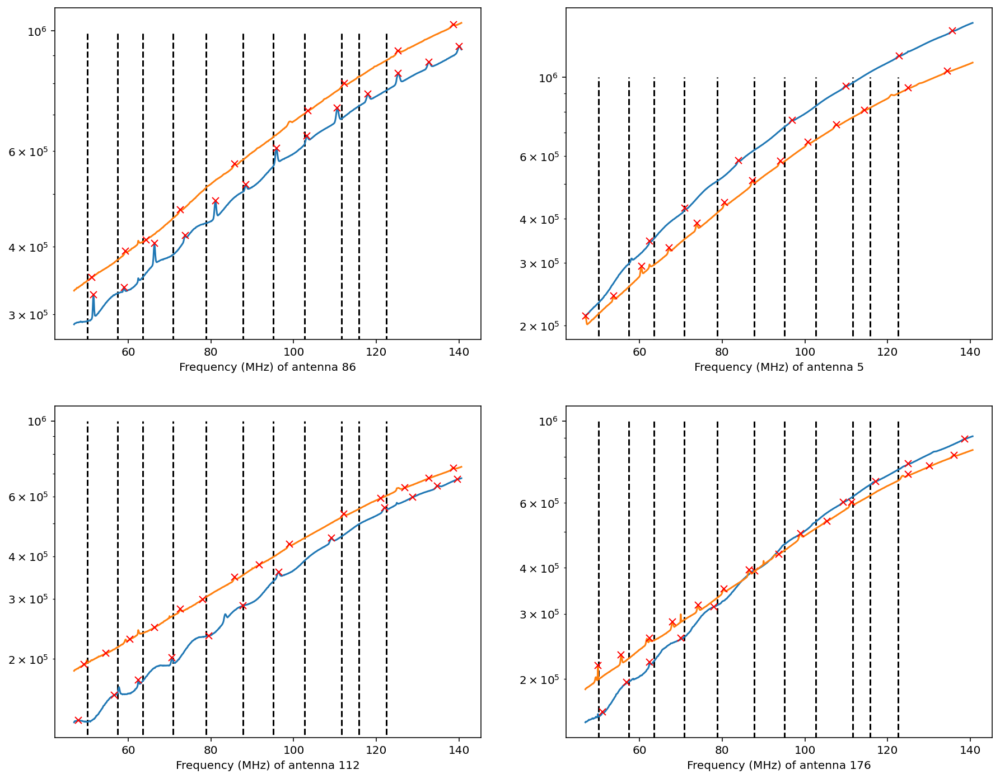

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [26]:
plot_four_noclocks(86,5,112,176)

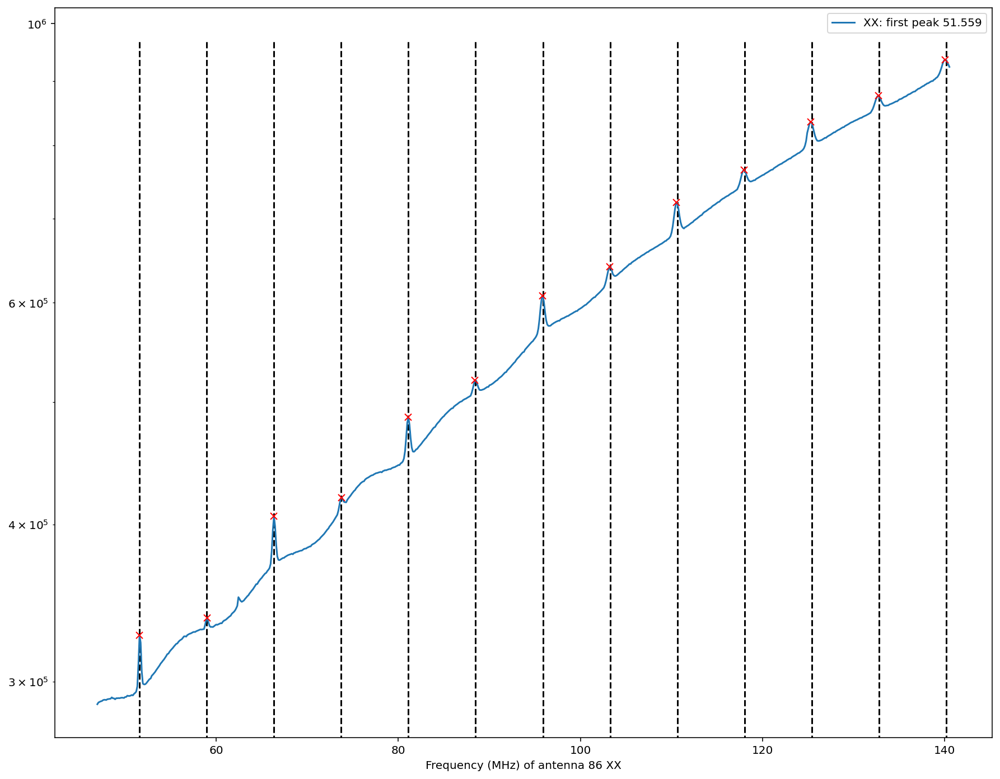

In [29]:
lines = np.arange(0,13,1)
custom_single_plot(86, 7.386, 51.559, lines) #found using 1 and 7 peaks in the xx

[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]


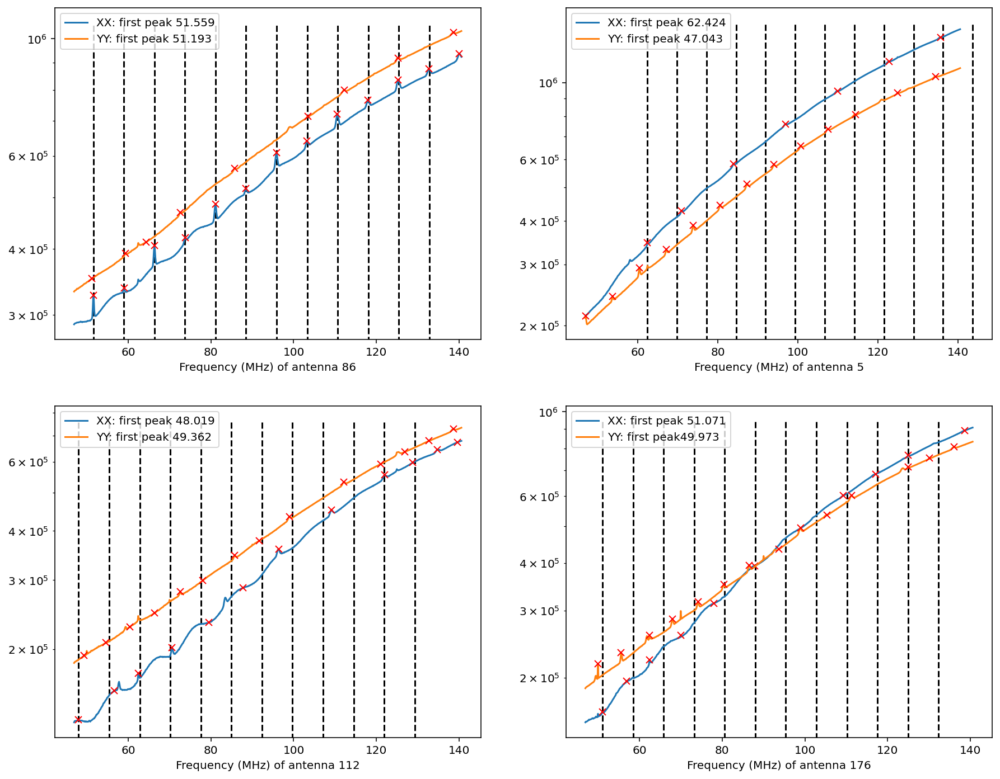

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [58]:
plot_four_noclocks_even(86, 5, 112, 176, 7.386)#differnce found using ant 86 peaks 1 & 7 xx

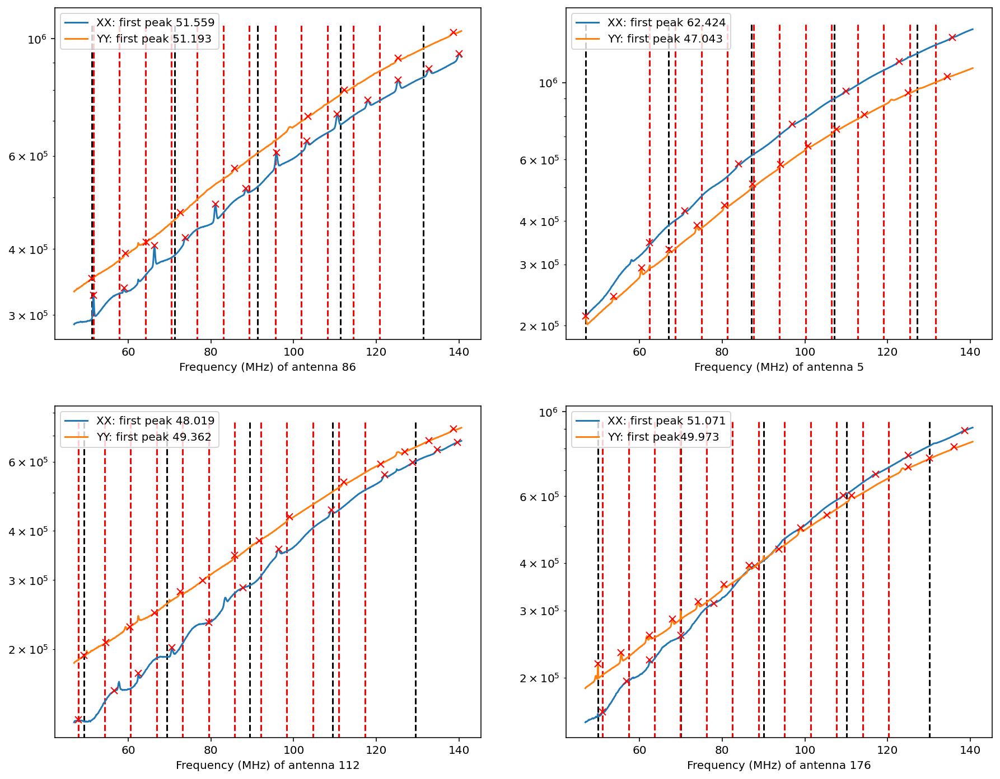

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [28]:
plot_both(86, 5, 112, 176, 20.025, 6.29) #plot in order of yy and then xx

[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]


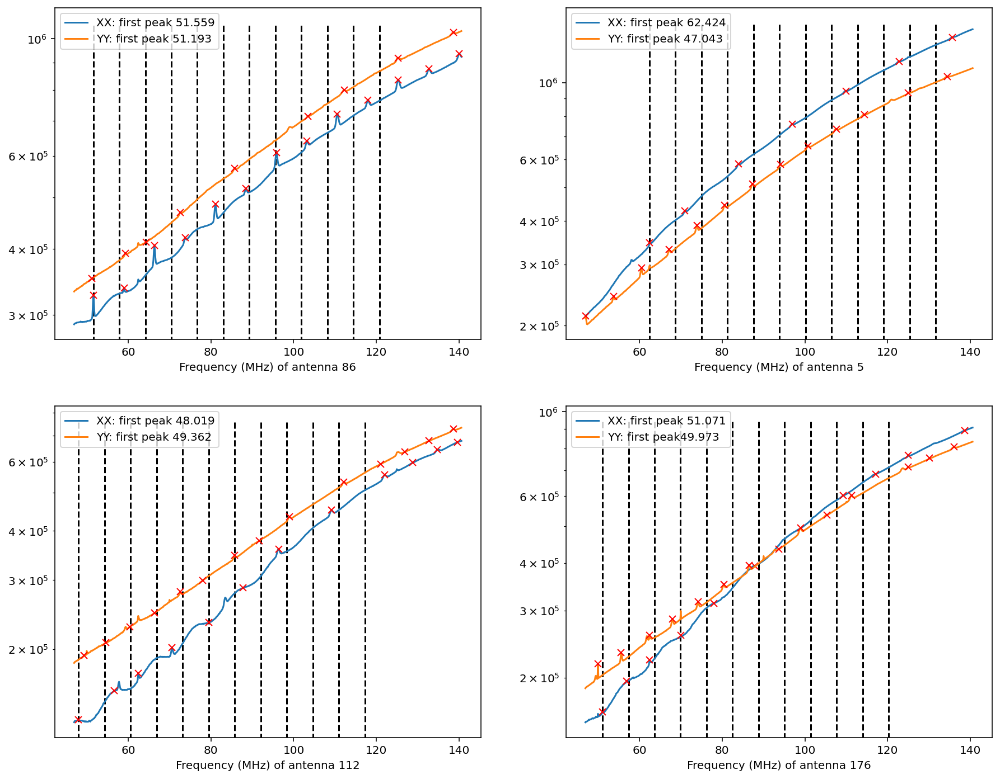

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [12]:
plot_four_noclocks_even(86,5,112,176,6.29)#xx using small peaks based off of ant 25

[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]


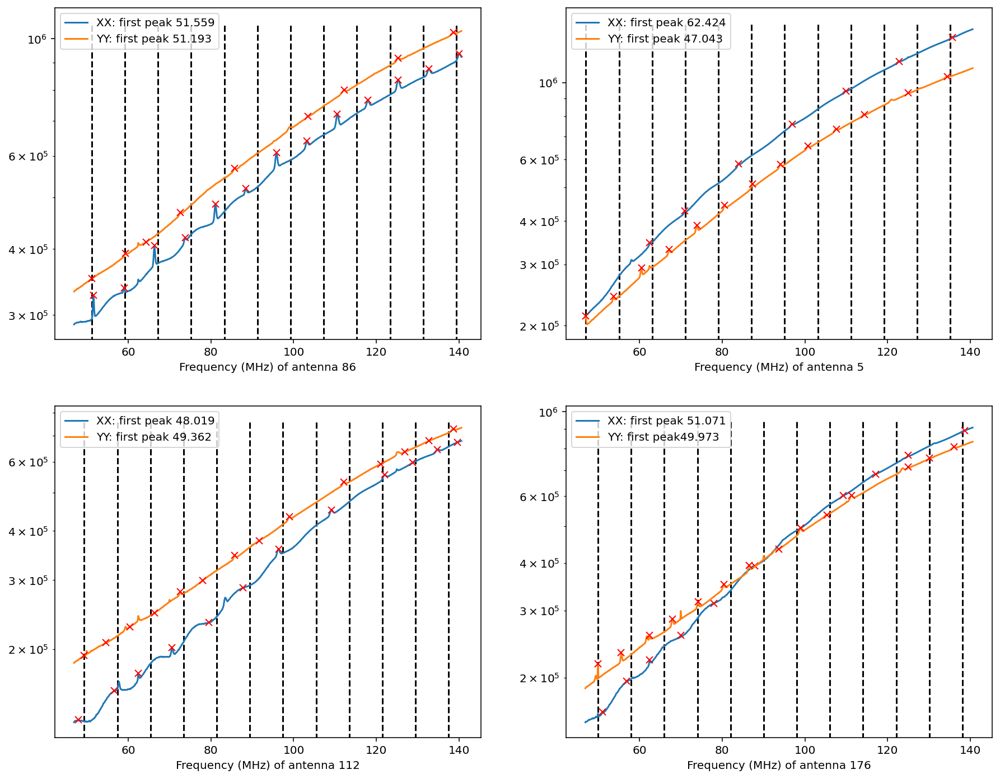

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [21]:
plot_four_noclocks_even_yy(86,5,112,176,8.01)#yy using big peaks based off of ant 25

[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]


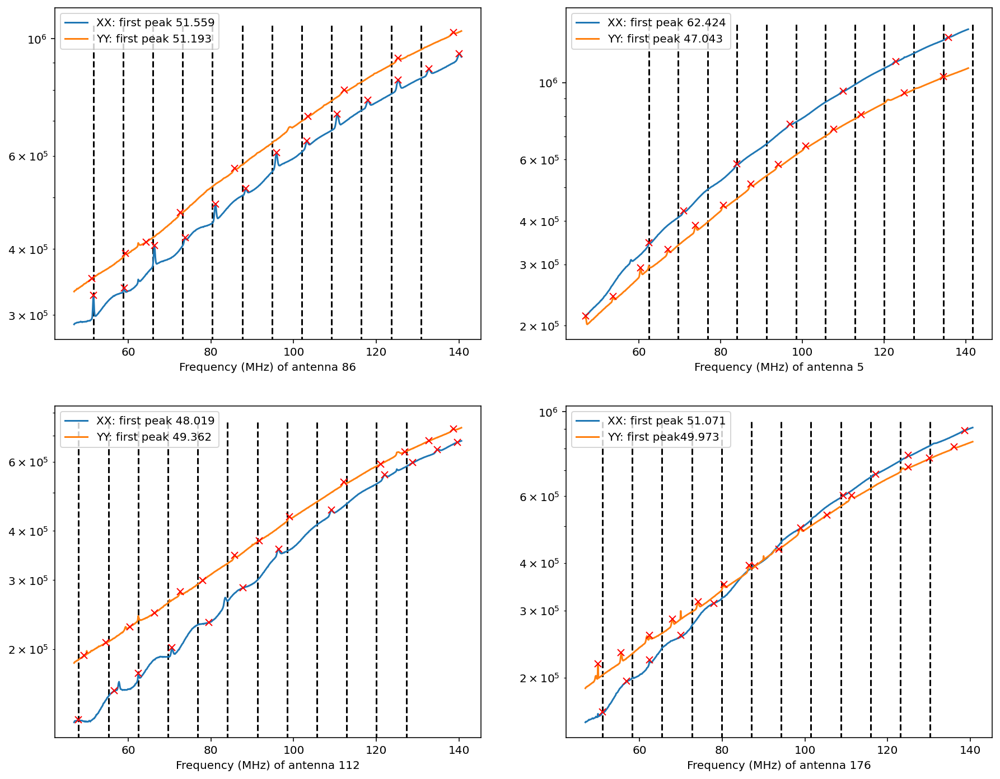

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [81]:
plot_four_noclocks_even(86,5,112,176,7.2)

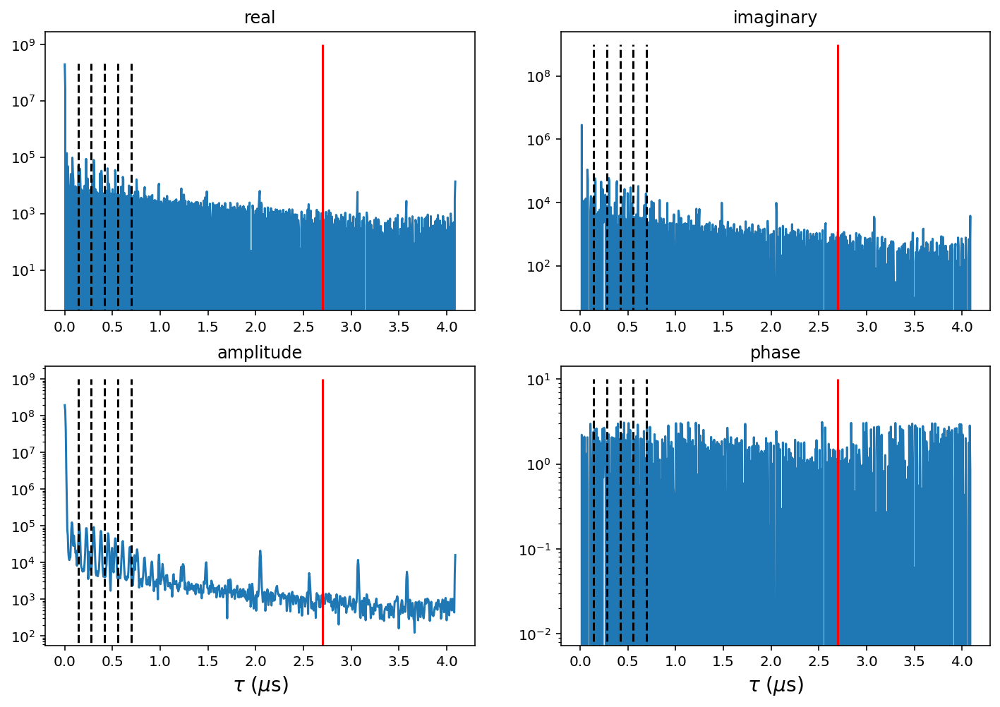

In [16]:
N = len(freq)
window = signal.blackmanharris(N)
wnorm = N / np.sum(window)
delay_data86yy, delay_array86yy = delay_transform(window*data86yy_avg, freq)
stop_ind = int(len(delay_data86yy) / 2)
plot_delay_spectrum(wnorm*delay_data86yy, delay_array86yy, 7.2, plot_half=True, scale='log')
# plt.vlines(1/7.2, ymin = 0, ymax = 1, color = 'green', ls = '--')
# plt.vlines(2/7.2, ymin = 0, ymax = 1, color = 'green', ls = '--')
# plt.vlines(3/7.2, ymin = 0, ymax = 1, color = 'green', ls = '--')
# plt.vlines(4/7.2, ymin = 0, ymax = 1, color = 'green', ls = '--')
# plt.vlines(5/7.2, ymin = 0, ymax = 1, color = 'green', ls = '--')

# delay_data86yy, delay_array86yy = delay_transform(data86yy[187,:], freq)
# stop_ind = int(len(delay_data86yy) / 2)
# plot_delay_spectrum(delay_data86yy, delay_array86yy, plot_half=True, scale='log')

In [ ]:
hf_delay_data86yy, hf_delay_array86yy = hyperfine_delay_transform(data86yy_avg, freq, 11, 200)
plot_delay_spectrum(hf_delay_data86yy, hf_delay_array86yy)

62.5457763671875 125.0457763671875 187.5457763671875
62.5457763671875 125.0457763671875 187.5457763671875


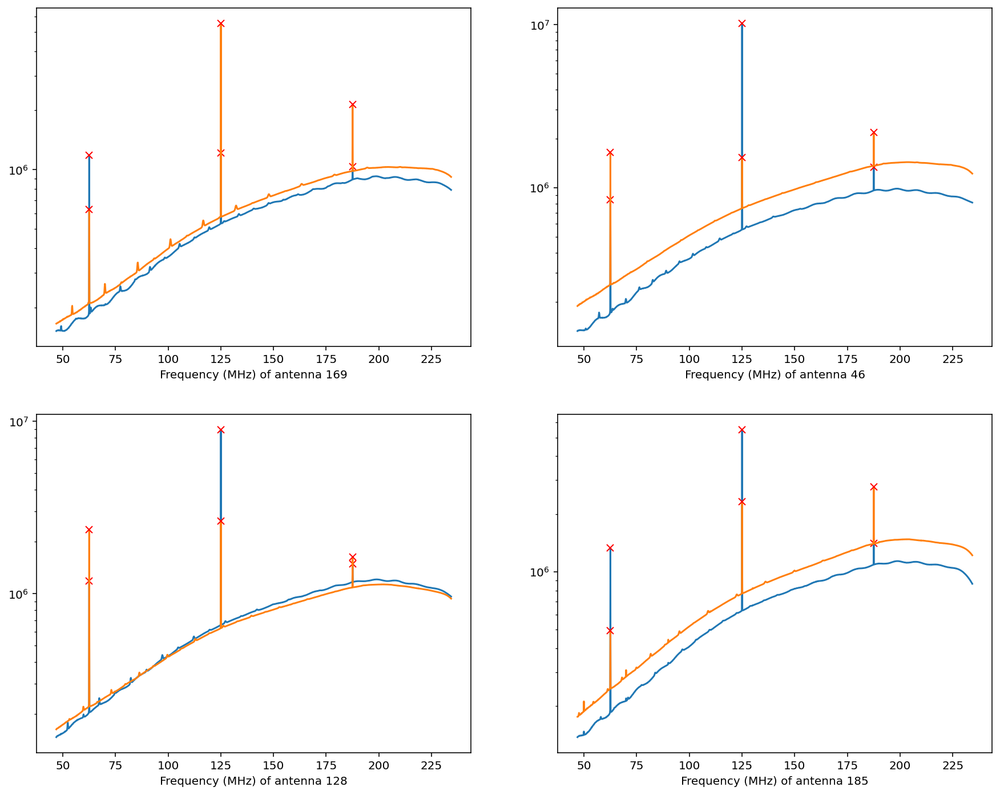

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [37]:
plot_four_clocks(169,46,128,185)

Antenna169 xx and yy
[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]
Antenna46 xx and yy
[ 50.82702637  57.17468262  63.64440918  69.86999512  76.33972168
  82.68737793  89.03503418  95.38269043 101.73034668 108.07800293
 114.42565918]
[ 51.07116699  56.56433105  64.13269043  72.18933105  80.24597168
  96.23718262 112.22839355 128.21960449]
Antenna128 xx and yy
[ 50.94909668  56.93054199  62.42370605  67.30651855  74.87487793
  82.32116699  89.76745605  97.21374512 104.78210449 112.22839355
 119.79675293]
[ 48.14147949  54.85534668  59.73815918  66.57409668  73.04382324
  79.75769043  86.3494873   93.67370605  99.65515137 106.36901855
 112.96081543]
Antenna185 xx and yy
[ 49.97253418  57.0526123   62.42370605  70.96862793  77.43835449
  83.90808

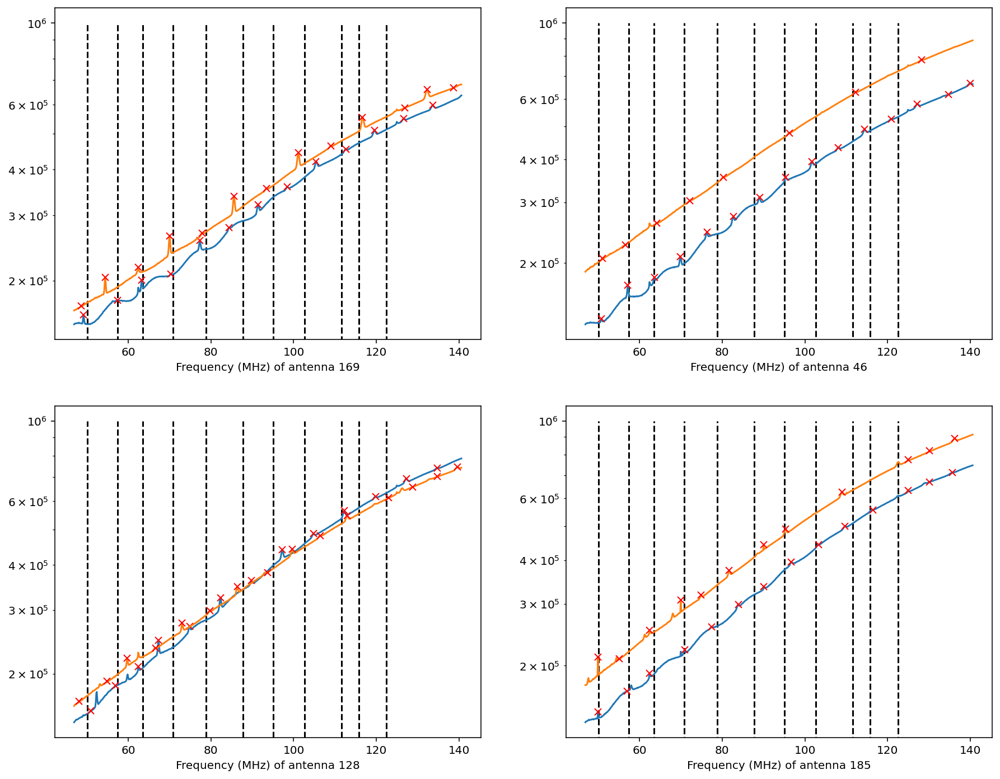

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [30]:
plot_four_noclocks(169,46,128,185)

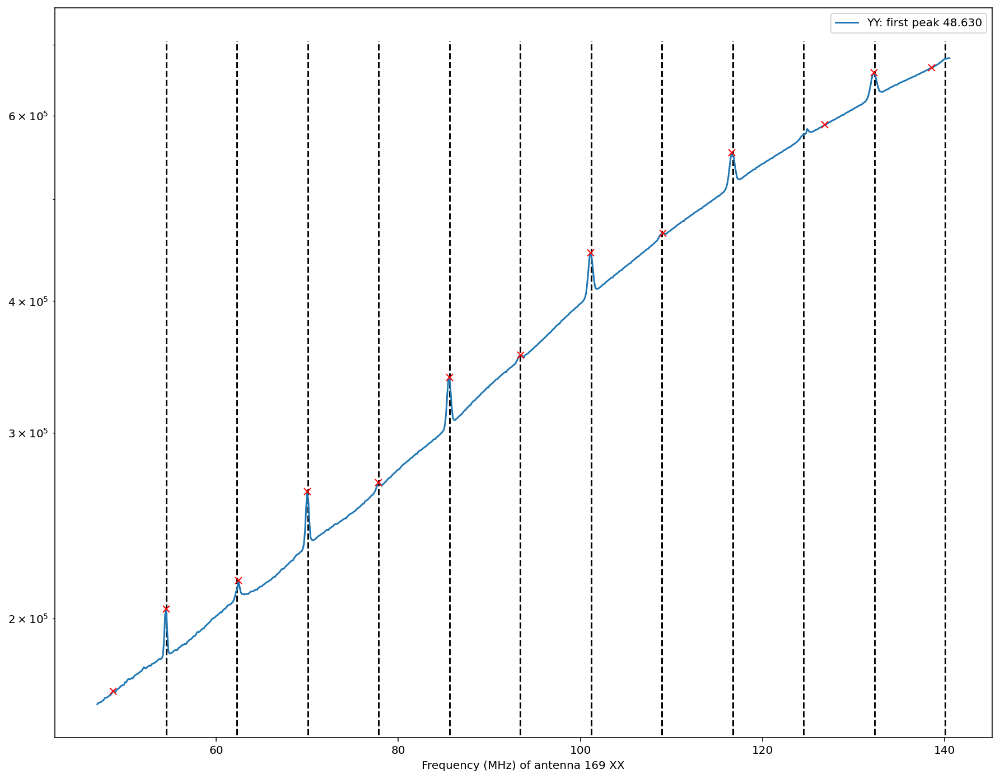

In [47]:
lines = np.arange(0,12,1)
custom_single_plot(169, 7.782, 54.489, lines, 'yy') #found using 2 and 6 peaks in the yy

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


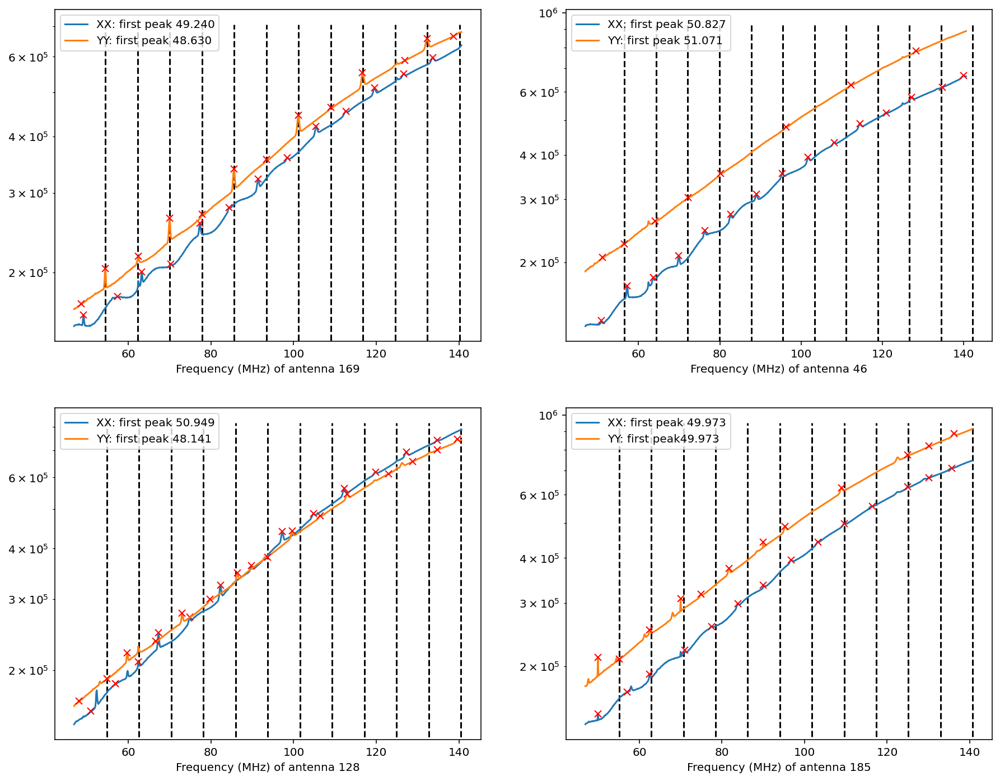

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [57]:
plot_four_noclocks_even_yy(169, 46, 128, 185, 7.782) #differnece found using ant 169 in the yy

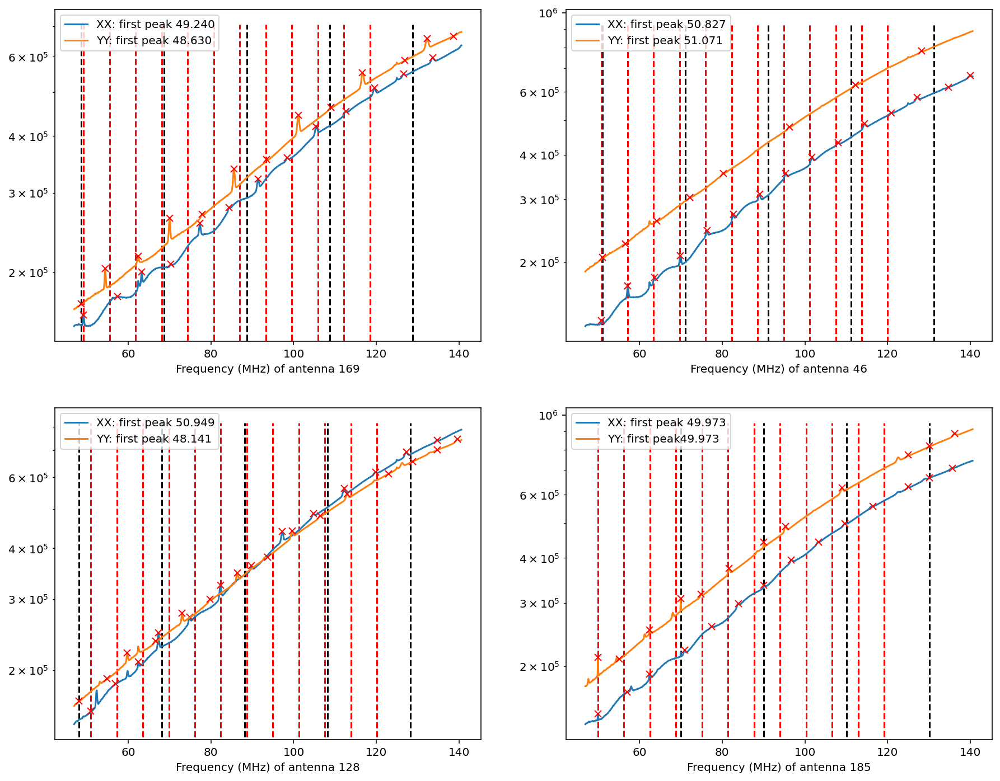

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [29]:
plot_both(169, 46, 128, 185, 20.025, 6.29) #plot in order of yy and then xx

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


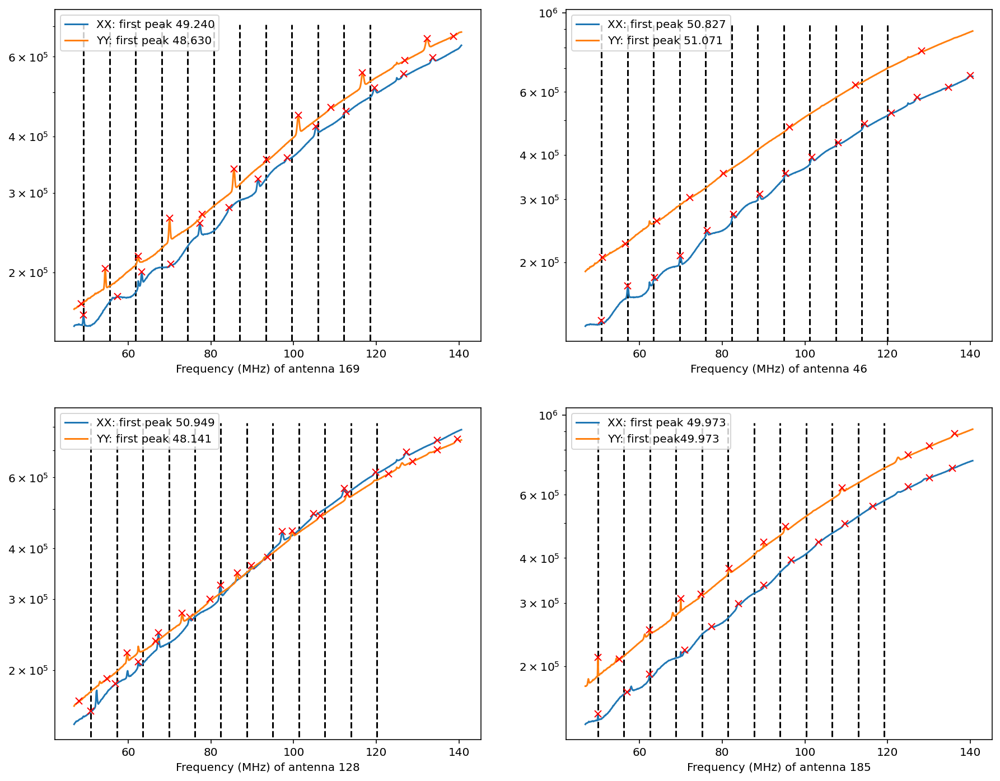

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [13]:
plot_four_noclocks_even(169,46,128,185,6.29)#xx using small peaks based off of ant 25

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


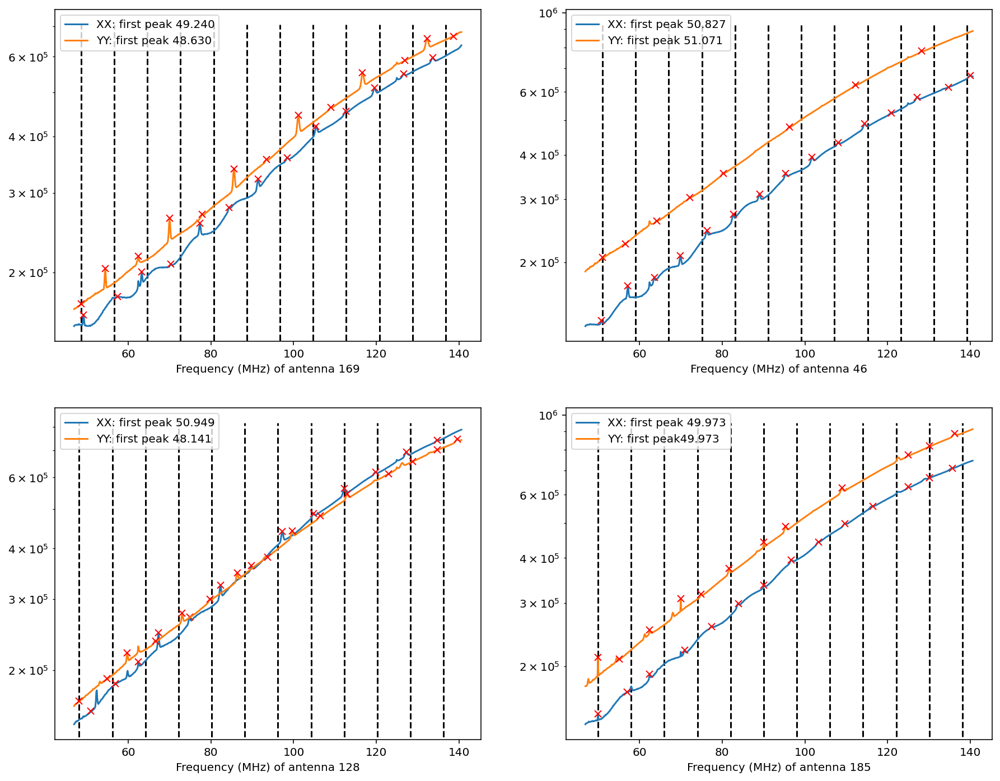

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [22]:
plot_four_noclocks_even_yy(169,46,128,185,8.01)#yy using big peaks based off of ant 25

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


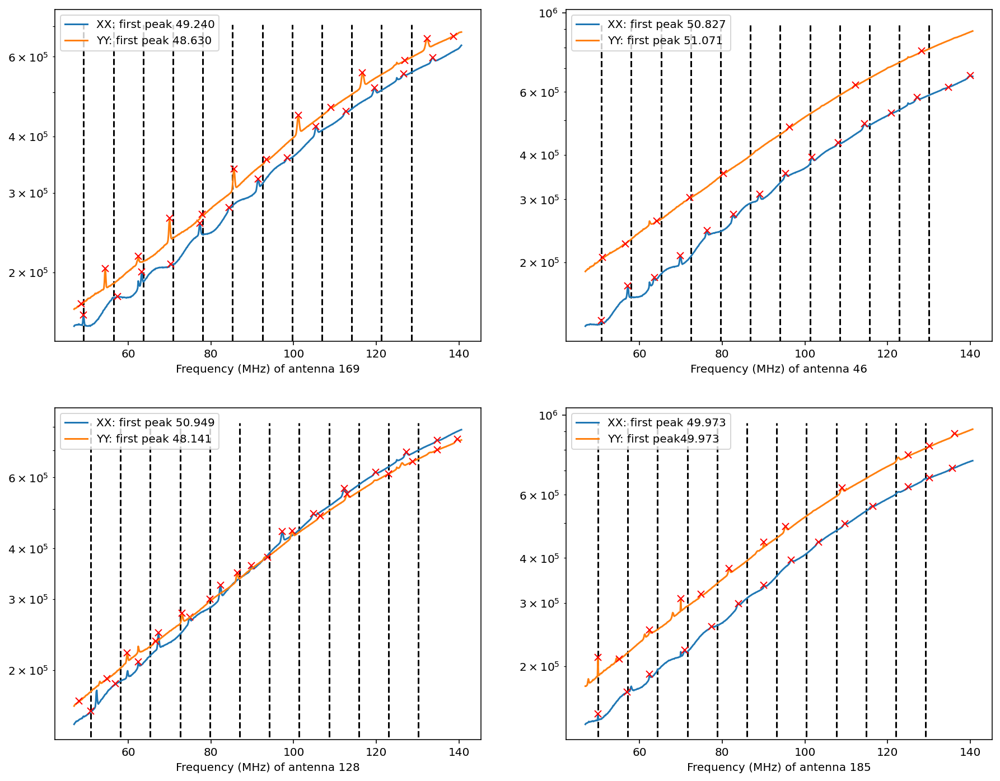

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [24]:
plot_four_noclocks_even(169,46,128,185,7.2)

In [ ]:
N = len(freq)
window = signal.blackmanharris(N)
wnorm = N / np.sum(window)
delay_data169yy, delay_array169yy = delay_transform(window*data169yy_avg, freq)
stop_ind = int(len(delay_data169yy) / 2)
plot_delay_spectrum(wnorm*delay_data169yy, delay_array169yy, 7.2, plot_half=True, scale='log')

# delay_data169yy, delay_array169yy = delay_transform(data169yy[187,:], freq)
# stop_ind = int(len(delay_data169yy) / 2)
# plot_delay_spectrum(delay_data169yy, delay_array169yy, plot_half=True, scale='log')

In [ ]:
hf_delay_data169yy, hf_delay_array169yy = hyperfine_delay_transform(data169yy_avg, freq, 11, 200)
plot_delay_spectrum(hf_delay_data169yy, hf_delay_array169yy)

62.5457763671875 125.0457763671875 187.5457763671875
62.5457763671875 125.0457763671875 187.5457763671875


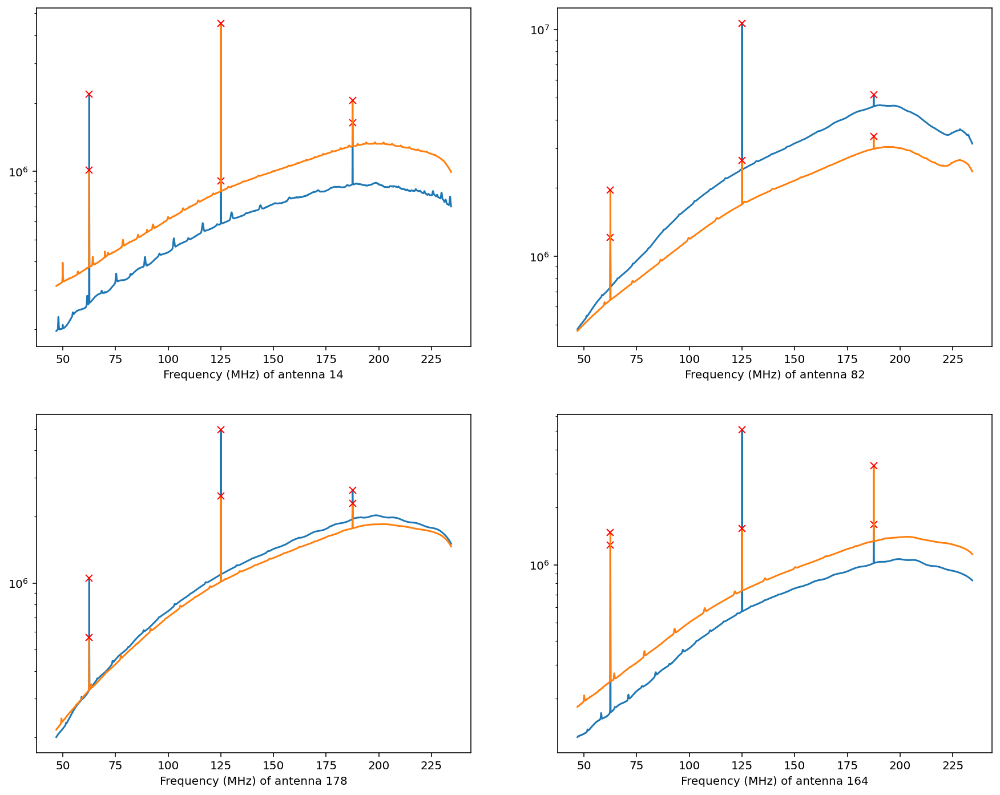

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [40]:
plot_four_clocks(14,82,178,164)

Antenna14 xx and yy
[ 47.89733887  56.56433105  61.56921387  68.52722168  75.36315918
  82.19909668  89.03503418  95.87097168 102.70690918 109.66491699
 116.37878418]
[ 49.97253418  57.17468262  64.25476074  69.99206543  78.5369873
  85.73913574  92.81921387 102.21862793 110.27526855 118.5760498
 124.92370605]
Antenna82 xx and yy
[ 51.31530762  58.63952637  66.08581543  73.28796387  88.05847168
 102.70690918 110.03112793 117.35534668 124.92370605 132.00378418]
[ 62.42370605  73.16589355  86.47155762 101.48620605 113.08288574
 126.3885498  139.69421387]
Antenna178 xx and yy
[ 51.55944824  58.88366699  66.32995605  73.6541748   81.10046387
  88.42468262 103.19519043 117.96569824 125.4119873  132.61413574]
[ 49.36218262  56.44226074  63.52233887  70.60241699  77.5604248
  84.88464355  91.72058105  98.92272949 105.8807373  113.20495605
 119.91882324]
Antenna164 xx and yy
[ 51.68151855  58.15124512  64.62097168  71.09069824  77.5604248
  84.03015137  90.62194824  96.96960449 105.39245605 11

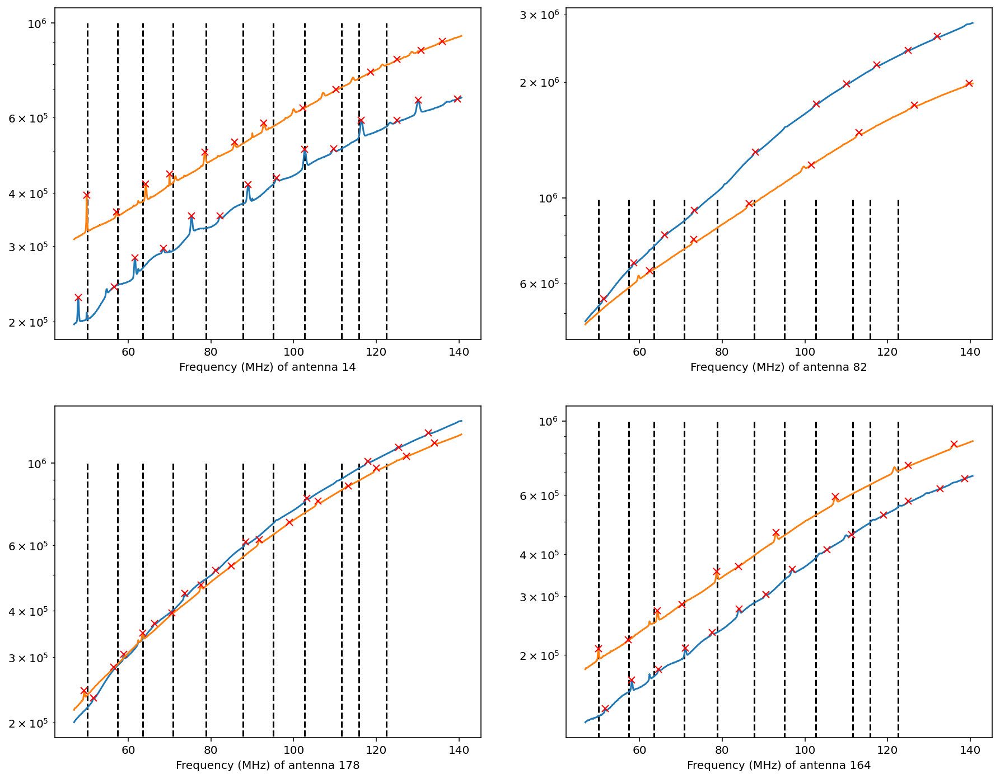

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [48]:
plot_four_noclocks(14,82,178,164)

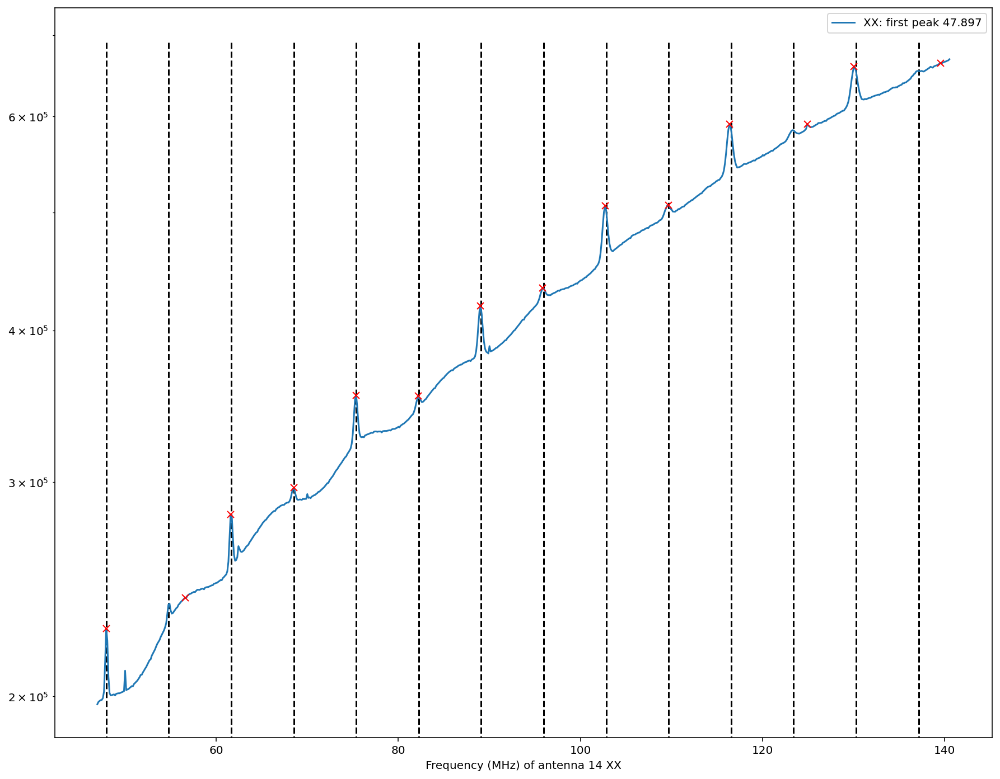

In [51]:
lines = np.arange(0,14,1)
custom_single_plot(14, 6.867, 47.897, lines, 'xx')

[ 47.89733887  56.56433105  61.56921387  68.52722168  75.36315918
  82.19909668  89.03503418  95.87097168 102.70690918 109.66491699
 116.37878418]
[ 49.97253418  57.17468262  64.25476074  69.99206543  78.5369873
  85.73913574  92.81921387 102.21862793 110.27526855 118.5760498
 124.92370605]


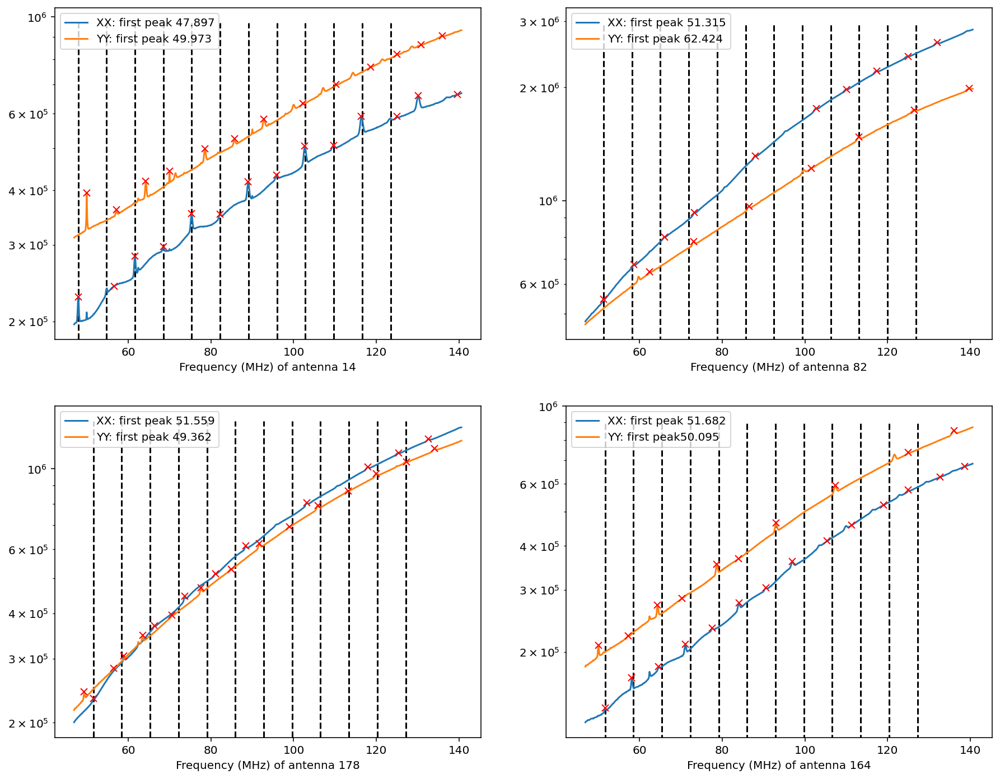

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [52]:
plot_four_noclocks_even(14,82,178,164, 6.867)#xx using difference found on ant 14

[ 47.89733887  56.56433105  61.56921387  68.52722168  75.36315918
  82.19909668  89.03503418  95.87097168 102.70690918 109.66491699
 116.37878418]
[ 49.97253418  57.17468262  64.25476074  69.99206543  78.5369873
  85.73913574  92.81921387 102.21862793 110.27526855 118.5760498
 124.92370605]


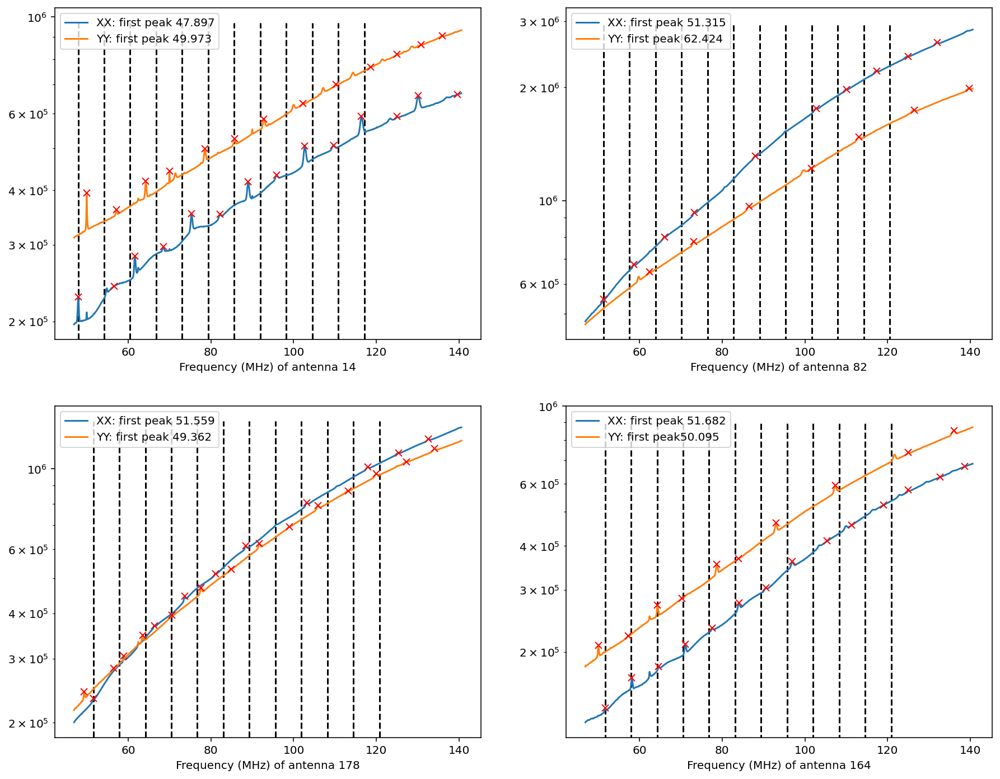

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [16]:
plot_four_noclocks_even(14,82,178,164, 6.29)#xx using small peaks based off of ant 25

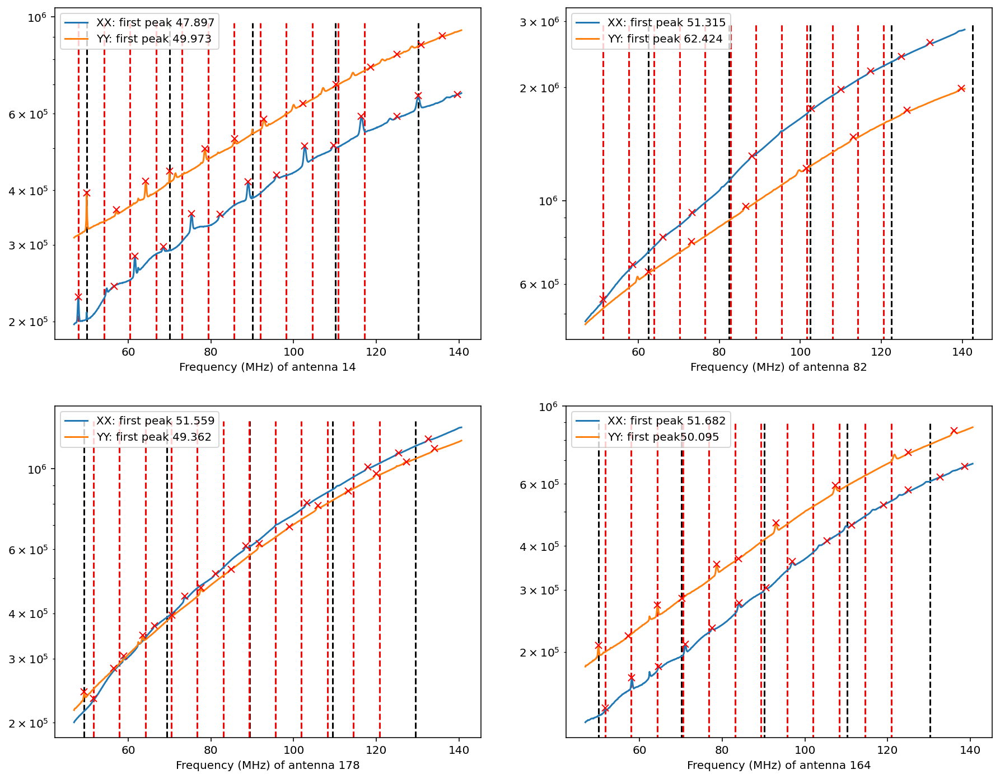

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [31]:
plot_both(14, 82, 178, 164, 20.025, 6.29) #plot in order of yy and then xx

[ 47.89733887  56.56433105  61.56921387  68.52722168  75.36315918
  82.19909668  89.03503418  95.87097168 102.70690918 109.66491699
 116.37878418]
[ 49.97253418  57.17468262  64.25476074  69.99206543  78.5369873
  85.73913574  92.81921387 102.21862793 110.27526855 118.5760498
 124.92370605]


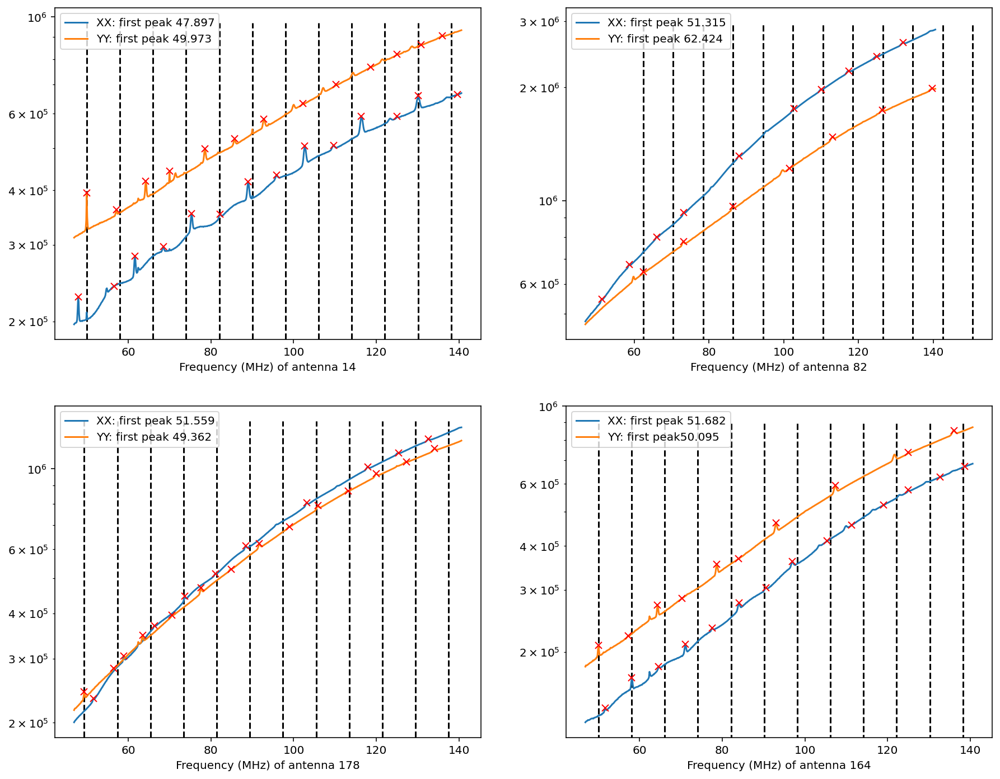

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [23]:
plot_four_noclocks_even_yy(14,82,178,164, 8.01)#yy using big peaks based off of ant 25

In [ ]:
plot_four_noclocks_even(14,82,178,164, 7.2)

In [ ]:
N = len(freq)
window = signal.blackmanharris(N)
wnorm = N / np.sum(window)
delay_data14yy, delay_array14yy = delay_transform(window*data14yy_avg, freq)
stop_ind = int(len(delay_data14yy) / 2)
plot_delay_spectrum(wnorm*delay_data14yy[20:], delay_array14yy[20:], 7.2, plot_half=True, scale='log')

# delay_data99yy, delay_array99yy = delay_transform(data99yy[187,:], freq)
# stop_ind = int(len(delay_data99yy) / 2)
# plot_delay_spectrum(delay_data99yy, delay_array99yy, plot_half=True, scale='log')

In [ ]:
hf_delay_data14yy, hf_delay_array14yy = hyperfine_delay_transform(data14yy_avg, freq, 11, 200)
plot_delay_spectrum(hf_delay_data14yy, hf_delay_array14yy)

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


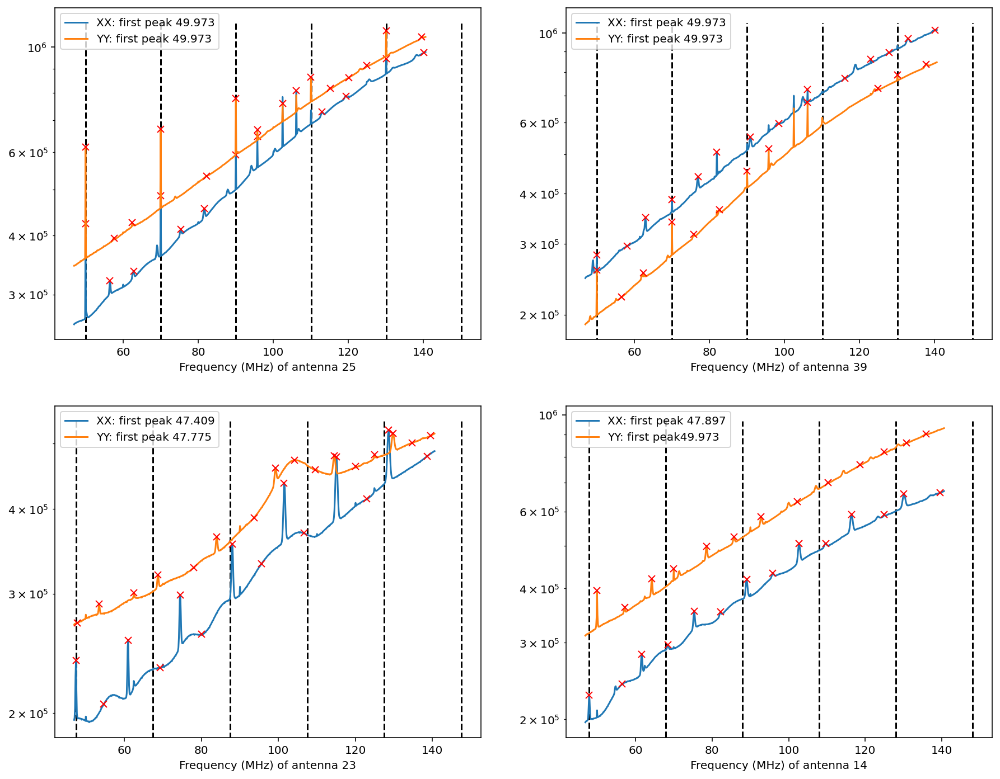

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [19]:
plot_four_noclocks_even(25, 39, 23, 14, 20.025, 6)

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


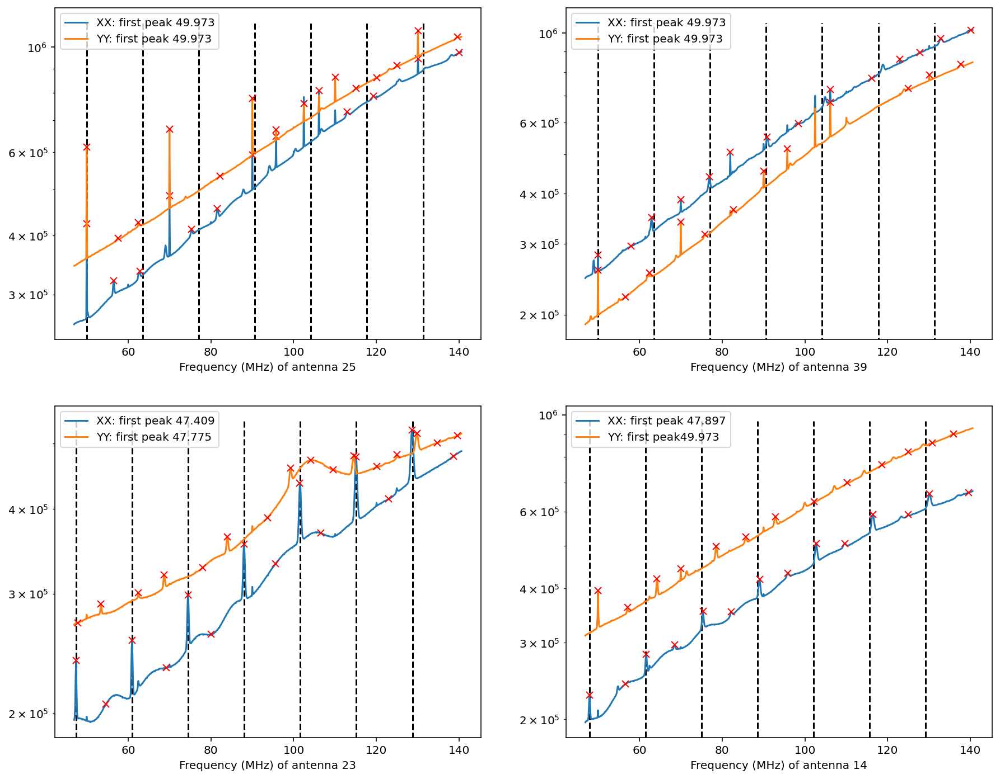

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [20]:
plot_four_noclocks_even(25, 39, 23, 14, 13.55, 7) #node 00

[ 48.75183105  53.63464355  62.42370605  69.99206543  74.87487793
  82.32116699  89.76745605  97.33581543 104.78210449 112.47253418
 119.79675293]
[ 49.97253418  60.47058105  65.59753418  74.14245605  80.12390137
  87.57019043  94.77233887 102.21862793 109.29870605 117.11120605
 123.94714355]


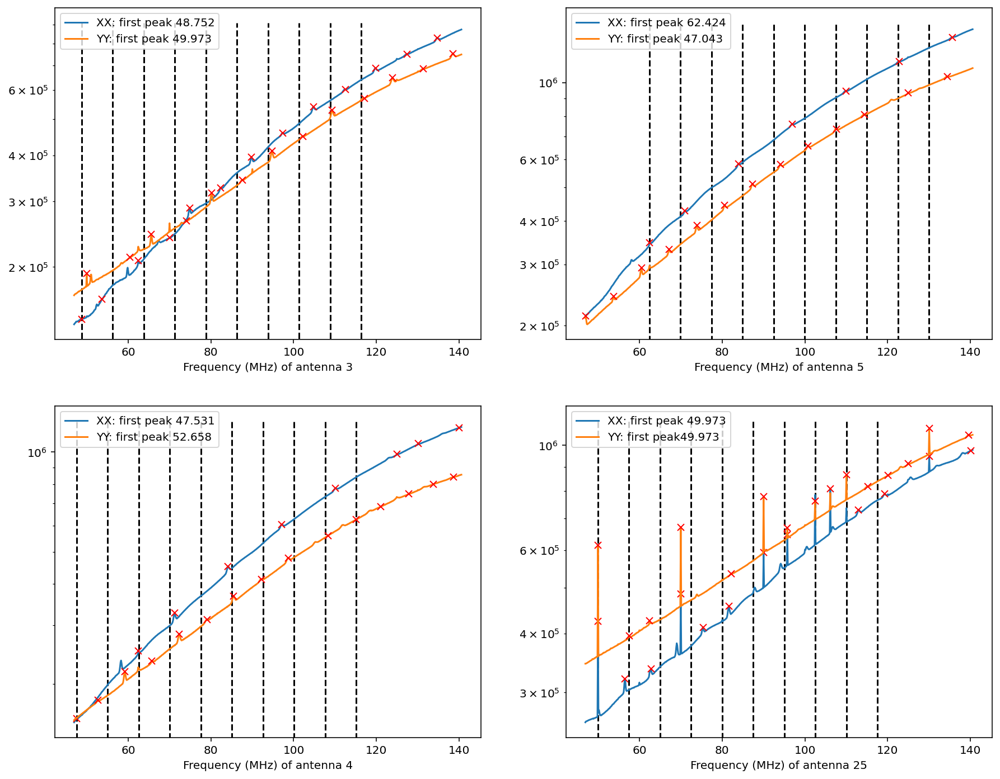

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [22]:
plot_four_noclocks_even(3, 5, 4, 25, 7.508, 10) #node 01. seperation found using 3. 4 added within node. 25 added.

[ 50.82702637  57.17468262  63.64440918  69.86999512  76.33972168
  82.68737793  89.03503418  95.38269043 101.73034668 108.07800293
 114.42565918]
[ 51.07116699  56.56433105  64.13269043  72.18933105  80.24597168
  96.23718262 112.22839355 128.21960449]


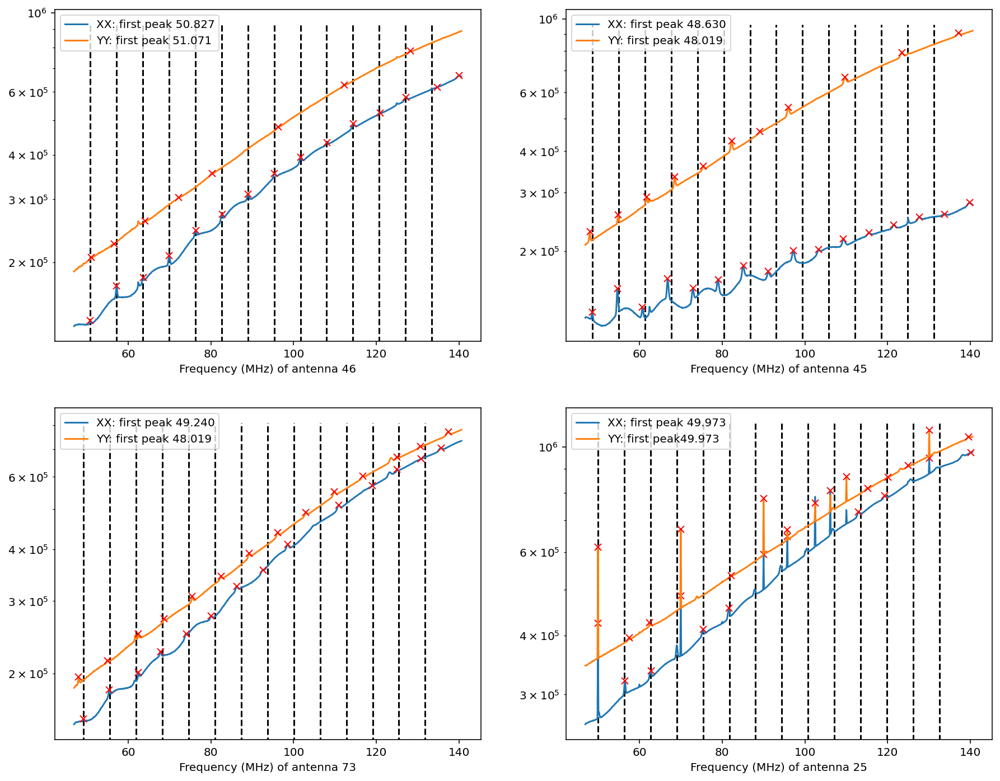

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [24]:
plot_four_noclocks_even(46, 45, 73, 25, 6.35, 14) #node 05 seperation found using 46. 45 & 73 added and within node. 25 added.

[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]


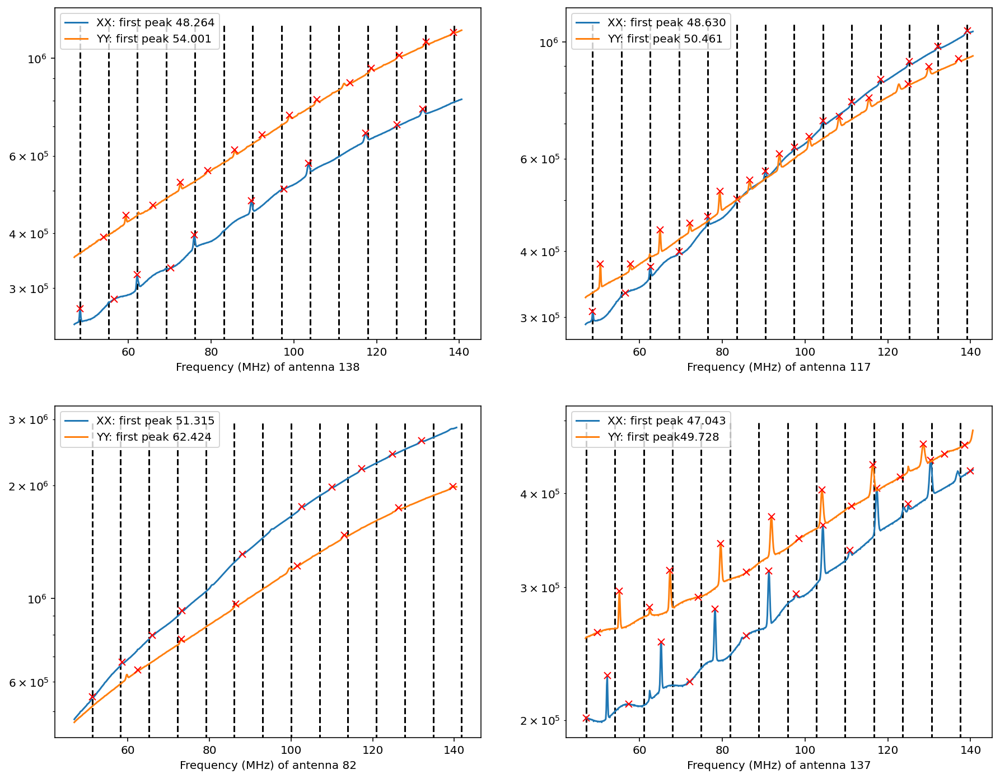

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [26]:
plot_four_noclocks_even(138, 117, 82, 137, 6.96, 14)#node 07. 137 added within node

[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]


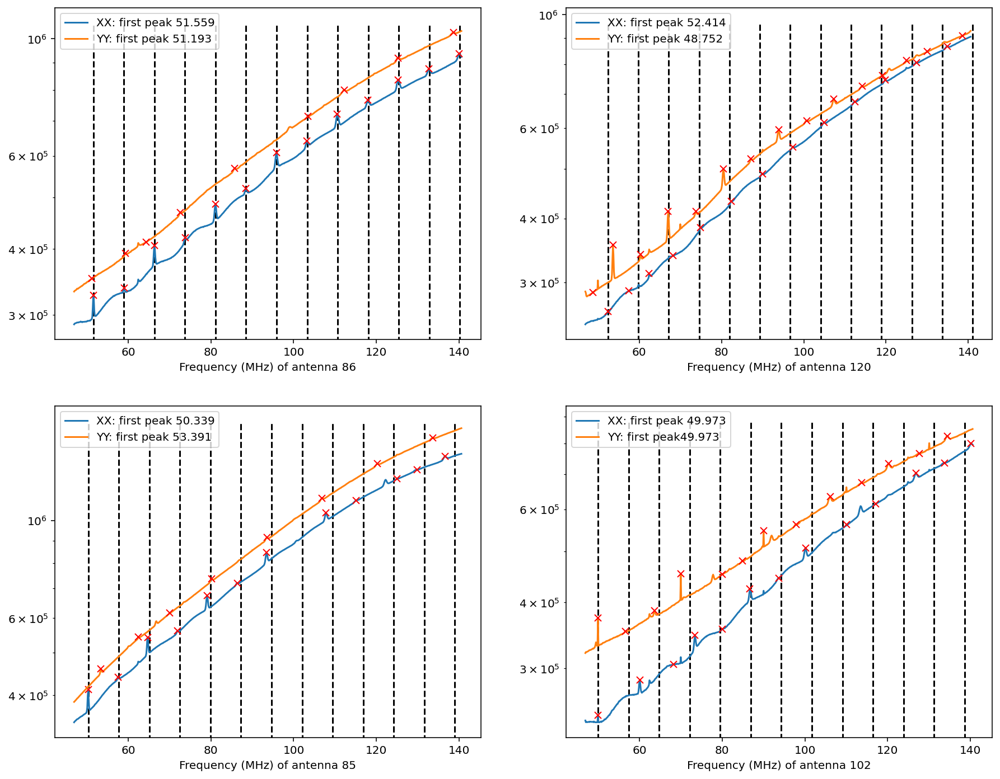

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [29]:
plot_four_noclocks_even(86, 120, 85, 102, 7.386, 13)#node 10. added 120, 85, 102 within node.

[ 48.01940918  56.56433105  62.42370605  70.60241699  79.5135498
  87.81433105  96.35925293 109.17663574 121.99401855 128.82995605
 134.68933105]
[ 49.36218262  54.61120605  60.47058105  66.32995605  72.55554199
  78.04870605  85.73913574  91.72058105  99.0447998  112.10632324
 121.01745605]


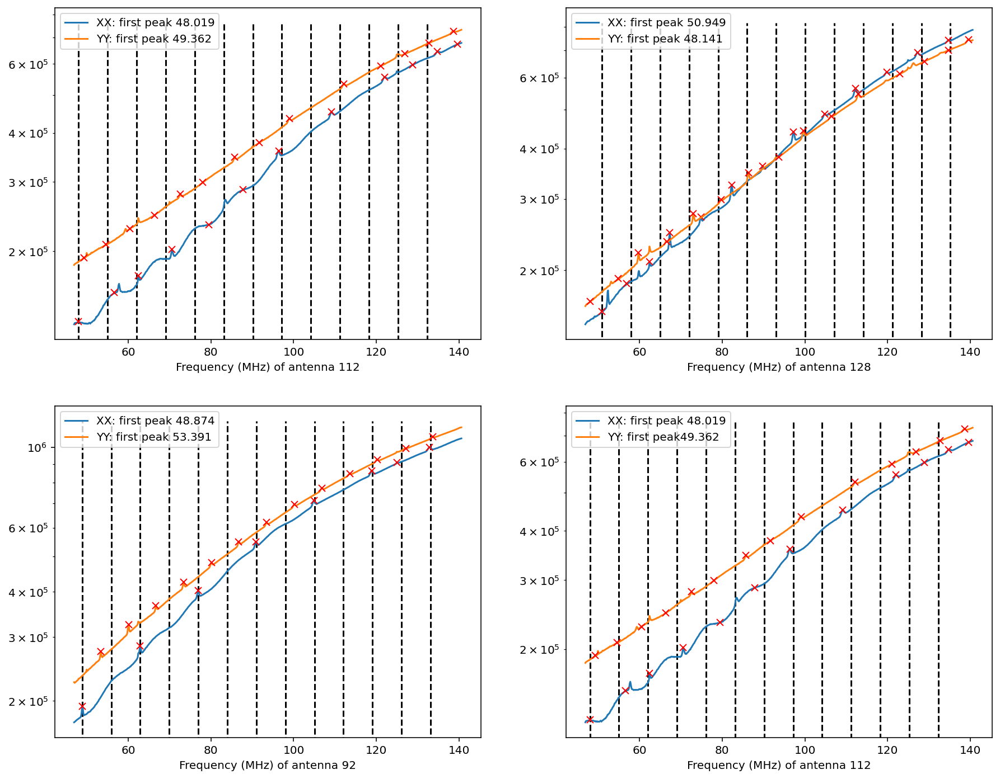

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [31]:
plot_four_noclocks_even(112, 128, 92, 112, 7.019, 13)

[ 51.07116699  56.93054199  62.42370605  69.99206543  78.04870605
  87.81433105 109.29870605 117.11120605 124.92370605 138.59558105]
[ 49.97253418  55.58776855  62.42370605  68.03894043  74.14245605
  80.36804199  86.47155762  93.67370605  98.92272949 105.39245605
 111.25183105]


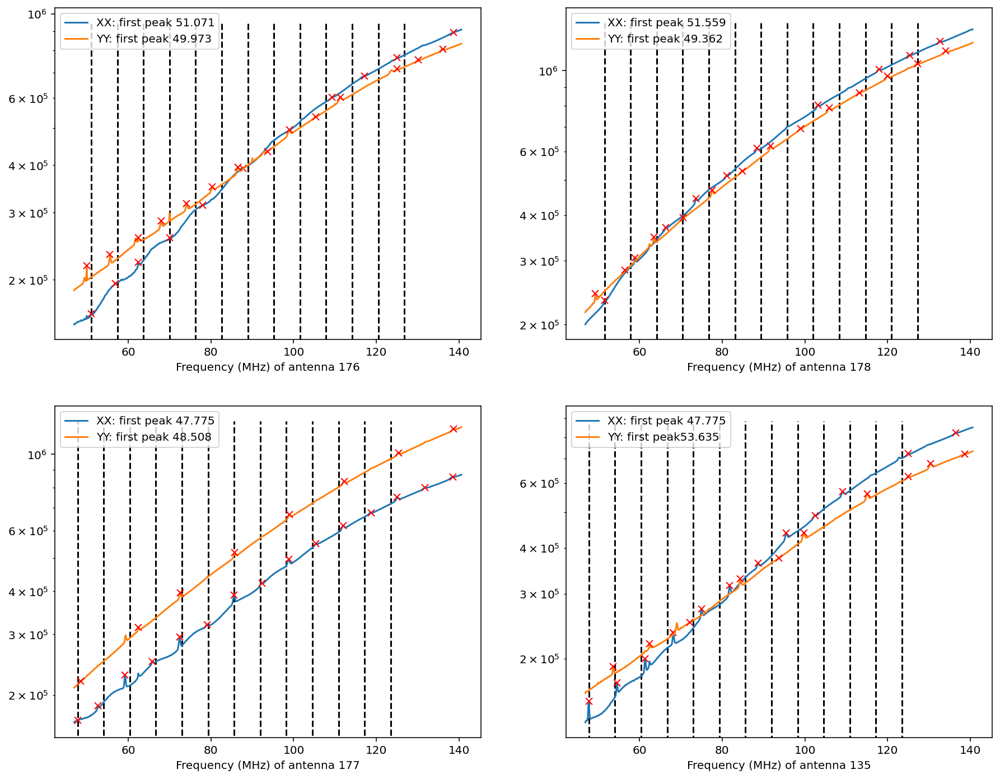

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [33]:
plot_four_noclocks_even(176, 178, 177, 135, 6.307, 13)#node 12. 177 & 135 added within node

[ 47.04284668  52.29187012  59.73815918  67.18444824  74.75280762
  82.19909668  89.64538574  97.0916748  104.53796387 111.98425293
 119.43054199]
[ 51.1932373   58.51745605  65.8416748   73.16589355  80.4901123
  87.81433105  95.26062012 102.46276855 115.15808105 121.01745605
 128.82995605]


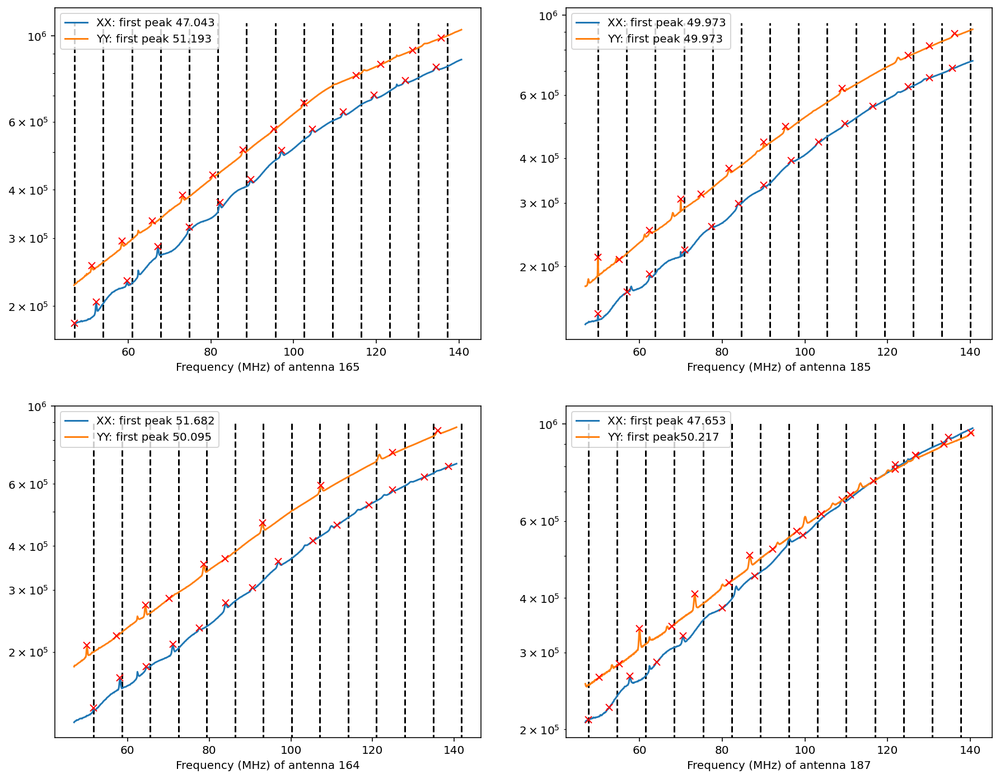

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [39]:
plot_four_noclocks_even(165, 185, 164, 187, 6.928, 14)#node 14. 187 added within node.

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


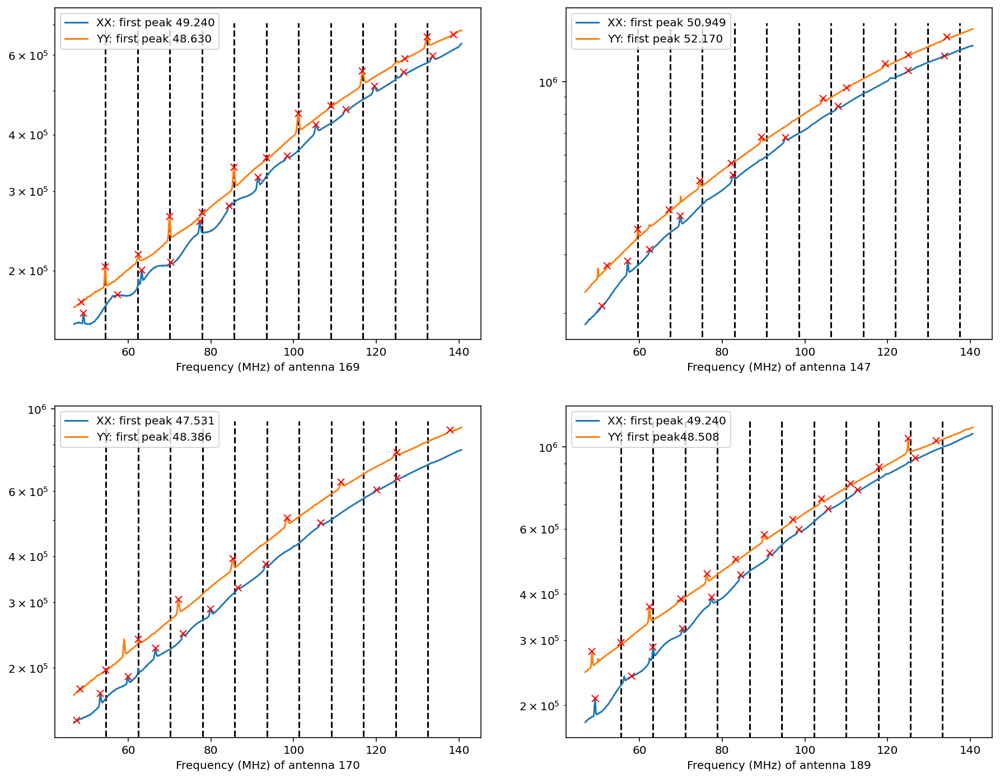

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [51]:
plot_four_noclocks_even_yy(169, 147, 170, 189, 7.782, 11) #node 15 170 & 189 added within node

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


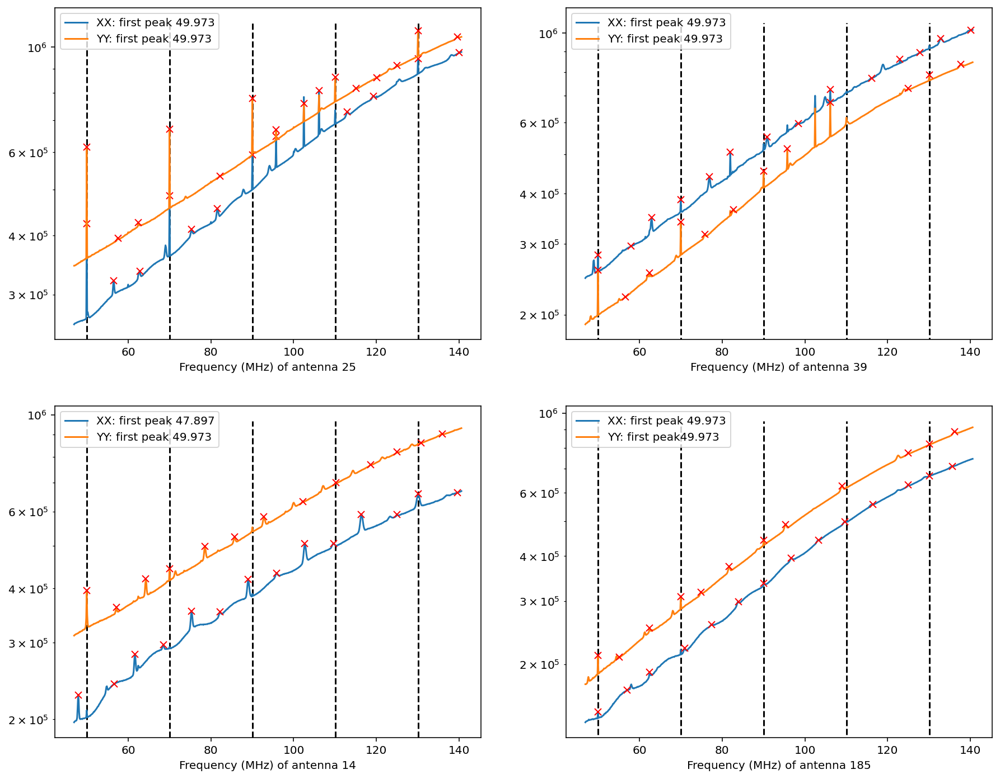

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [22]:
plot_four_noclocks_even(25, 39, 14, 185, 49.973, 20.025, 5)

[ 49.2401123   58.15124512  63.27819824  70.35827637  77.43835449
  84.51843262  91.47644043  98.55651855 105.63659668 112.7166748
 126.75476074]
[ 48.50769043  55.46569824  62.42370605  69.99206543  76.33972168
  83.29772949  90.13366699  97.0916748  104.04968262 111.00769043
 117.96569824]


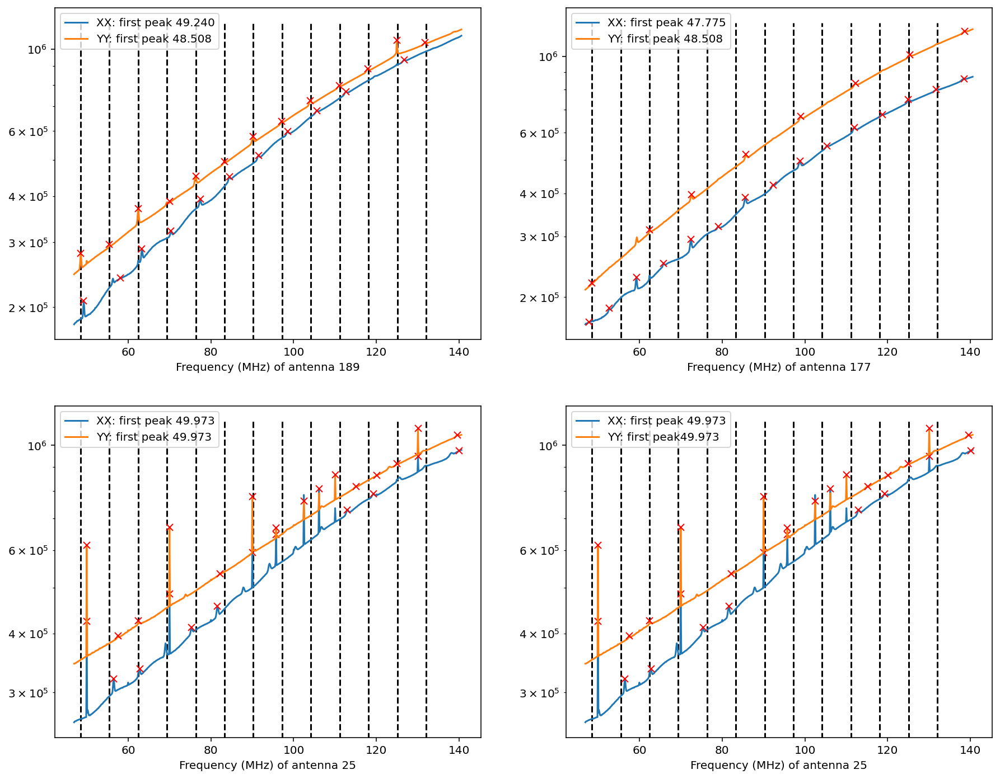

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [24]:
plot_four_noclocks_even_yy(189,177,25,25, 48.508, 6.958, 13)

[ 49.2401123   58.15124512  63.27819824  70.35827637  77.43835449
  84.51843262  91.47644043  98.55651855 105.63659668 112.7166748
 126.75476074]
[ 48.50769043  55.46569824  62.42370605  69.99206543  76.33972168
  83.29772949  90.13366699  97.0916748  104.04968262 111.00769043
 117.96569824]


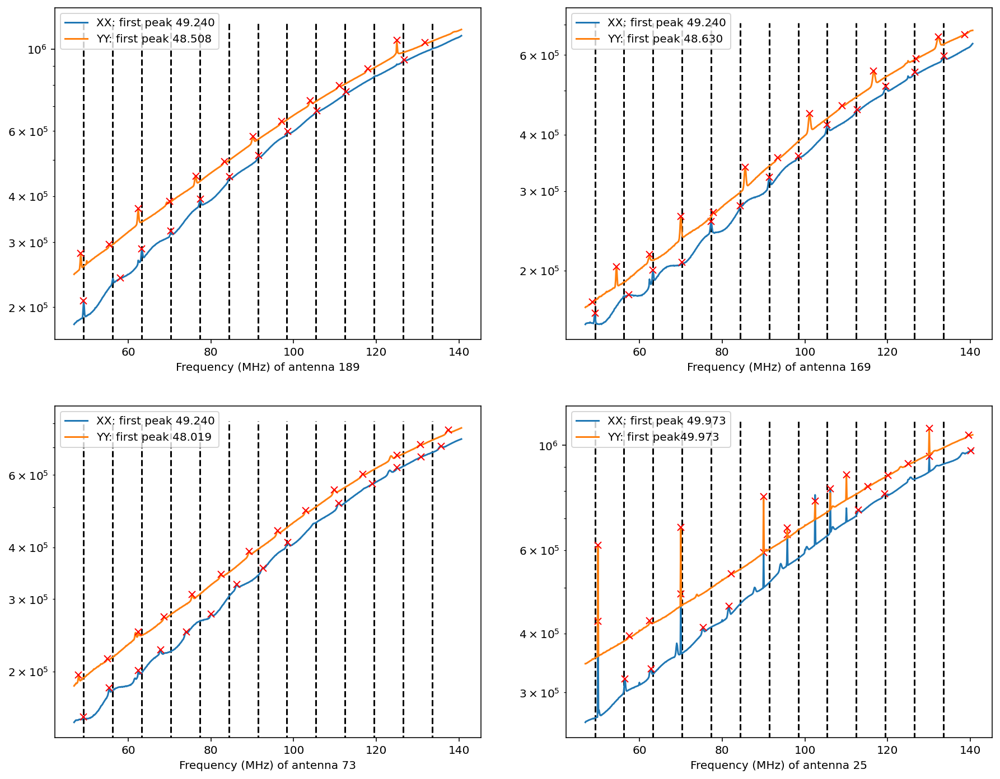

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [27]:
plot_four_noclocks_even(189,169,73, 25, 49.240, 7.019, 13)

[ 47.53112793  53.26843262  59.9822998   66.57409668  73.28796387
  79.87976074  86.59362793  93.30749512 106.61315918 120.04089355
 124.92370605]
[ 48.38562012  54.61120605  62.42370605  72.18933105  85.25085449
  98.43444824 111.49597168 124.92370605 137.86315918]


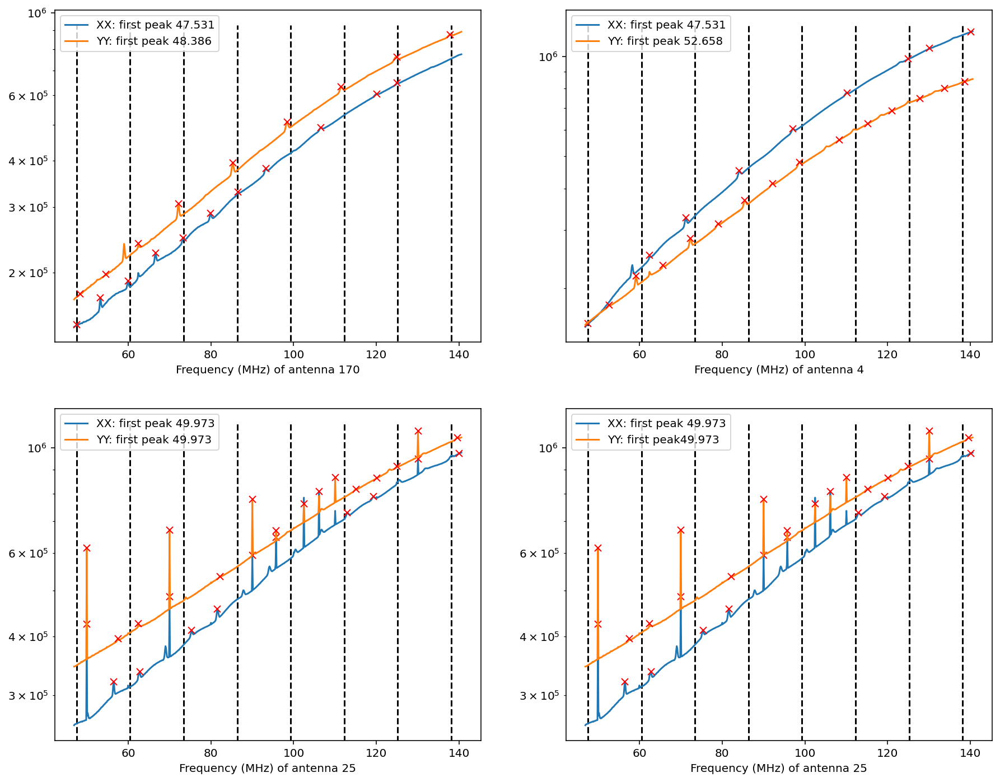

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [33]:
plot_four_noclocks_even(170, 4, 25, 25, 47.531, 12.940, 8)

[ 50.94909668  57.17468262  62.42370605  69.86999512  82.56530762
  95.38269043 108.07800293 124.92370605 133.71276855]
[ 52.1697998   59.61608887  67.18444824  74.6307373   82.19909668
  89.52331543 104.41589355 110.03112793 119.43054199 124.92370605
 134.32312012]


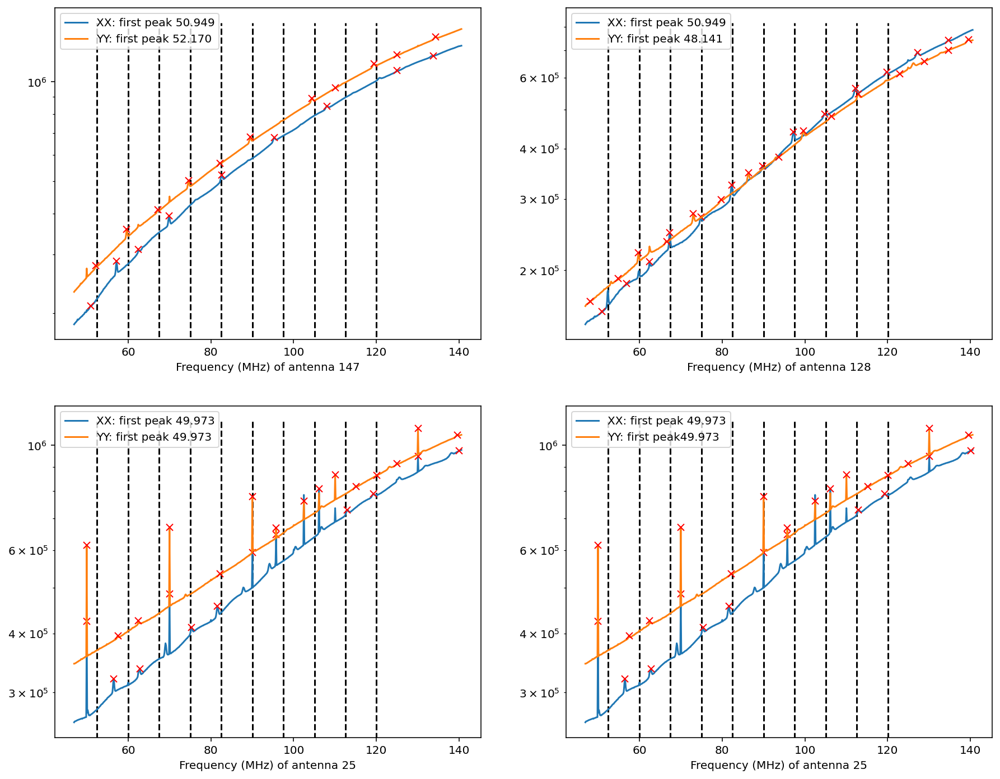

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [38]:
plot_four_noclocks_even(147, 128, 25, 25, 52.469, 7.507, 10)

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


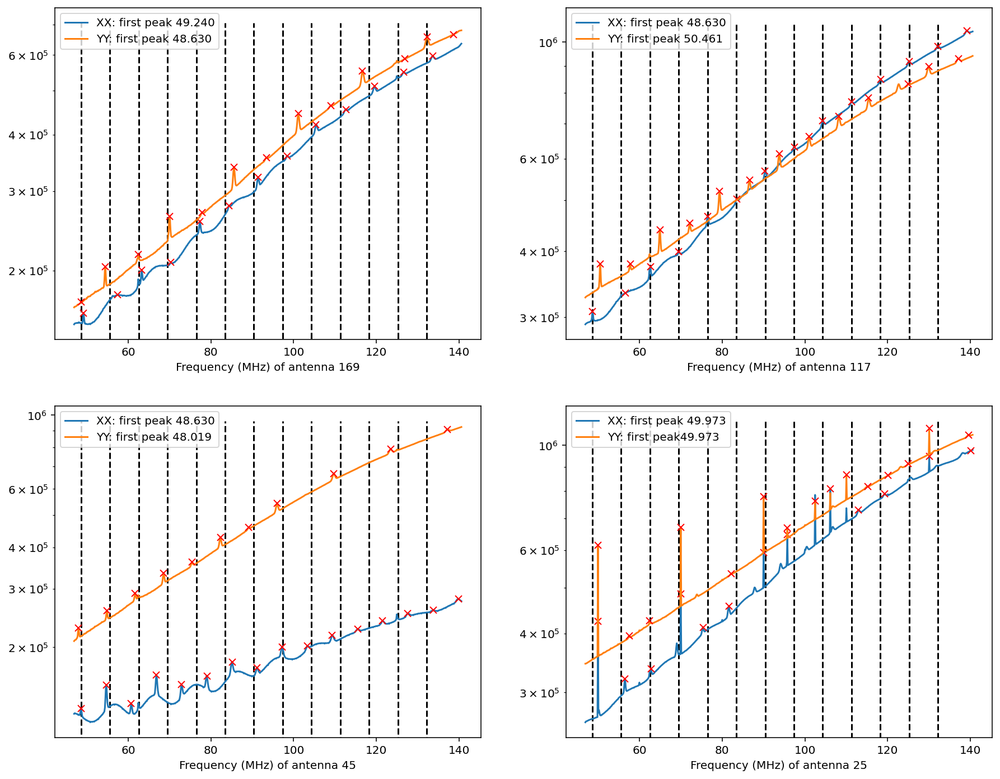

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [41]:
plot_four_noclocks_even(169, 117, 45, 25, 48.630, 6.96, 13)

[ 47.04284668  52.29187012  59.73815918  67.18444824  74.75280762
  82.19909668  89.64538574  97.0916748  104.53796387 111.98425293
 119.43054199]
[ 51.1932373   58.51745605  65.8416748   73.16589355  80.4901123
  87.81433105  95.26062012 102.46276855 115.15808105 121.01745605
 128.82995605]


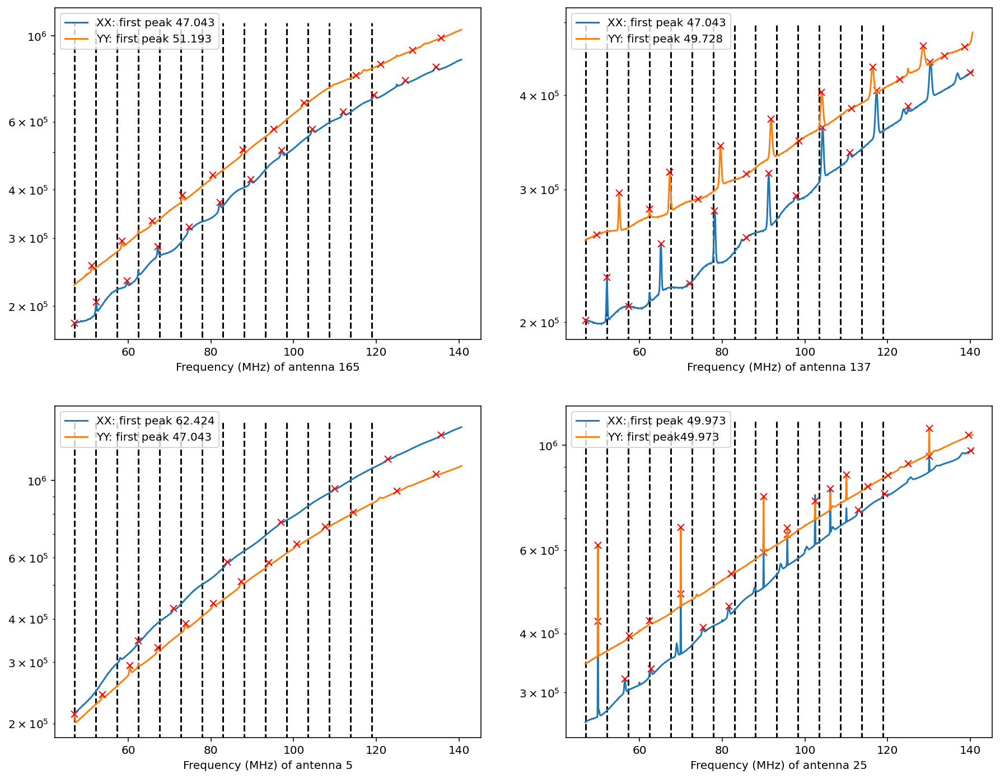

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [46]:
plot_four_noclocks_even(165, 137, 5, 25, 47.043, 5.128, 15)

[ 47.04284668  52.29187012  59.73815918  67.18444824  74.75280762
  82.19909668  89.64538574  97.0916748  104.53796387 111.98425293
 119.43054199]
[ 51.1932373   58.51745605  65.8416748   73.16589355  80.4901123
  87.81433105  95.26062012 102.46276855 115.15808105 121.01745605
 128.82995605]


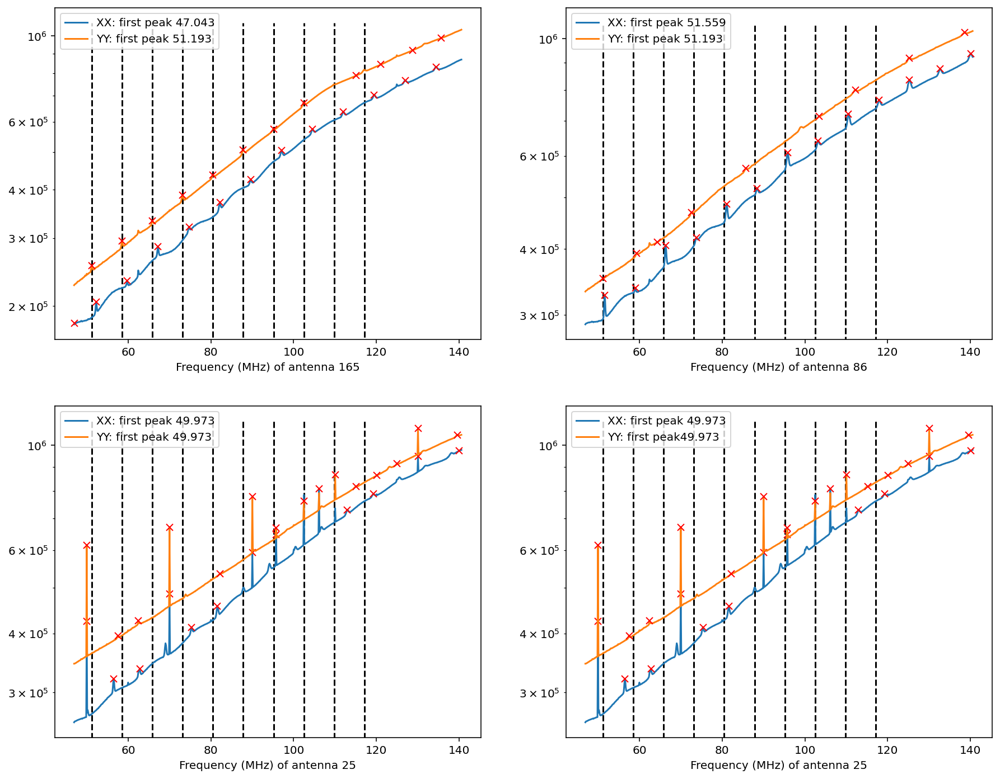

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [48]:
plot_four_noclocks_even(165, 86, 25, 25, 51.193, 7.324, 10)

[ 47.77526855  54.61120605  61.32507324  68.16101074  74.99694824
  81.83288574  88.66882324  95.50476074 102.46276855 109.17663574
 124.92370605]
[ 53.63464355  62.42370605  72.18933105  84.3963623   93.67370605
  99.77722168 115.03601074 124.92370605 130.41687012 138.59558105]


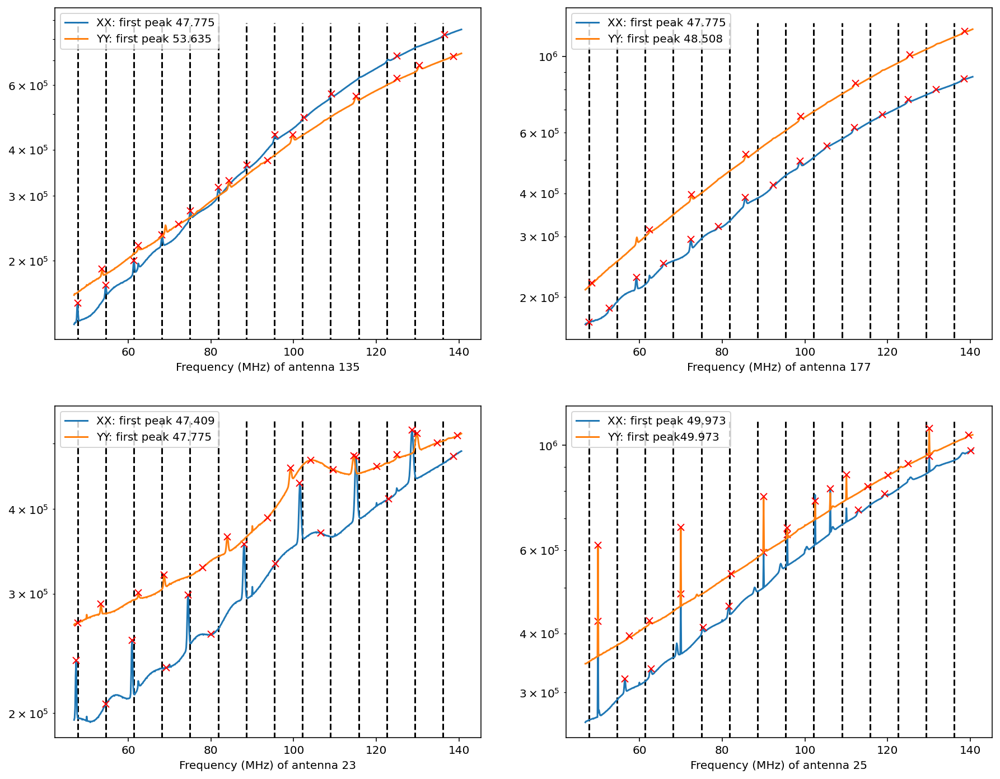

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [51]:
plot_four_noclocks_even(135, 177, 23, 25, 47.775, 6.795, 14)

[ 51.55944824  58.88366699  66.32995605  73.6541748   81.10046387
  88.42468262 103.19519043 117.96569824 125.4119873  132.61413574]
[ 49.36218262  56.44226074  63.52233887  70.60241699  77.5604248
  84.88464355  91.72058105  98.92272949 105.8807373  113.20495605
 119.91882324]


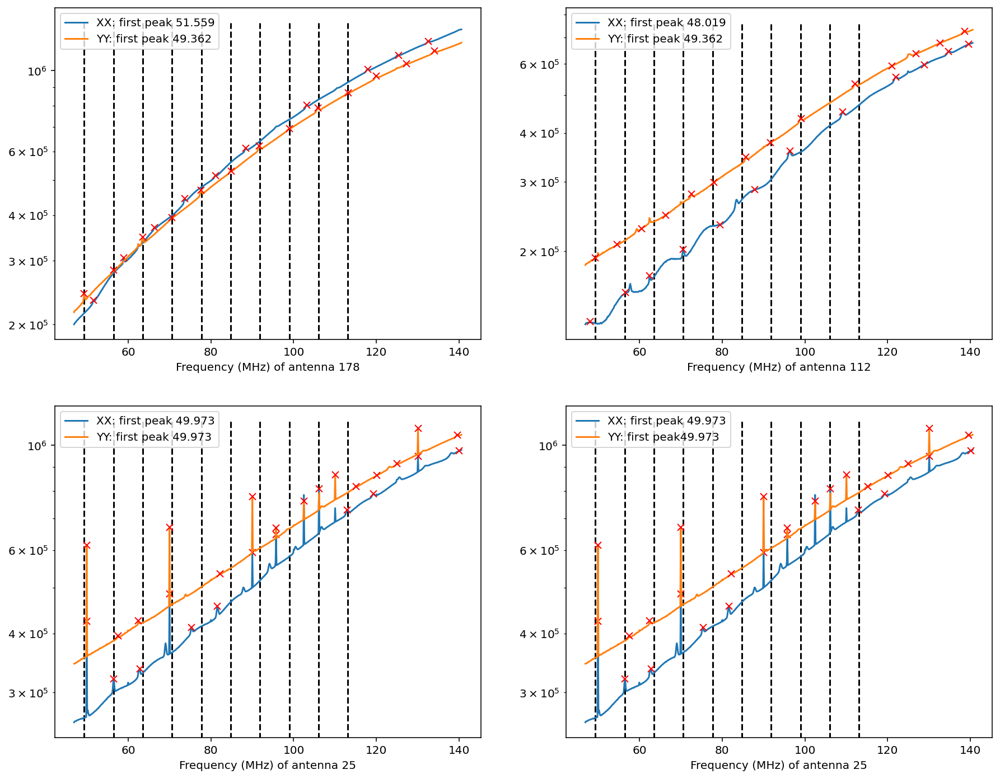

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [55]:
plot_four_noclocks_even(178, 112, 25, 25, 49.362, 7.08, 10)

[ 51.07116699  56.93054199  62.42370605  69.99206543  78.04870605
  87.81433105 109.29870605 117.11120605 124.92370605 138.59558105]
[ 49.97253418  55.58776855  62.42370605  68.03894043  74.14245605
  80.36804199  86.47155762  93.67370605  98.92272949 105.39245605
 111.25183105]


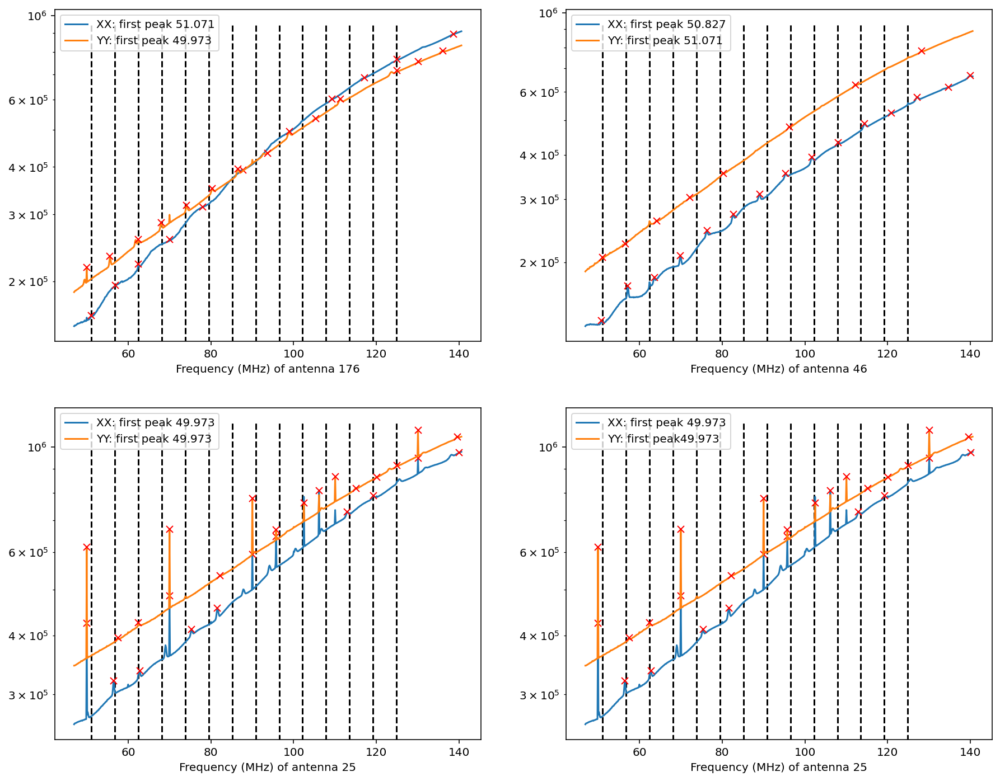

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [58]:
plot_four_noclocks_even(176, 46, 25, 25, 51.071, 5.677, 14)

[ 48.01940918  56.56433105  62.42370605  70.60241699  79.5135498
  87.81433105  96.35925293 109.17663574 121.99401855 128.82995605
 134.68933105]
[ 49.36218262  54.61120605  60.47058105  66.32995605  72.55554199
  78.04870605  85.73913574  91.72058105  99.0447998  112.10632324
 121.01745605]


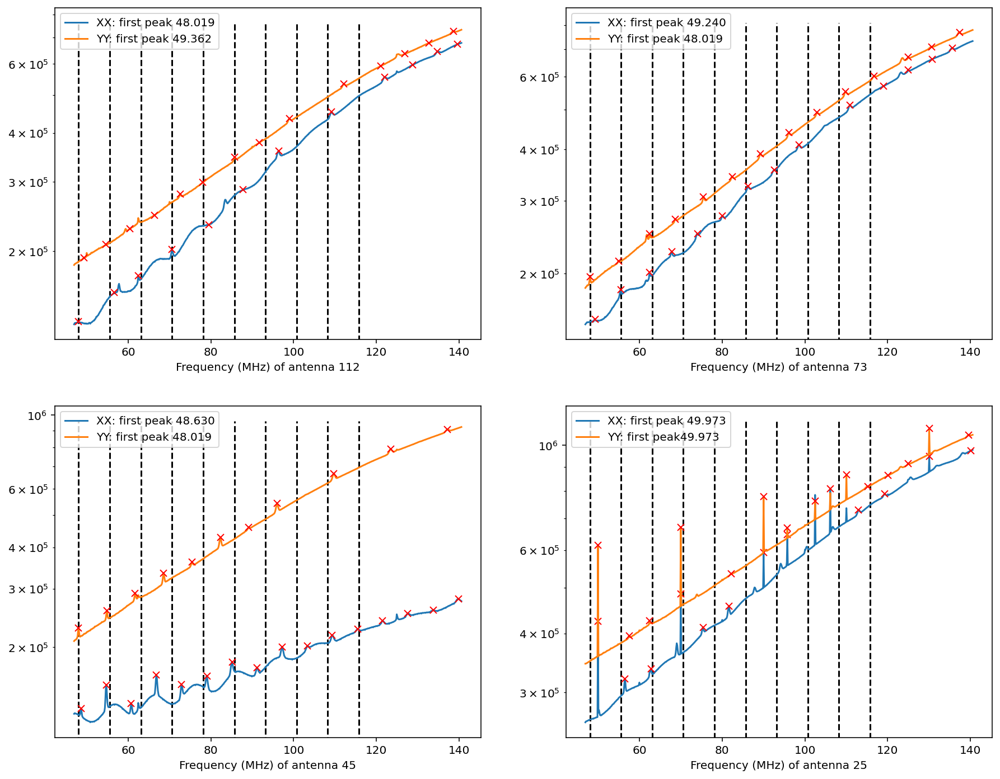

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [62]:
plot_four_noclocks_even(112, 73, 45, 25, 48.019, 7.528, 10)

[ 48.87390137  62.9119873   76.95007324  90.86608887 104.9041748
 118.82019043 124.92370605 132.85827637]
[ 53.39050293  60.10437012  66.69616699  73.41003418  80.12390137
  86.71569824  93.42956543 100.14343262 106.8572998  113.57116699
 120.28503418]


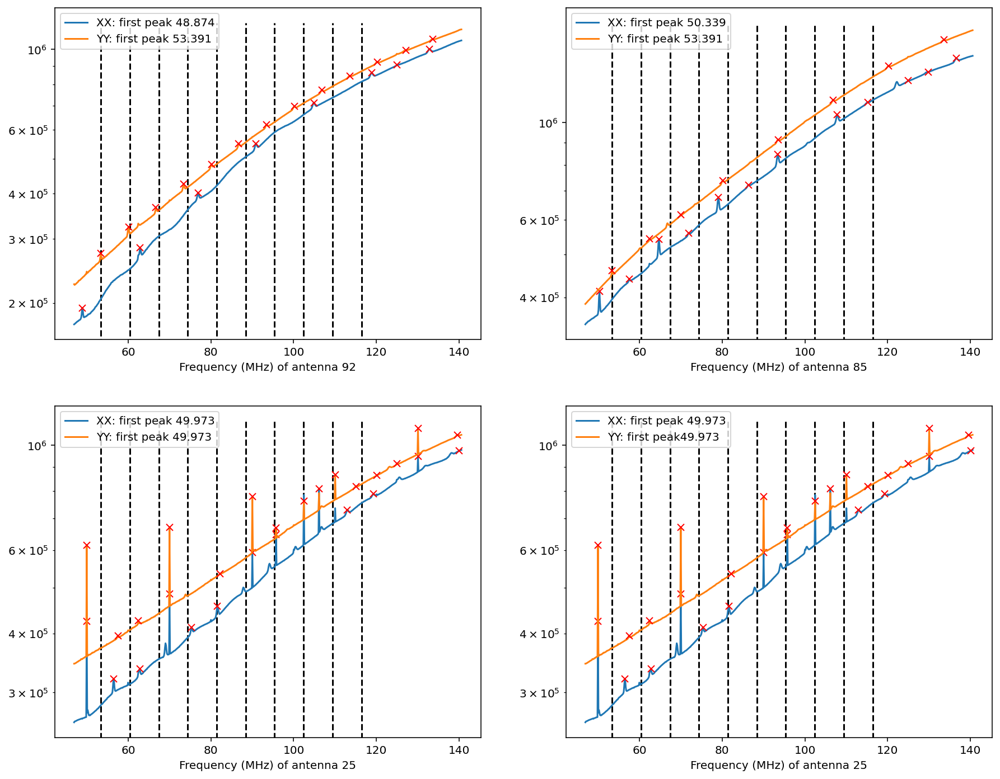

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [67]:
plot_four_noclocks_even(92, 85, 25, 25, 53.391, 6.999, 10)

[ 52.41394043  57.54089355  62.42370605  68.28308105  74.87487793
  82.4432373   90.01159668  97.33581543 104.9041748  112.47253418
 119.79675293]
[ 48.75183105  53.63464355  60.34851074  67.06237793  73.77624512
  80.4901123   87.20397949  93.91784668 100.75378418 107.34558105
 114.18151855]


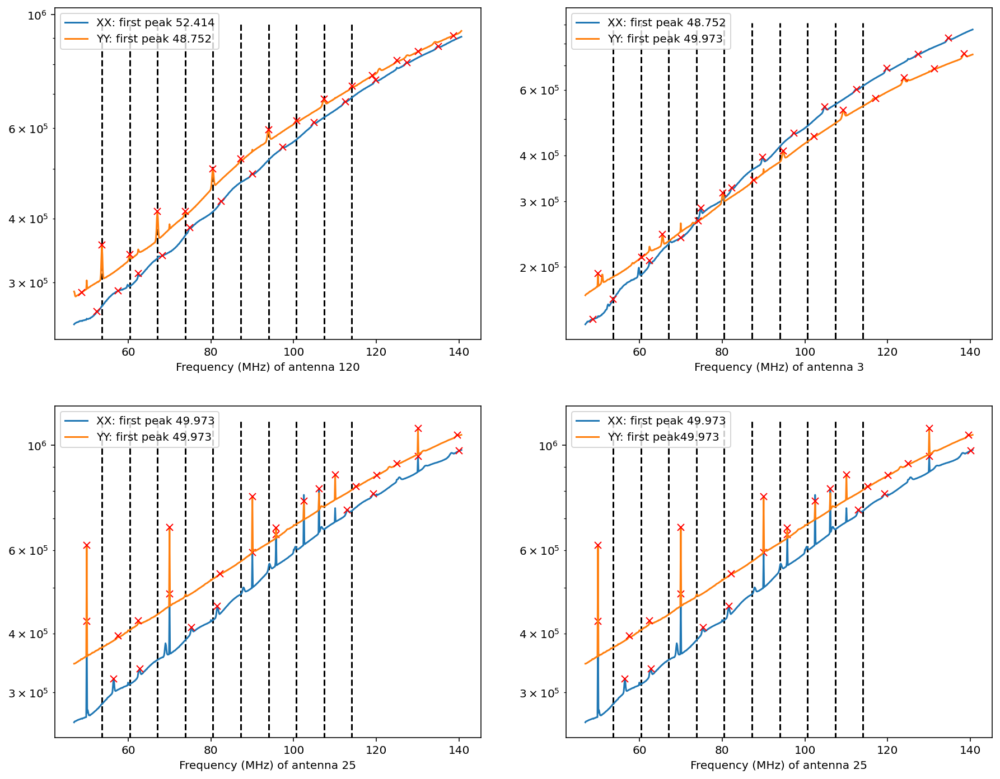

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [70]:
plot_four_noclocks_even(120, 3, 25,25, 53.635, 6.714, 10)

[ 51.31530762  58.63952637  66.08581543  73.28796387  88.05847168
 102.70690918 110.03112793 117.35534668 124.92370605 132.00378418]
[ 62.42370605  73.16589355  86.47155762 101.48620605 113.08288574
 126.3885498  139.69421387]


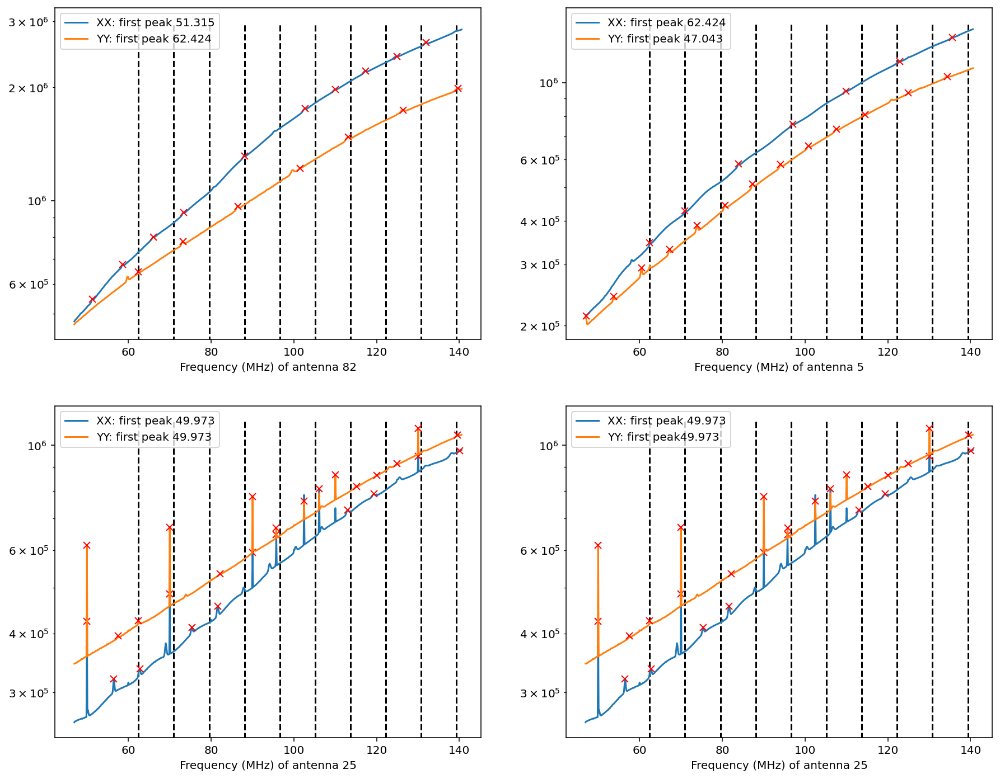

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [28]:
plot_four_noclocks_even(82, 5, 25, 25, 62.424, 8.545, 10)

## Plotting the 86 spacing on all nodes

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


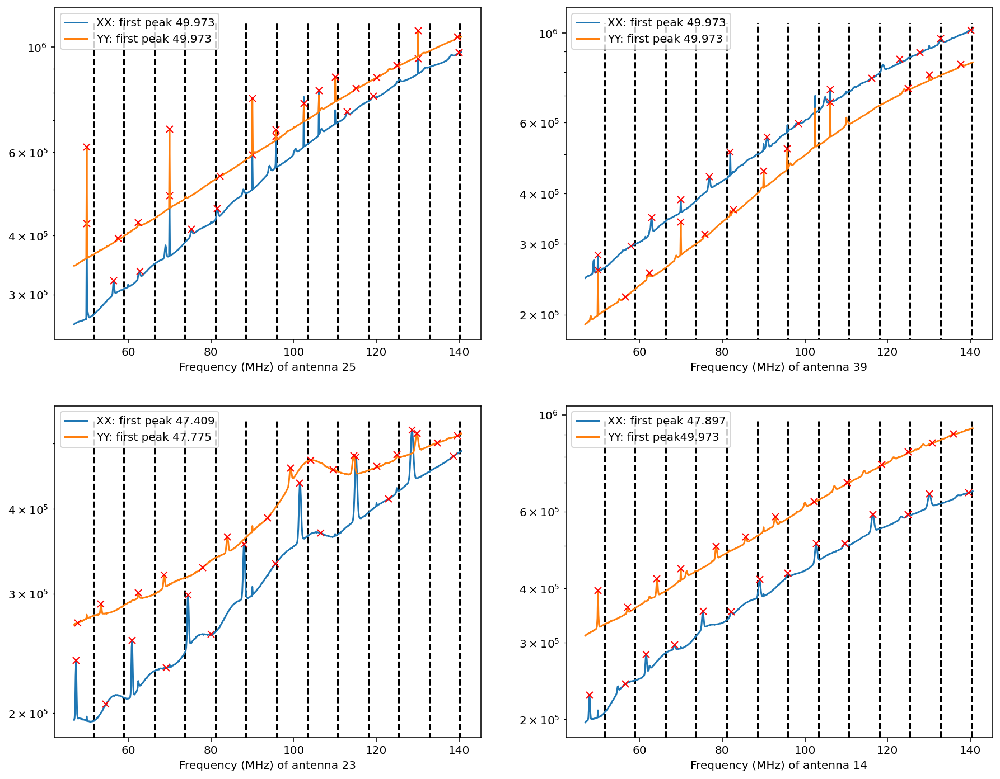

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [18]:
plot_four_noclocks_even(25, 39, 23, 14, 51.559, 7.386, 13) #node 00

[ 48.75183105  53.63464355  62.42370605  69.99206543  74.87487793
  82.32116699  89.76745605  97.33581543 104.78210449 112.47253418
 119.79675293]
[ 49.97253418  60.47058105  65.59753418  74.14245605  80.12390137
  87.57019043  94.77233887 102.21862793 109.29870605 117.11120605
 123.94714355]


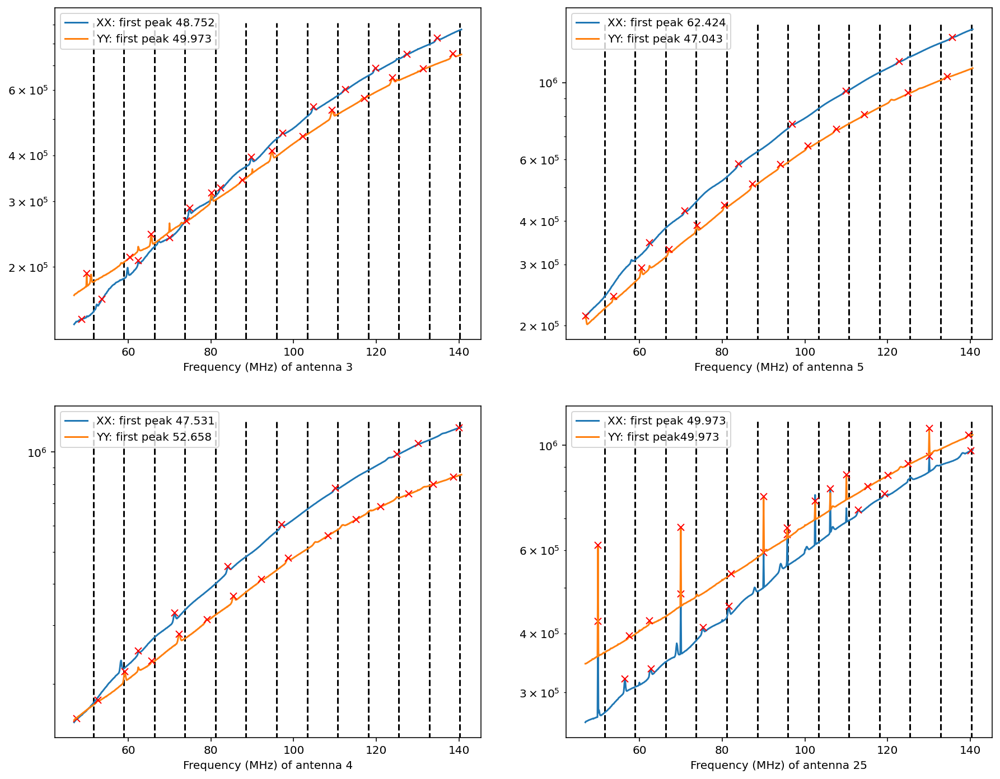

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [19]:
plot_four_noclocks_even(3, 5, 4, 25, 51.559, 7.386, 13) #node 01

[ 50.82702637  57.17468262  63.64440918  69.86999512  76.33972168
  82.68737793  89.03503418  95.38269043 101.73034668 108.07800293
 114.42565918]
[ 51.07116699  56.56433105  64.13269043  72.18933105  80.24597168
  96.23718262 112.22839355 128.21960449]


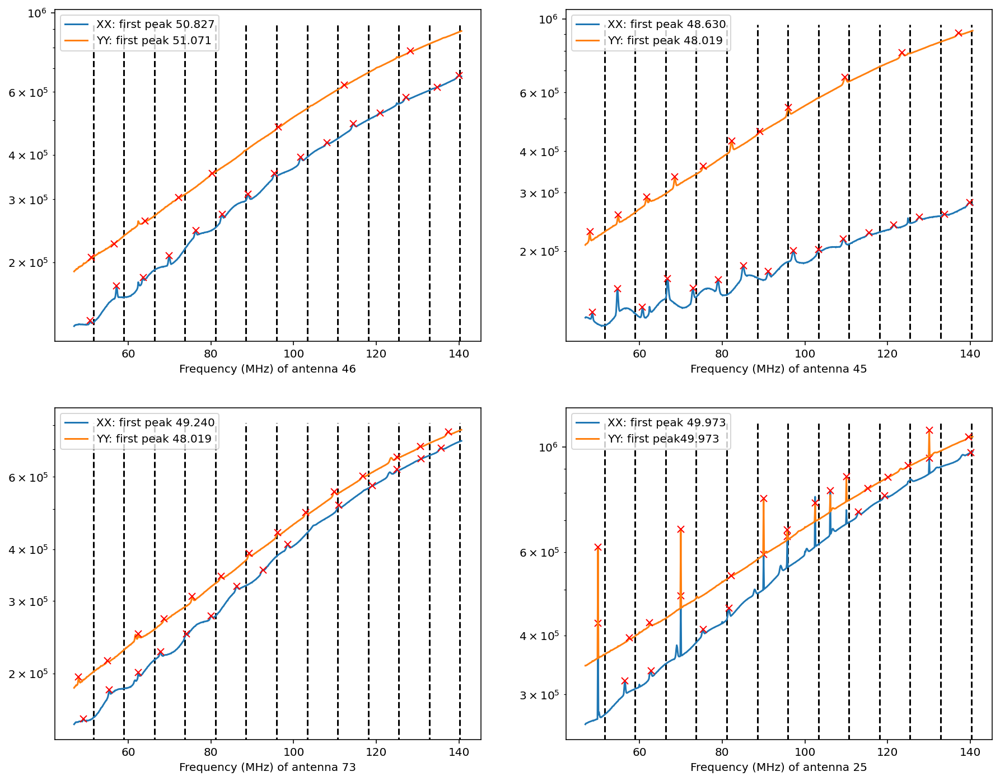

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [20]:
plot_four_noclocks_even(46, 45, 73, 25, 51.559, 7.386, 13) #node 05

[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]


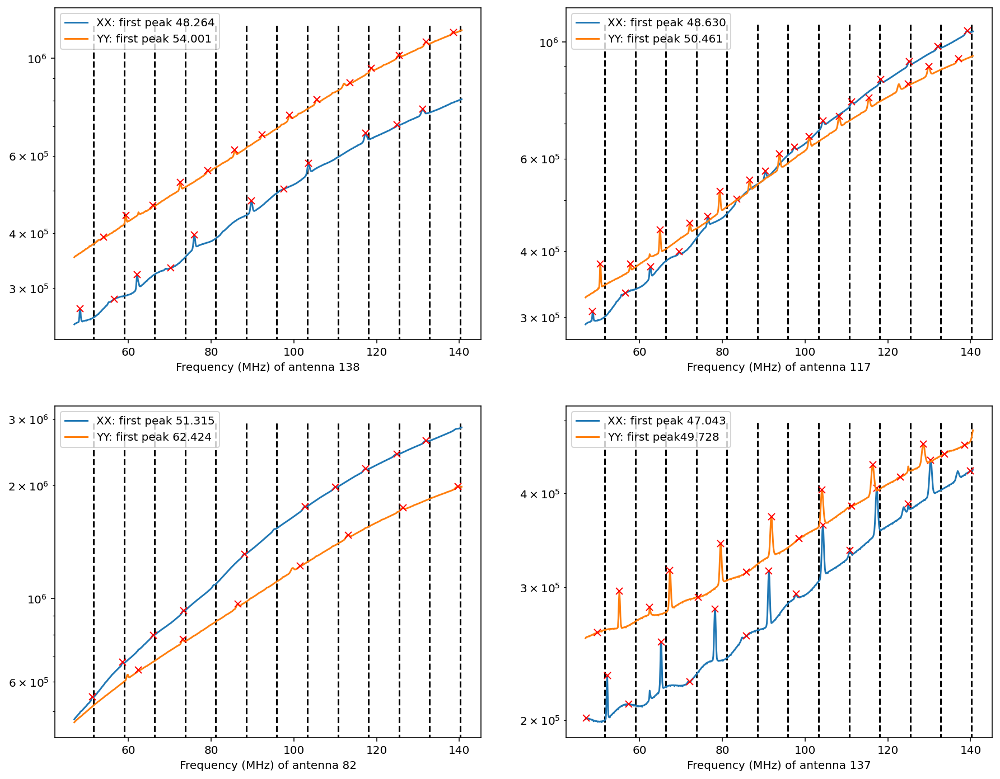

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [21]:
plot_four_noclocks_even(138, 117, 82, 137, 51.559, 7.386, 13) #node 07

[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]


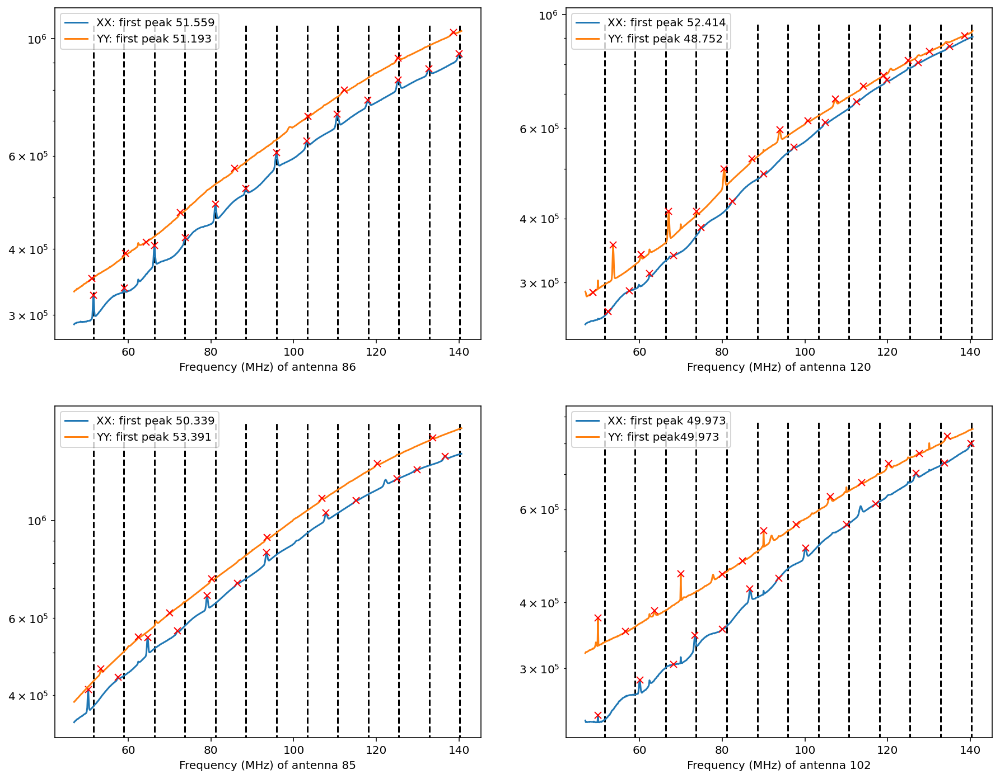

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [23]:
plot_four_noclocks_even(86, 120, 85, 102, 51.559, 7.386, 13) #node 08

[ 48.01940918  56.56433105  62.42370605  70.60241699  79.5135498
  87.81433105  96.35925293 109.17663574 121.99401855 128.82995605
 134.68933105]
[ 49.36218262  54.61120605  60.47058105  66.32995605  72.55554199
  78.04870605  85.73913574  91.72058105  99.0447998  112.10632324
 121.01745605]


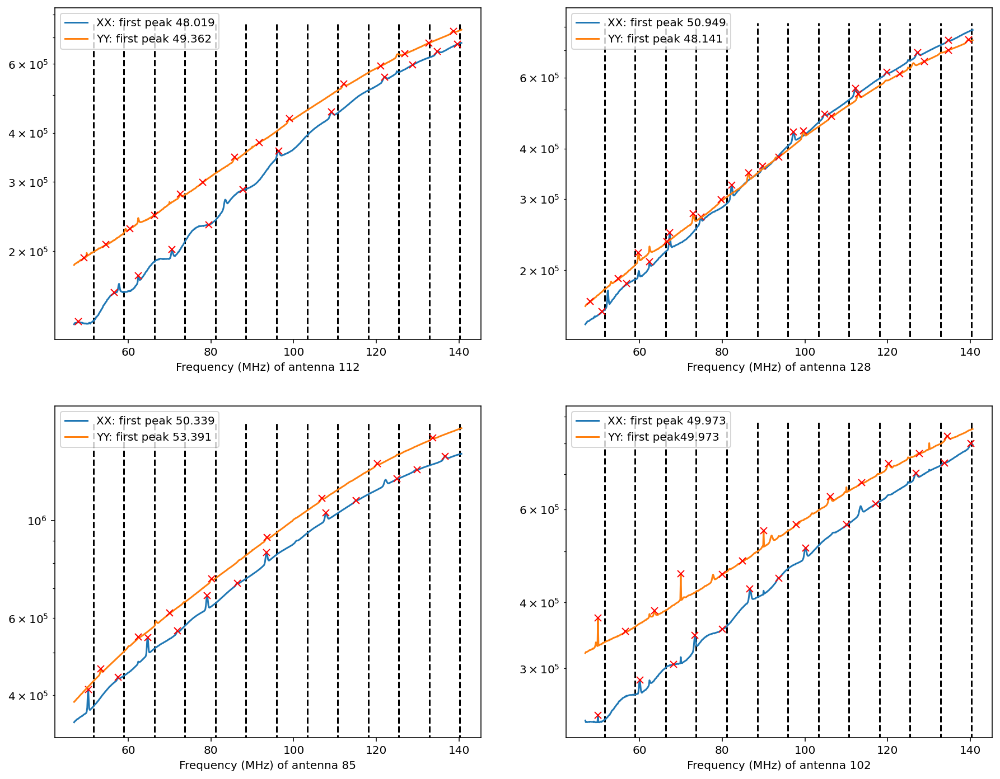

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [24]:
plot_four_noclocks_even(112, 128, 85, 102, 51.559, 7.386, 13) #node 10

[ 51.07116699  56.93054199  62.42370605  69.99206543  78.04870605
  87.81433105 109.29870605 117.11120605 124.92370605 138.59558105]
[ 49.97253418  55.58776855  62.42370605  68.03894043  74.14245605
  80.36804199  86.47155762  93.67370605  98.92272949 105.39245605
 111.25183105]


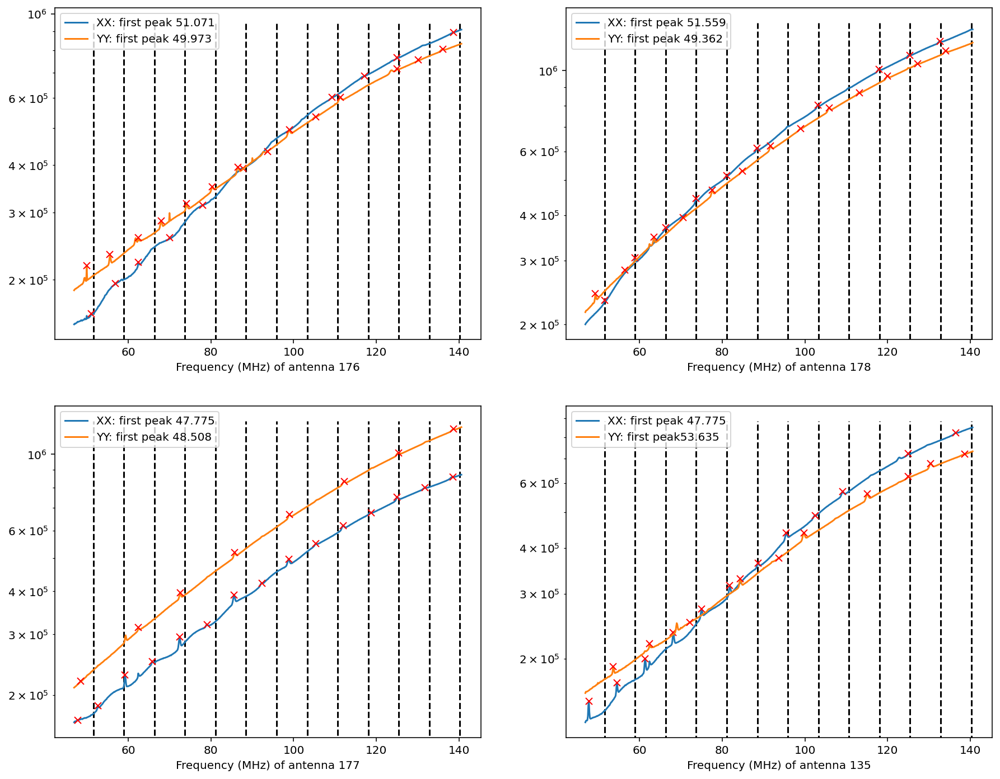

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [25]:
plot_four_noclocks_even(176, 178, 177, 135, 51.559, 7.386, 13) #node 12

[ 47.04284668  52.29187012  59.73815918  67.18444824  74.75280762
  82.19909668  89.64538574  97.0916748  104.53796387 111.98425293
 119.43054199]
[ 51.1932373   58.51745605  65.8416748   73.16589355  80.4901123
  87.81433105  95.26062012 102.46276855 115.15808105 121.01745605
 128.82995605]


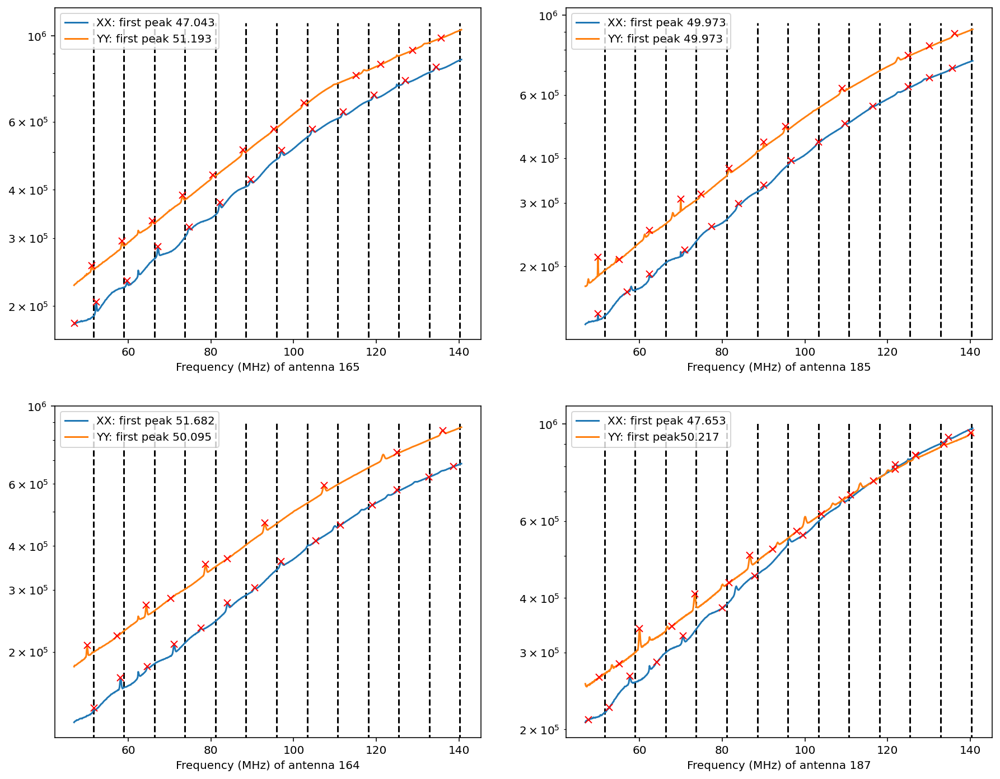

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [26]:
plot_four_noclocks_even(165, 185, 164, 187, 51.559, 7.386, 13) #node 14

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


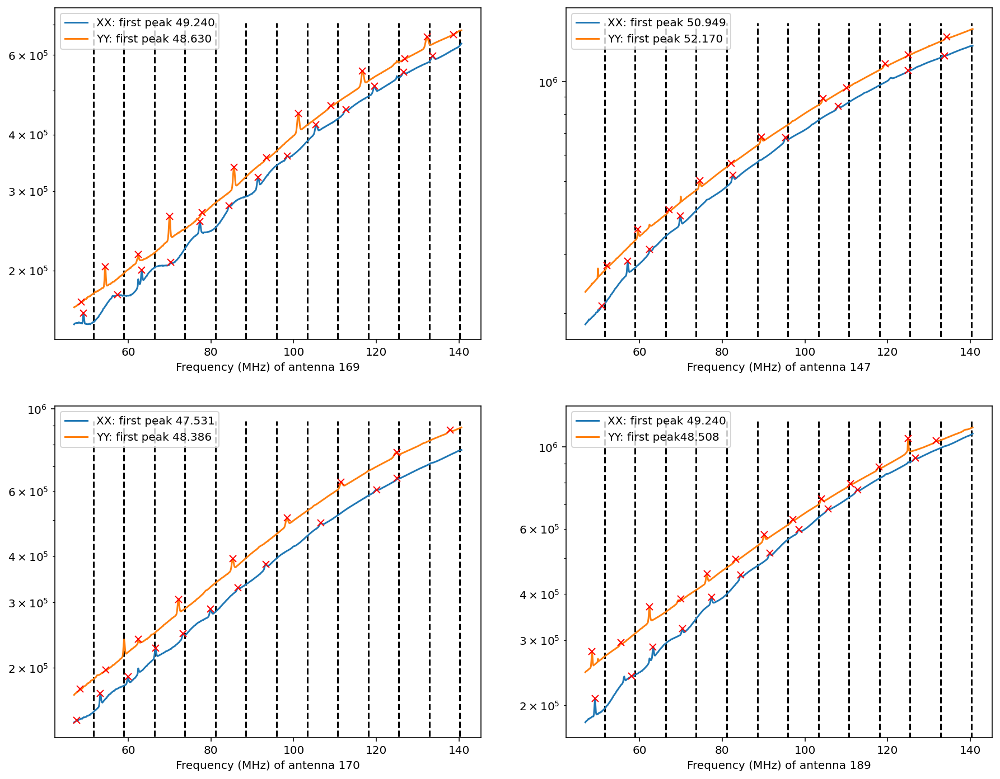

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [27]:
plot_four_noclocks_even(169, 147, 170, 189, 51.559, 7.386, 13) #node 15

## Plotting the 23 spacing on all nodes

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


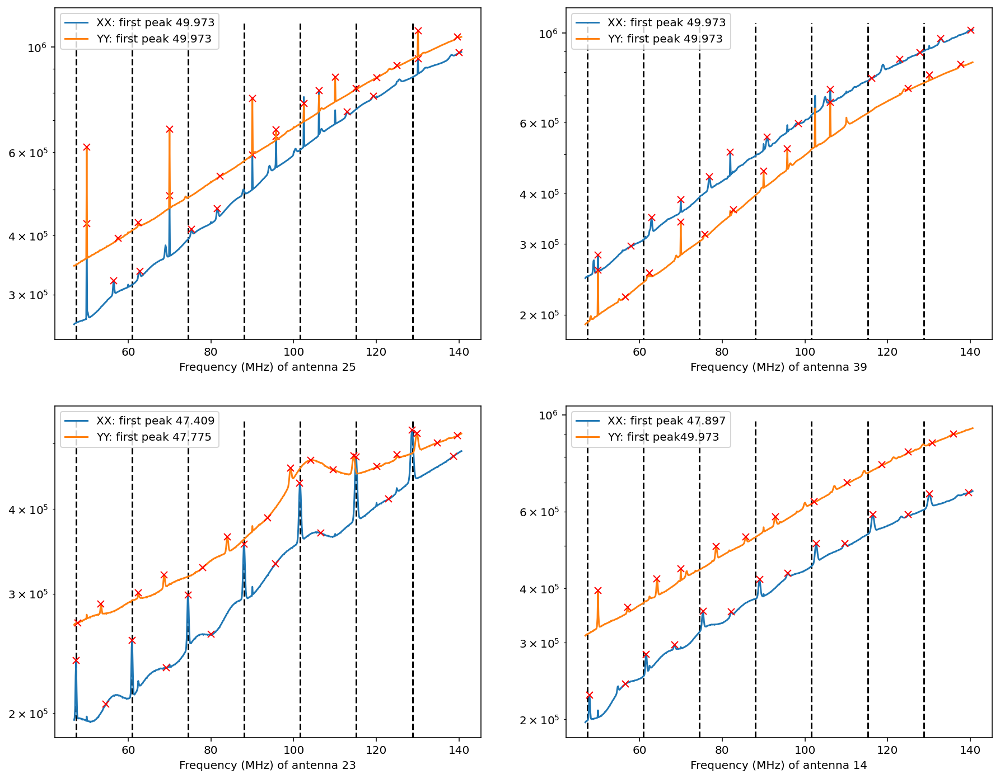

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [47]:
plot_four_noclocks_even(25, 39, 23, 14, 47.409, 13.55, 7) #node 00

[ 48.75183105  53.63464355  62.42370605  69.99206543  74.87487793
  82.32116699  89.76745605  97.33581543 104.78210449 112.47253418
 119.79675293]
[ 49.97253418  60.47058105  65.59753418  74.14245605  80.12390137
  87.57019043  94.77233887 102.21862793 109.29870605 117.11120605
 123.94714355]


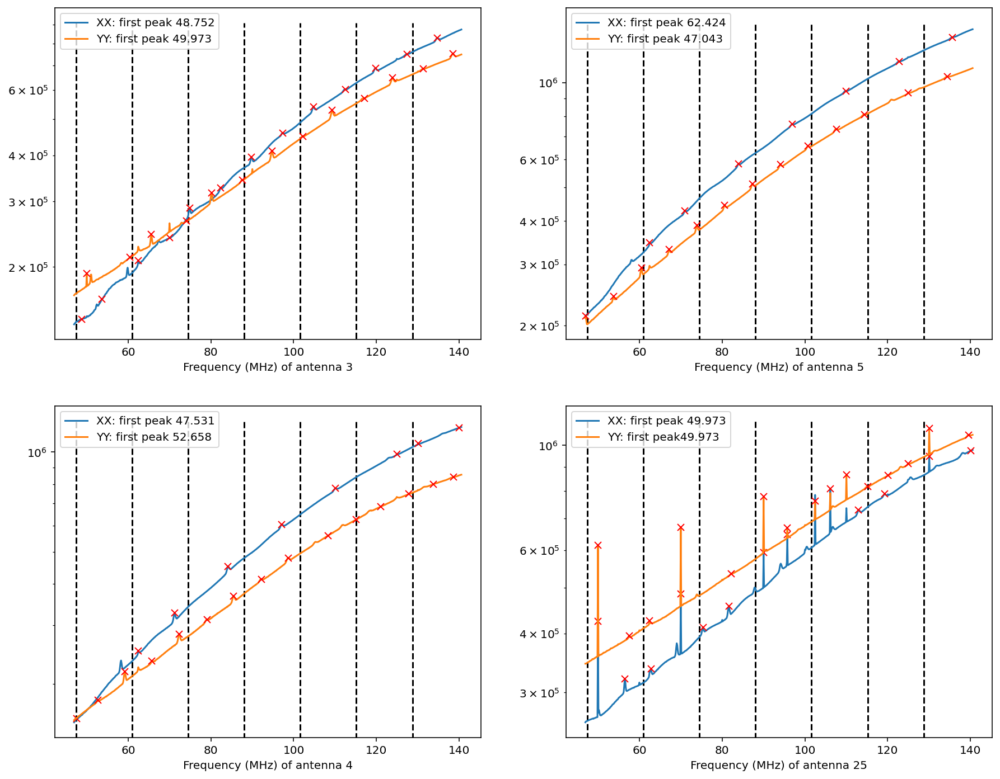

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [48]:
plot_four_noclocks_even(3, 5, 4, 25, 47.409, 13.55, 7) #node 01

[ 50.82702637  57.17468262  63.64440918  69.86999512  76.33972168
  82.68737793  89.03503418  95.38269043 101.73034668 108.07800293
 114.42565918]
[ 51.07116699  56.56433105  64.13269043  72.18933105  80.24597168
  96.23718262 112.22839355 128.21960449]


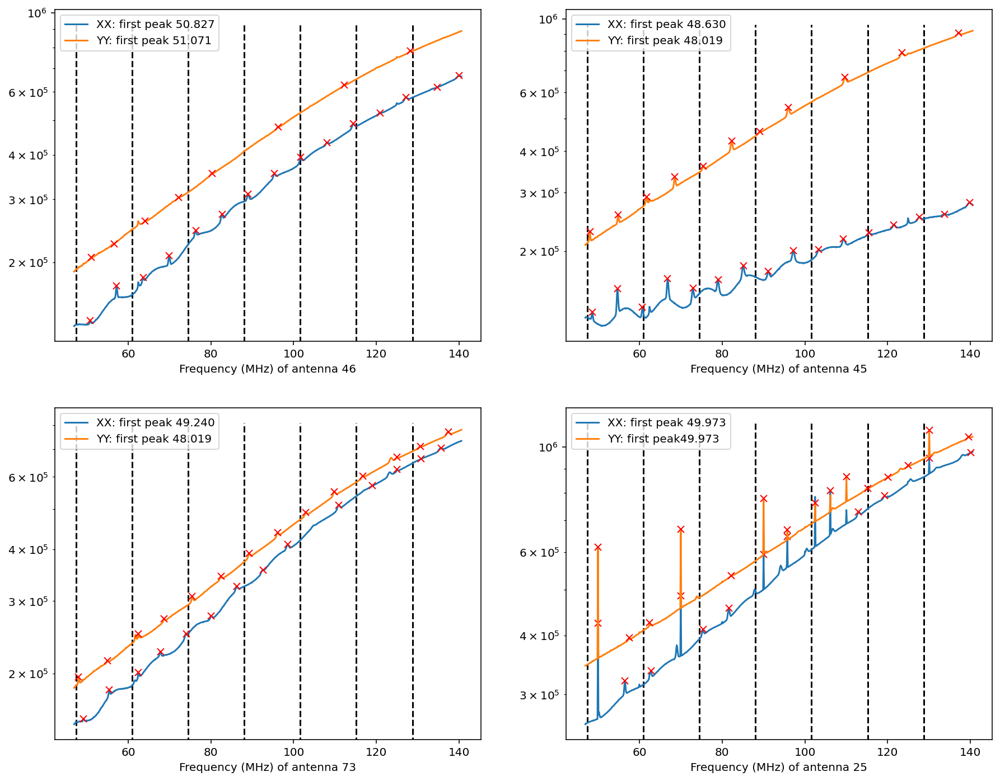

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [49]:
plot_four_noclocks_even(46, 45, 73, 25, 47.409, 13.55, 7) #node 05

[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]


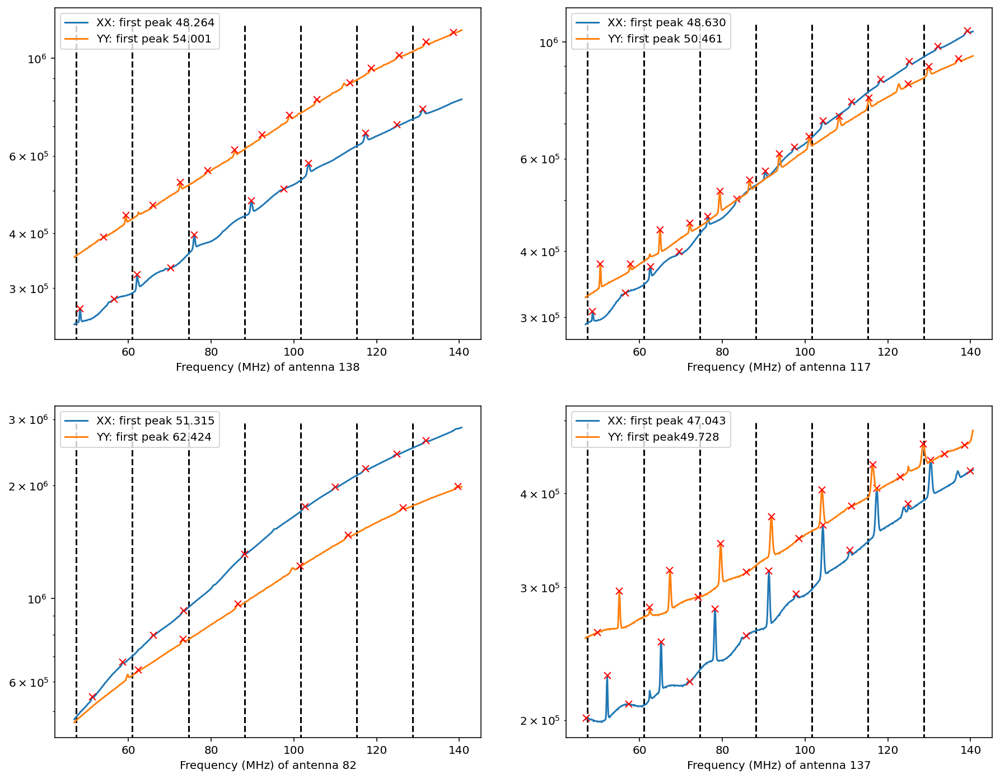

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [50]:
plot_four_noclocks_even(138, 117, 82, 137, 47.409, 13.55, 7) #node 07

[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]


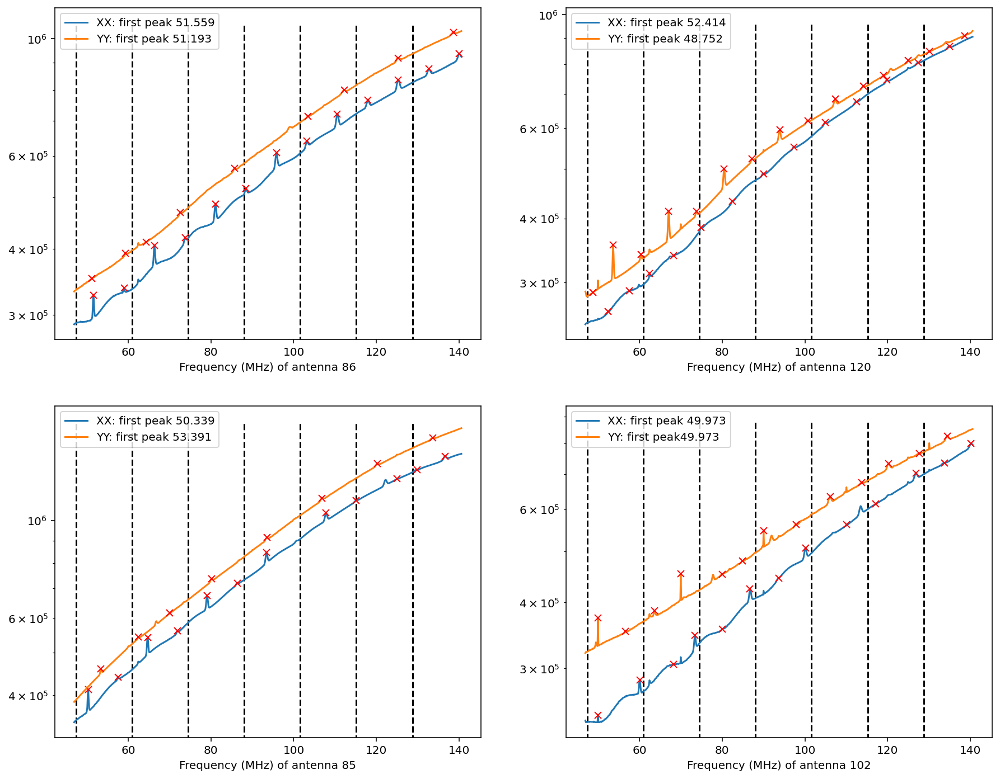

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [51]:
plot_four_noclocks_even(86, 120, 85, 102, 47.409, 13.55, 7) #node 08

[ 48.01940918  56.56433105  62.42370605  70.60241699  79.5135498
  87.81433105  96.35925293 109.17663574 121.99401855 128.82995605
 134.68933105]
[ 49.36218262  54.61120605  60.47058105  66.32995605  72.55554199
  78.04870605  85.73913574  91.72058105  99.0447998  112.10632324
 121.01745605]


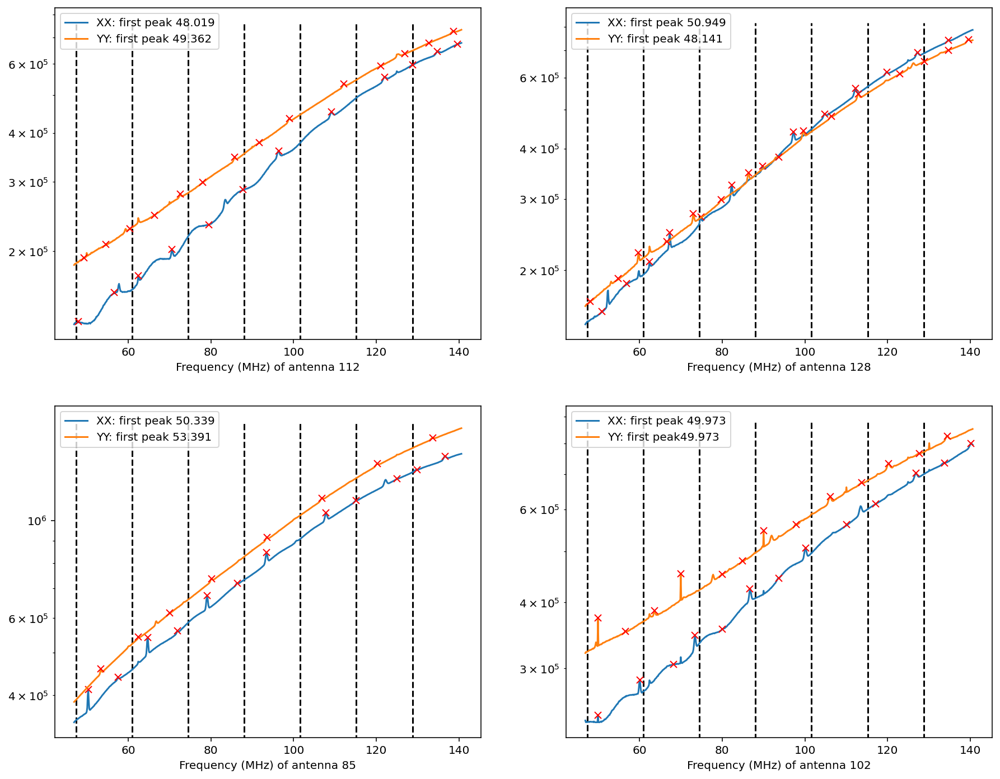

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [52]:
plot_four_noclocks_even(112, 128, 85, 102, 47.409, 13.55, 7) #node 10

[ 51.07116699  56.93054199  62.42370605  69.99206543  78.04870605
  87.81433105 109.29870605 117.11120605 124.92370605 138.59558105]
[ 49.97253418  55.58776855  62.42370605  68.03894043  74.14245605
  80.36804199  86.47155762  93.67370605  98.92272949 105.39245605
 111.25183105]


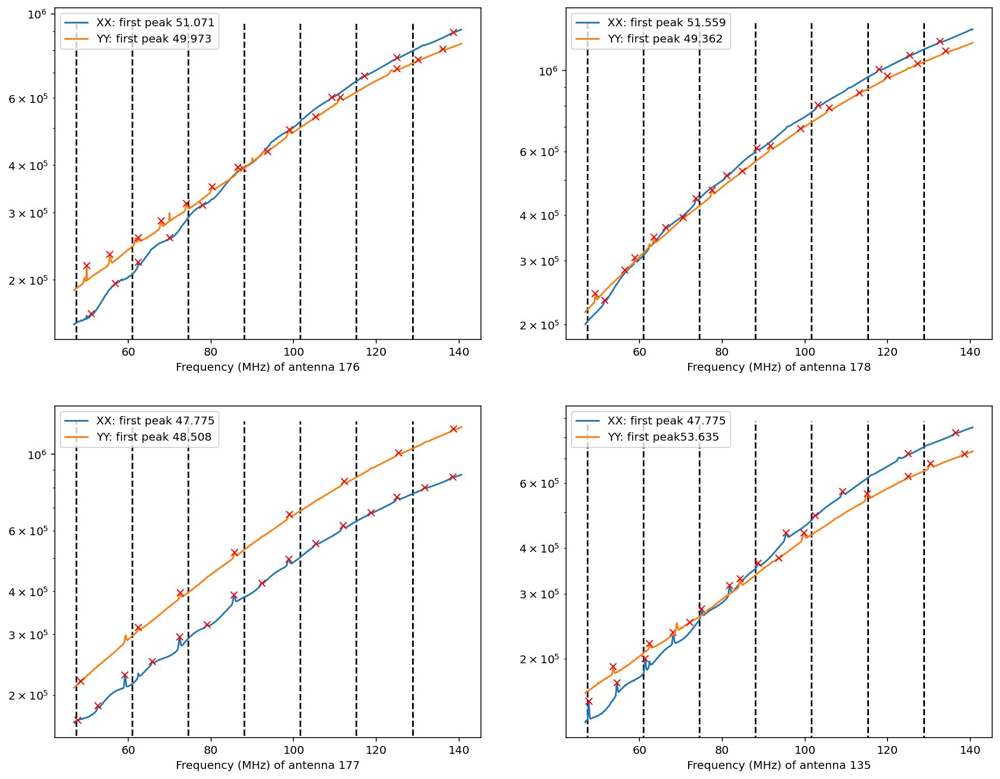

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [53]:
plot_four_noclocks_even(176, 178, 177, 135, 47.409, 13.55, 7) #node 12

[ 47.04284668  52.29187012  59.73815918  67.18444824  74.75280762
  82.19909668  89.64538574  97.0916748  104.53796387 111.98425293
 119.43054199]
[ 51.1932373   58.51745605  65.8416748   73.16589355  80.4901123
  87.81433105  95.26062012 102.46276855 115.15808105 121.01745605
 128.82995605]


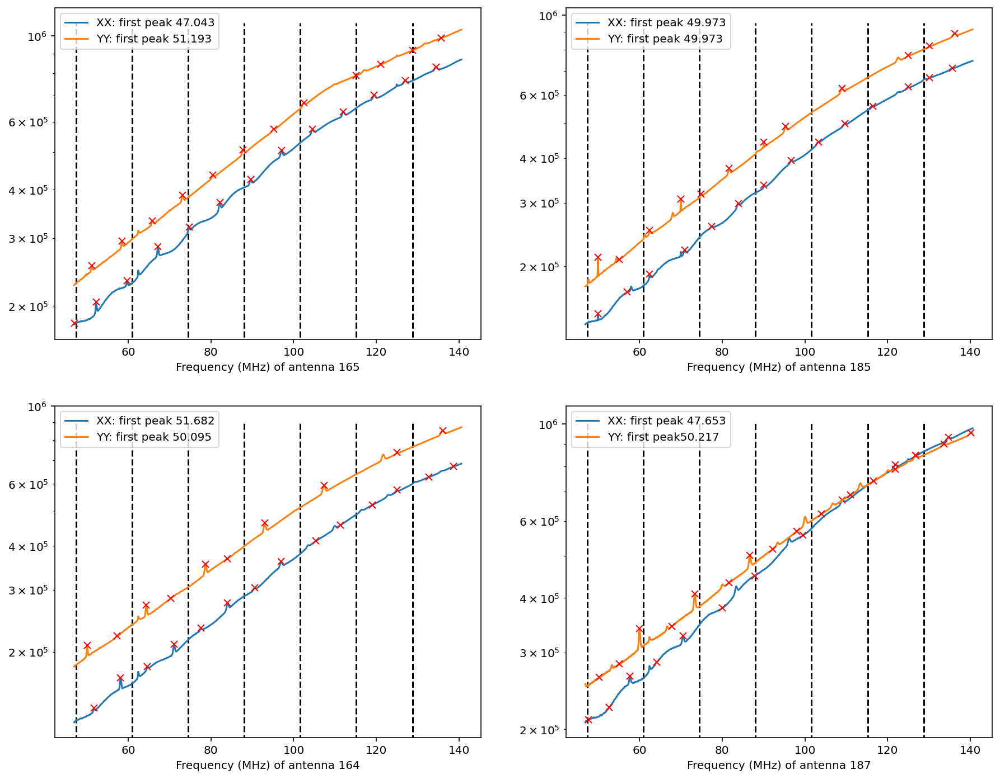

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [54]:
plot_four_noclocks_even(165, 185, 164, 187, 47.409, 13.55, 7) #node 14

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


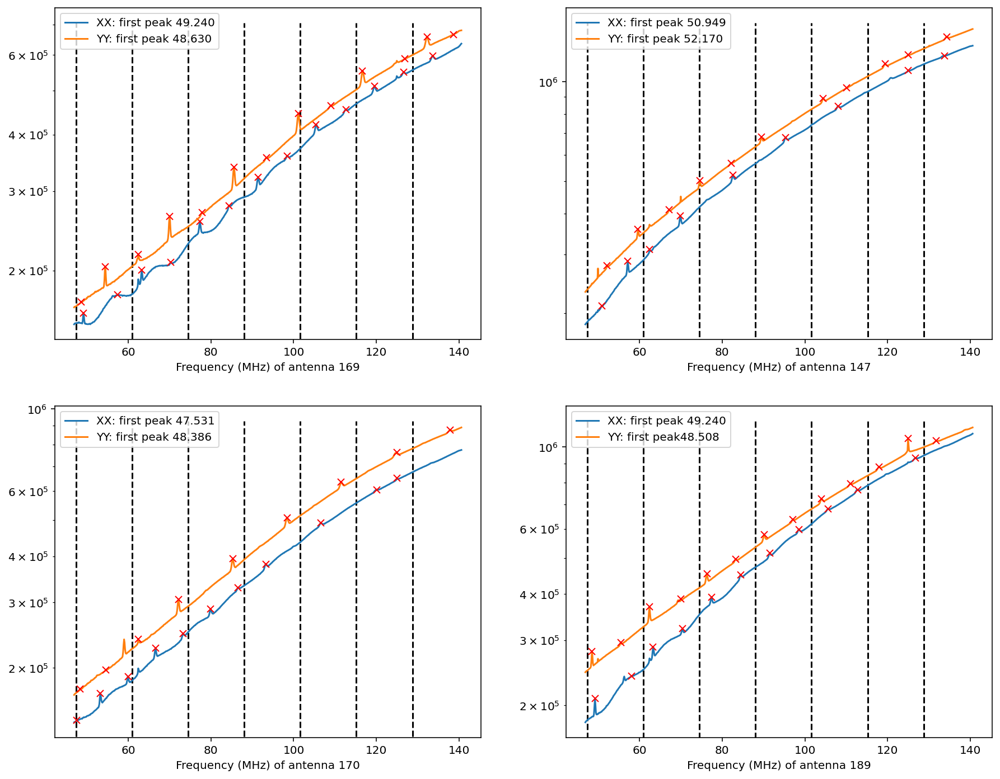

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [55]:
plot_four_noclocks_even(169, 147, 170, 189, 47.409, 13.55, 7) #node 15

## Plotting the 169 spacing on all nodes

[ 49.97253418  56.44226074  62.78991699  69.99206543  75.36315918
  81.58874512  90.01159668  95.74890137 106.12487793 112.96081543
 119.30847168]
[ 49.97253418  57.54089355  62.42370605  69.99206543  82.19909668
  90.01159668  95.74890137 102.46276855 110.03112793 115.15808105
 120.04089355]


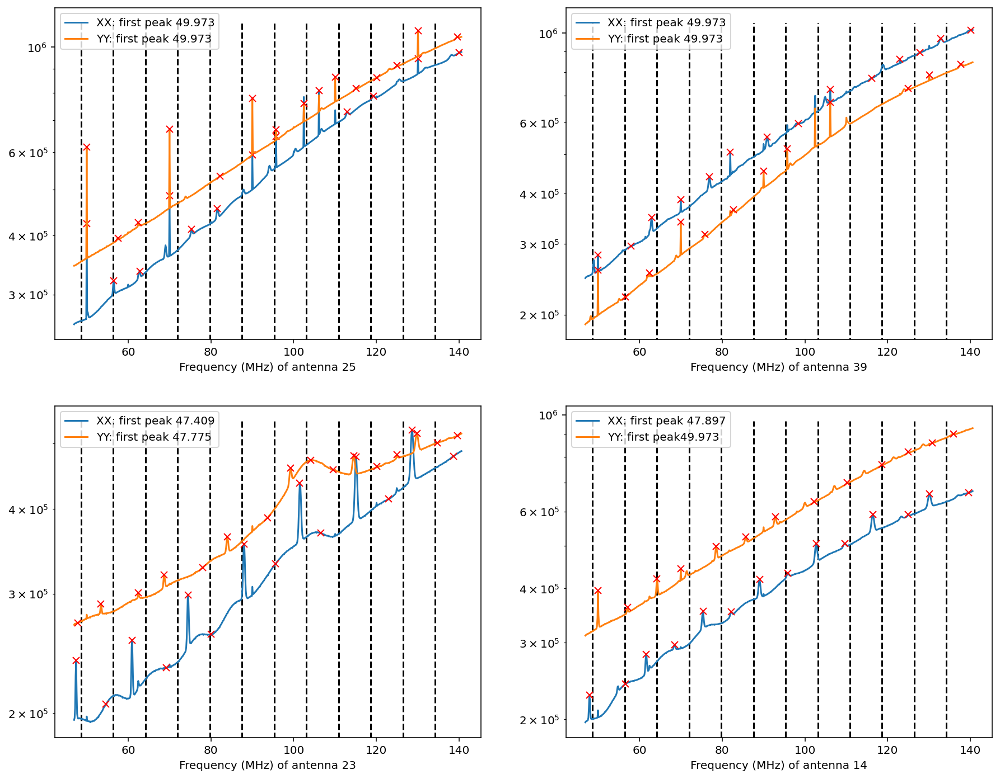

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [57]:
plot_four_noclocks_even(25, 39, 23, 14, 48.630, 7.782, 12) #node 00

[ 48.75183105  53.63464355  62.42370605  69.99206543  74.87487793
  82.32116699  89.76745605  97.33581543 104.78210449 112.47253418
 119.79675293]
[ 49.97253418  60.47058105  65.59753418  74.14245605  80.12390137
  87.57019043  94.77233887 102.21862793 109.29870605 117.11120605
 123.94714355]


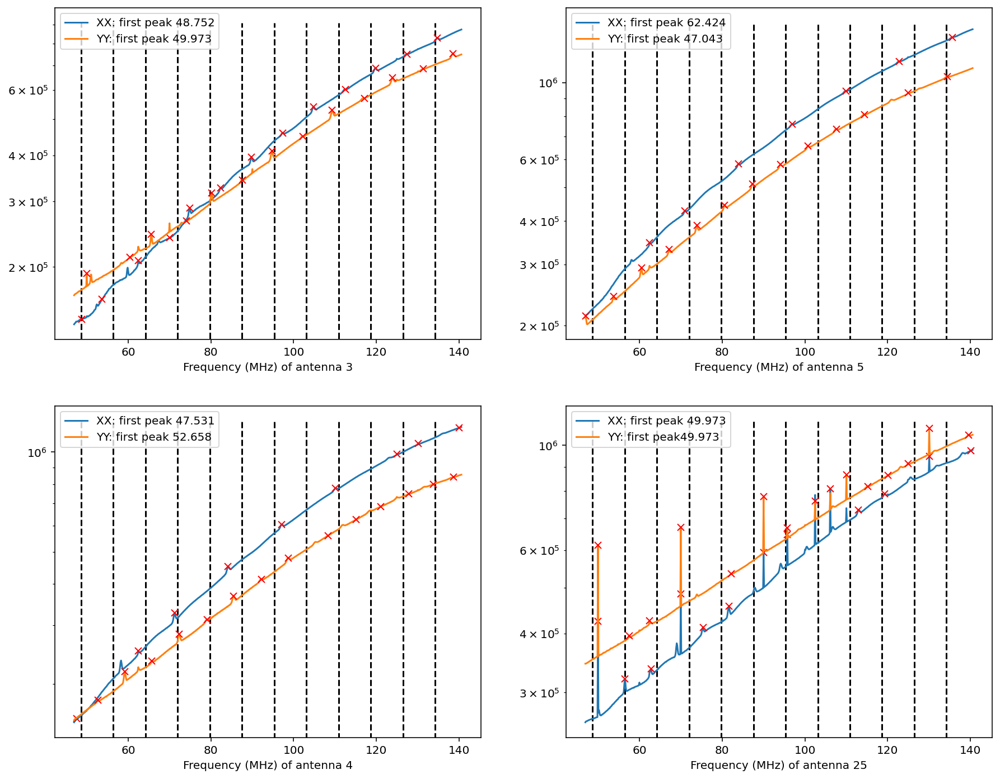

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [58]:
plot_four_noclocks_even(3, 5, 4, 25, 48.630, 7.782, 12) #node 01

[ 50.82702637  57.17468262  63.64440918  69.86999512  76.33972168
  82.68737793  89.03503418  95.38269043 101.73034668 108.07800293
 114.42565918]
[ 51.07116699  56.56433105  64.13269043  72.18933105  80.24597168
  96.23718262 112.22839355 128.21960449]


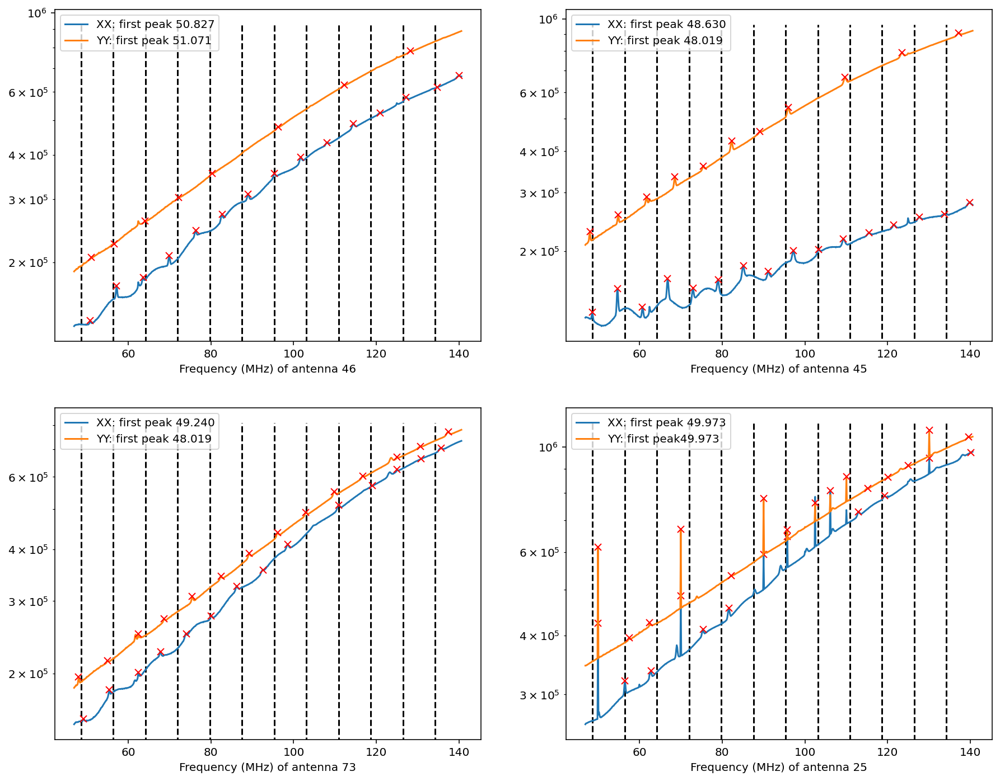

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [59]:
plot_four_noclocks_even(46, 45, 73, 25, 48.630, 7.782, 12) #node 05

[ 48.2635498   56.56433105  62.17956543  70.23620605  75.97351074
  89.76745605  97.57995605 103.56140137 117.35534668 124.92370605
 131.14929199]
[ 54.00085449  59.37194824  65.96374512  72.55554199  79.14733887
  85.73913574  92.33093262  98.92272949 105.51452637 113.57116699
 118.69812012]


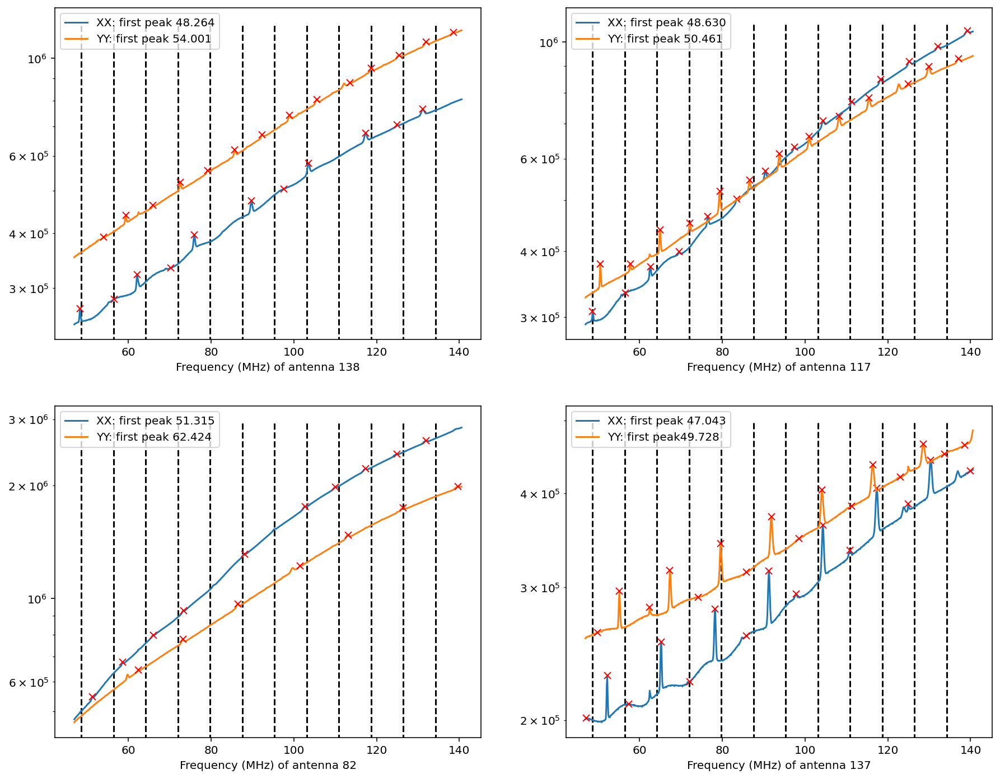

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [60]:
plot_four_noclocks_even(138, 117, 82, 137, 48.630, 7.782, 12) #node 07

[ 51.55944824  59.0057373   66.32995605  73.77624512  81.10046387
  88.42468262  95.87097168 103.19519043 110.51940918 117.96569824
 125.28991699]
[ 51.1932373   59.37194824  64.37683105  72.55554199  85.73913574
 103.43933105 112.22839355 125.28991699 138.59558105]


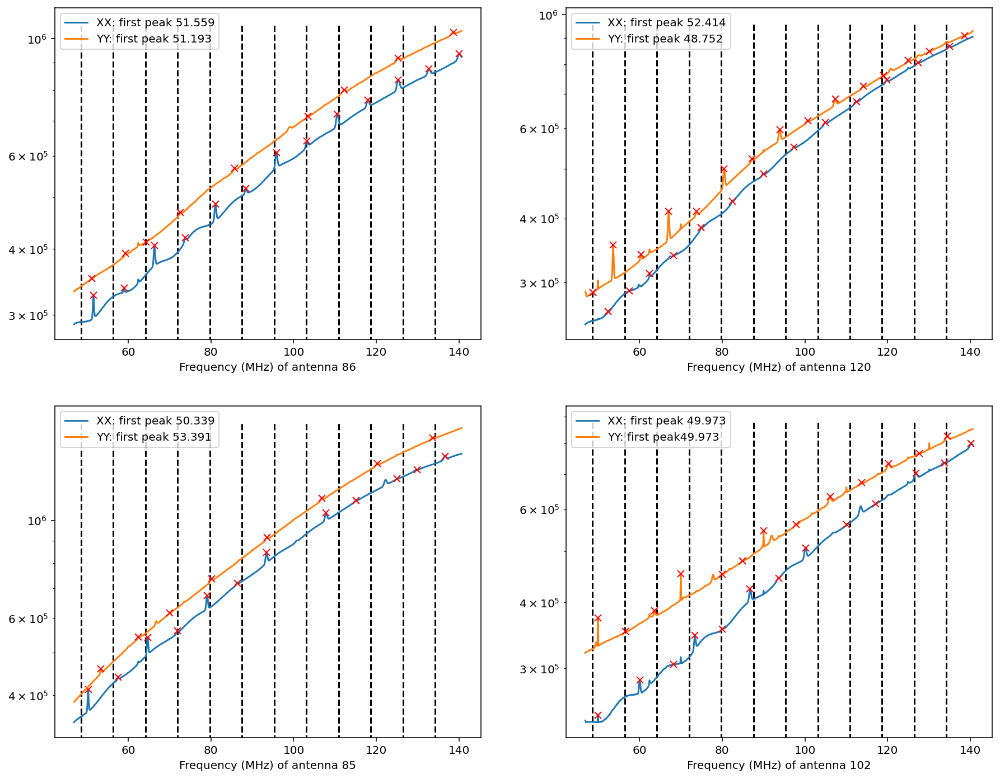

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [61]:
plot_four_noclocks_even(86, 120, 85, 102, 48.630, 7.782, 12) #node 08

[ 48.01940918  56.56433105  62.42370605  70.60241699  79.5135498
  87.81433105  96.35925293 109.17663574 121.99401855 128.82995605
 134.68933105]
[ 49.36218262  54.61120605  60.47058105  66.32995605  72.55554199
  78.04870605  85.73913574  91.72058105  99.0447998  112.10632324
 121.01745605]


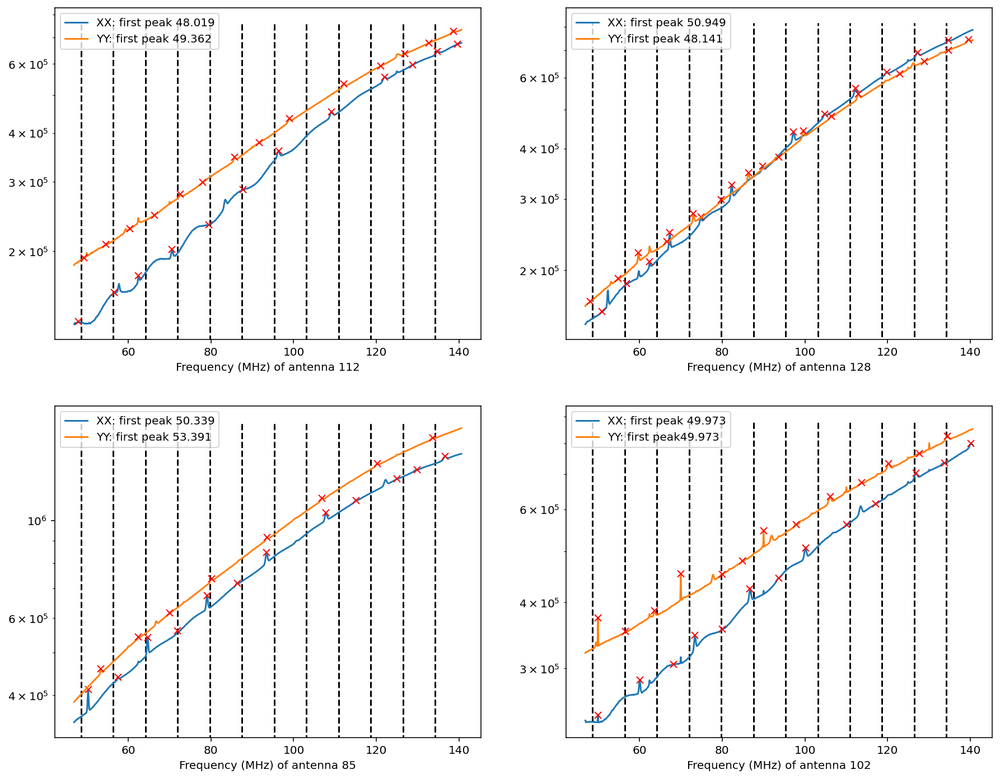

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [62]:
plot_four_noclocks_even(112, 128, 85, 102, 48.630, 7.782, 12) #node 10

[ 51.07116699  56.93054199  62.42370605  69.99206543  78.04870605
  87.81433105 109.29870605 117.11120605 124.92370605 138.59558105]
[ 49.97253418  55.58776855  62.42370605  68.03894043  74.14245605
  80.36804199  86.47155762  93.67370605  98.92272949 105.39245605
 111.25183105]


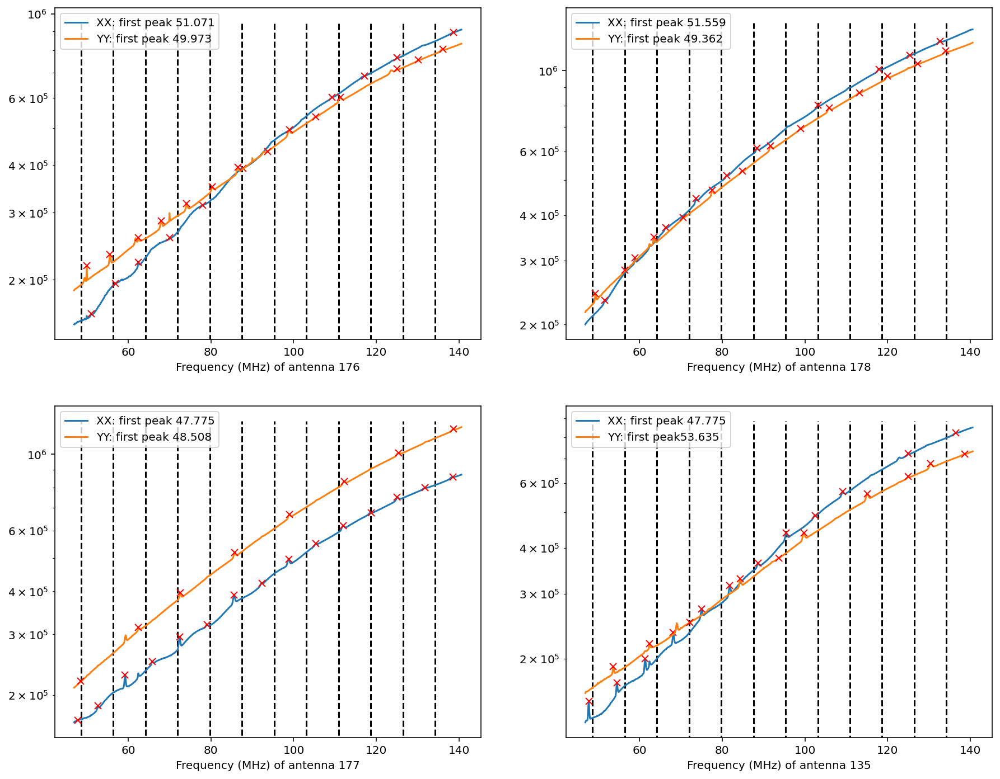

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [63]:
plot_four_noclocks_even(176, 178, 177, 135, 48.630, 7.782, 12) #node 12

[ 47.04284668  52.29187012  59.73815918  67.18444824  74.75280762
  82.19909668  89.64538574  97.0916748  104.53796387 111.98425293
 119.43054199]
[ 51.1932373   58.51745605  65.8416748   73.16589355  80.4901123
  87.81433105  95.26062012 102.46276855 115.15808105 121.01745605
 128.82995605]


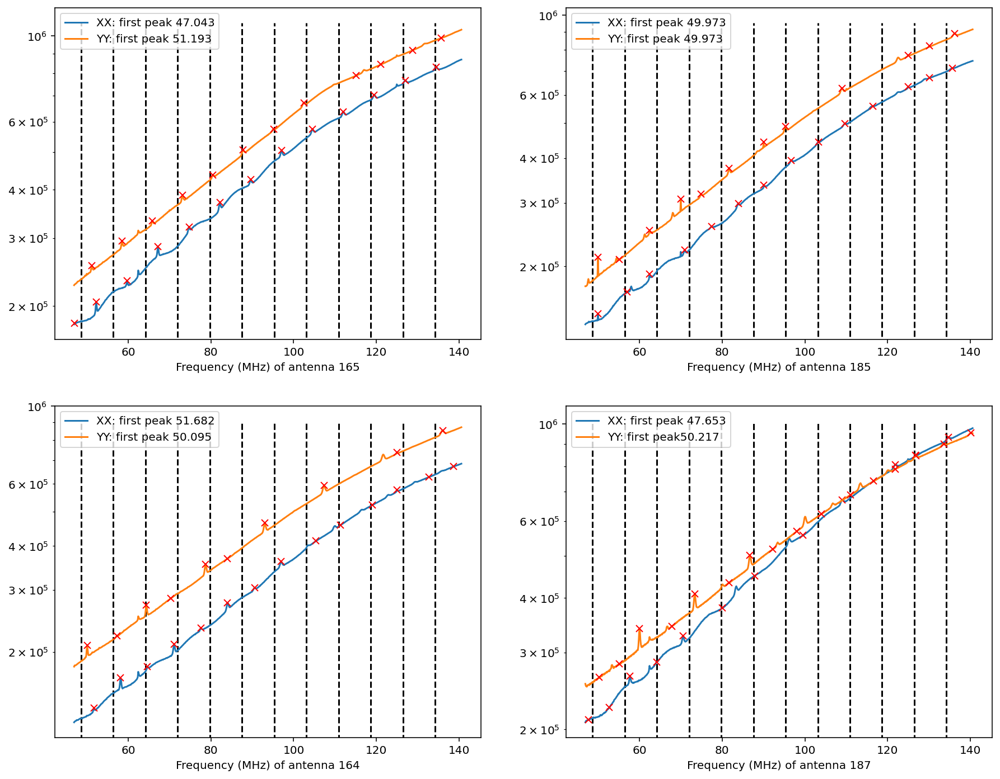

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [64]:
plot_four_noclocks_even(165, 185, 164, 187, 48.630, 7.782, 12) #node 14

[ 49.2401123   57.41882324  63.27819824  70.23620605  77.31628418
  84.3963623   91.35437012  98.43444824 105.39245605 112.59460449
 119.5526123 ]
[ 48.62976074  54.48913574  62.42370605  69.99206543  77.80456543
  85.61706543  93.42956543 101.11999512 109.05456543 116.6229248
 126.87683105]


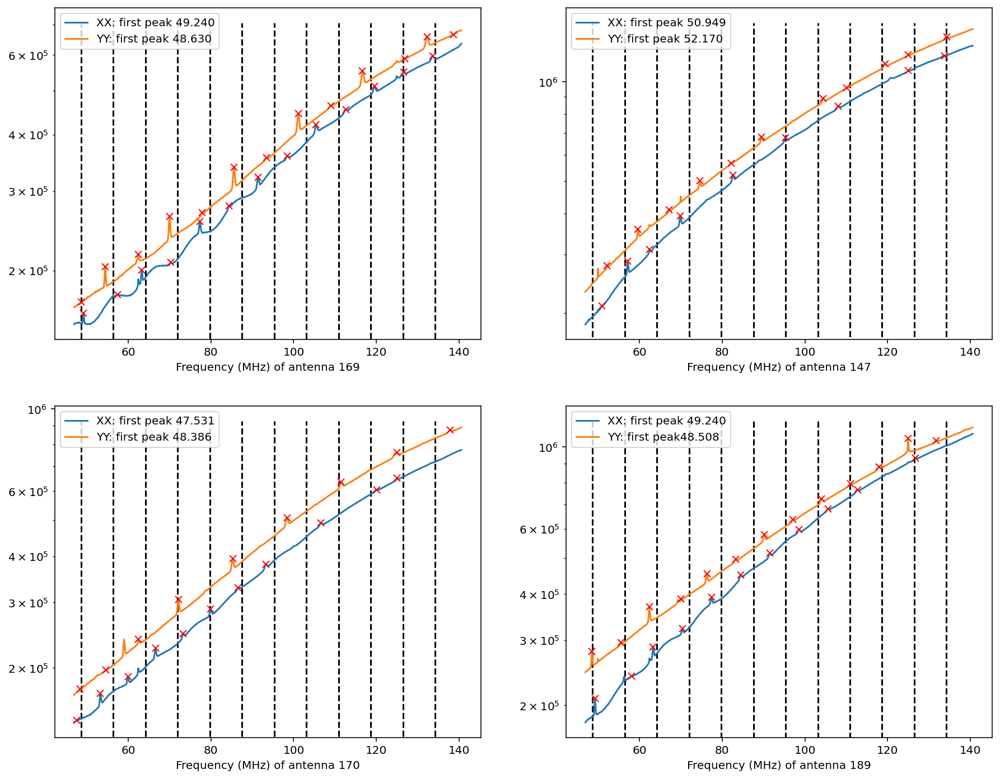

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

<Figure size 864x864 with 0 Axes>

In [65]:
plot_four_noclocks_even(169, 147, 170, 189, 48.630, 7.782, 12) #node 15

## Autocorrelations for a single file

This plot shows autocorrelations for one timestamp of each antenna that is active and each polarization. For each node, antennas are ordered by SNAP number, and within that by SNAP input number. The antenna number label color corresponds to the a priori status of that antenna.

In [59]:
print (uvdx.Nants_data)

71


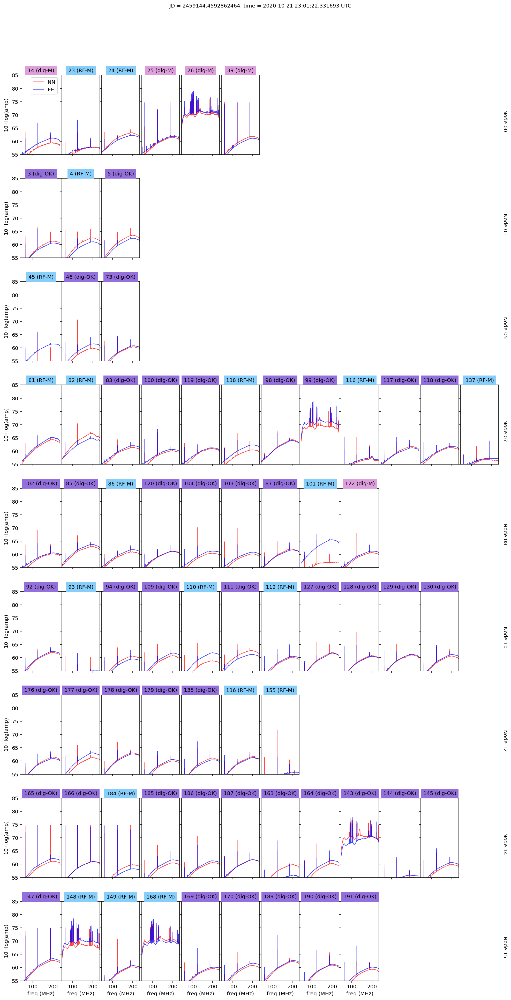

In [6]:
### plot autos
utils.plot_autos(uvdx, uvdy)

Delay Space Transforms

## Waterfalls of Autocorrelation Amplitudes for each Antenna and Each polarization

These plots show autocorrelation waterfalls of each antenna that is active and whose status qualifies for this notebook. For each node, antennas are ordered by SNAP number, and within that by SNAP input number. The antenna number label color corresponds to the a priori status of that antenna.

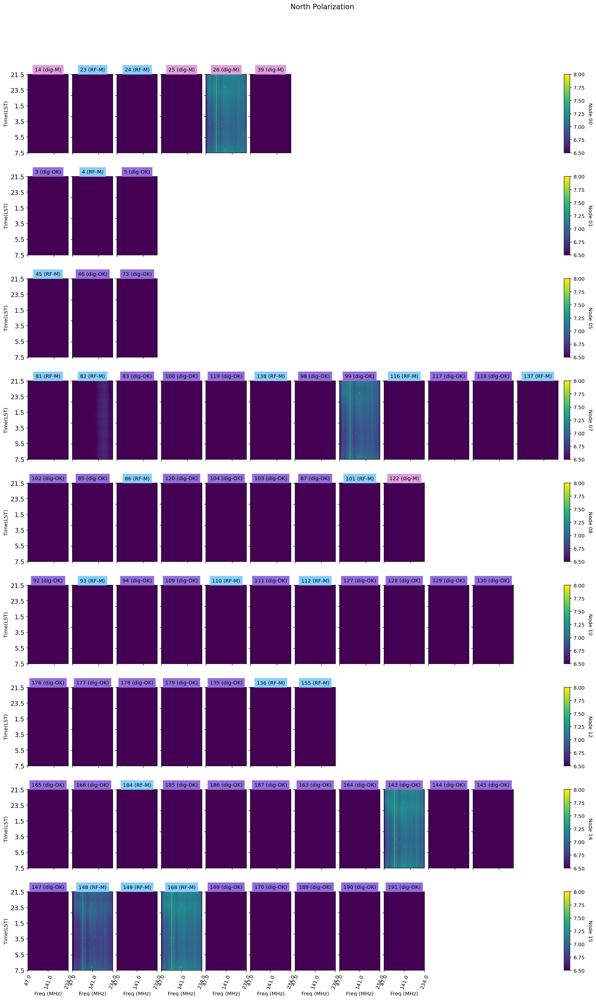

In [7]:
utils.plot_wfs(uvd, pol = 0)

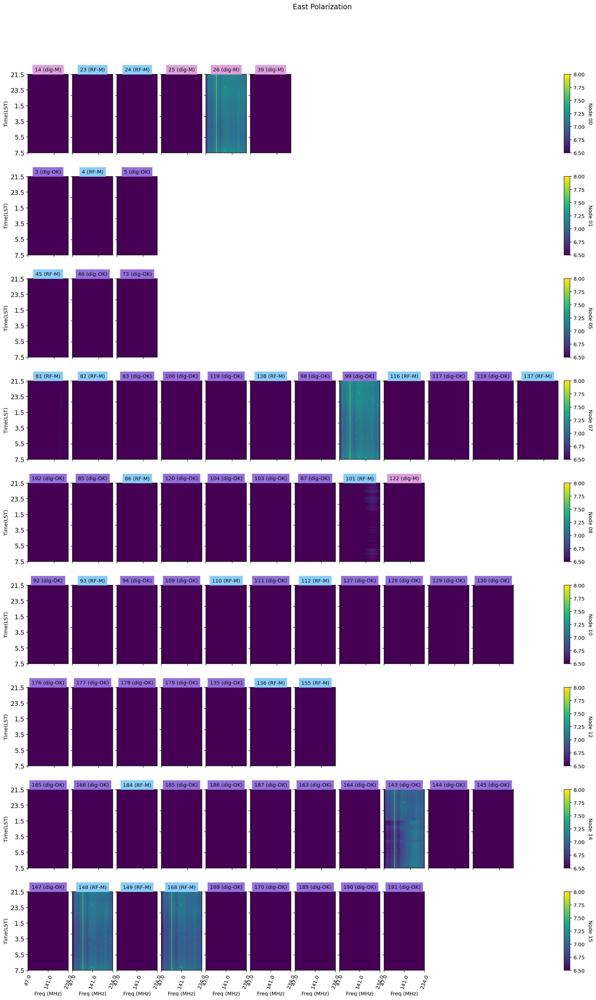

In [8]:
utils.plot_wfs(uvd, pol = 1)

## Correlation Metrics

The first plot shows the correlation metric (described below) for a set of baseline types, as calculated at several times throughout the night. It is expected that longer baselines (darker color) will exhibit lower values than the short baselines. 

The matrices show the phase correlation between antennas. Using the even and odd visibilities, each pixel is calculated as (even/abs(even)) * (conj(odd)/abs(odd)), and then averaged across time and frequency. If the phases are noise-like, this value will average down to zero. If the antennas are well correlated, the phases should not be noise-like, and this value should average to 1. The lines denoting node boundaries are intended to help confirm that inter-node correlations are functioning - if they aren't, this plot will appear block-diagonal.

This metric has shown to be LST locked - when comparing to other nights, be sure to compare for the same LST. It is expected that some LSTs will look much better or worse than others.

Note: Within each node, the order of antennas is determined by snap, and within that by snap input number. 

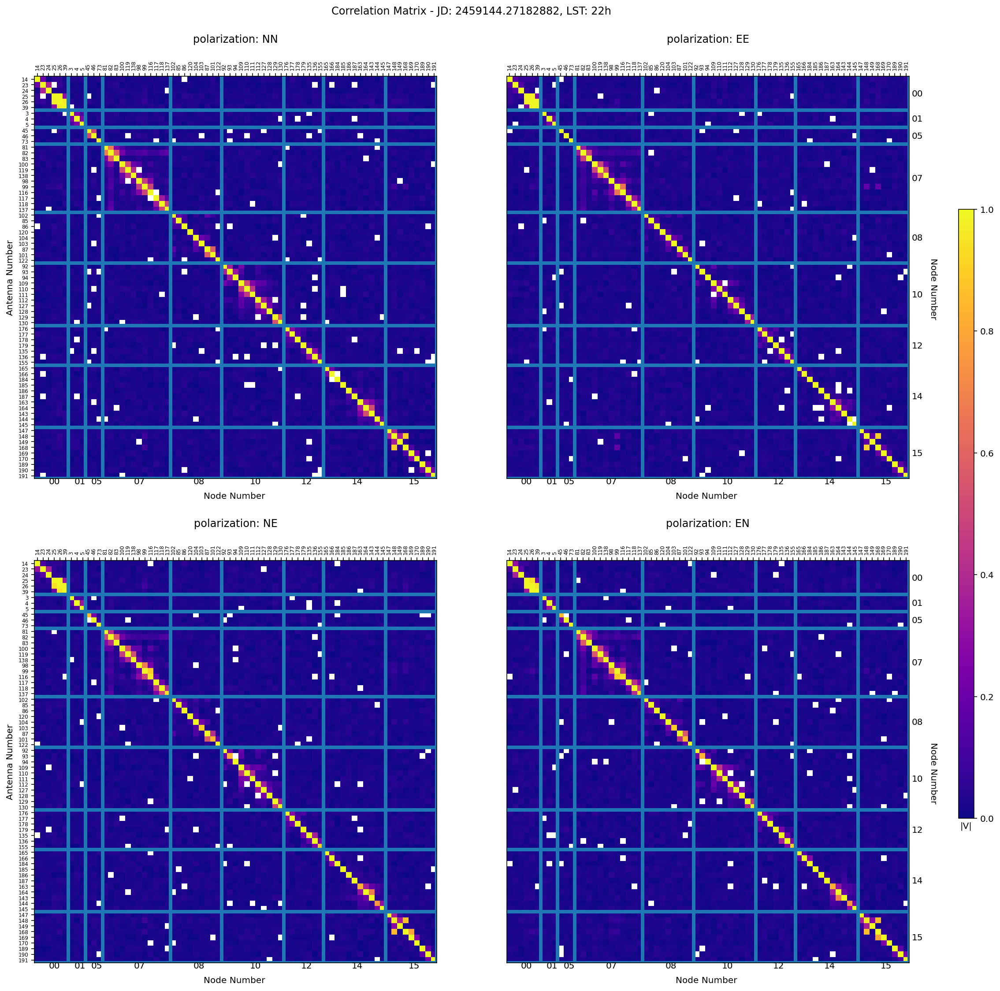

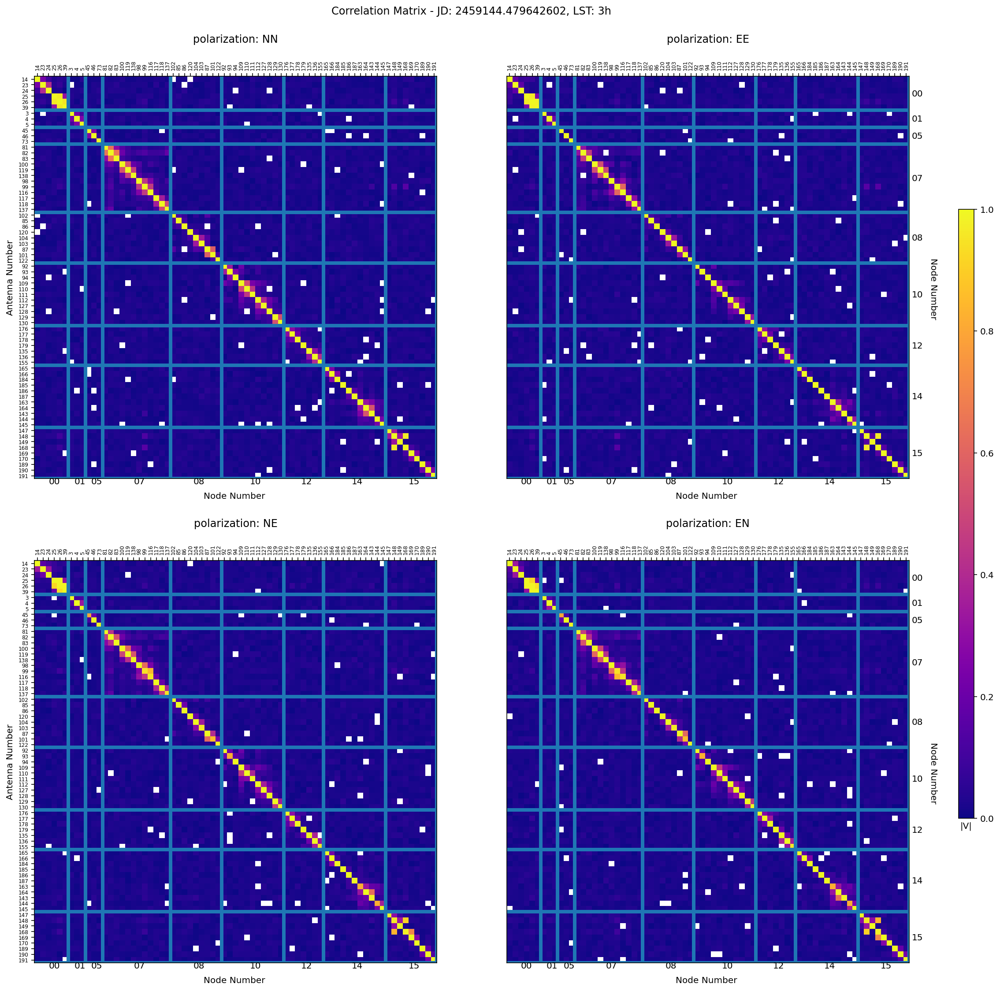

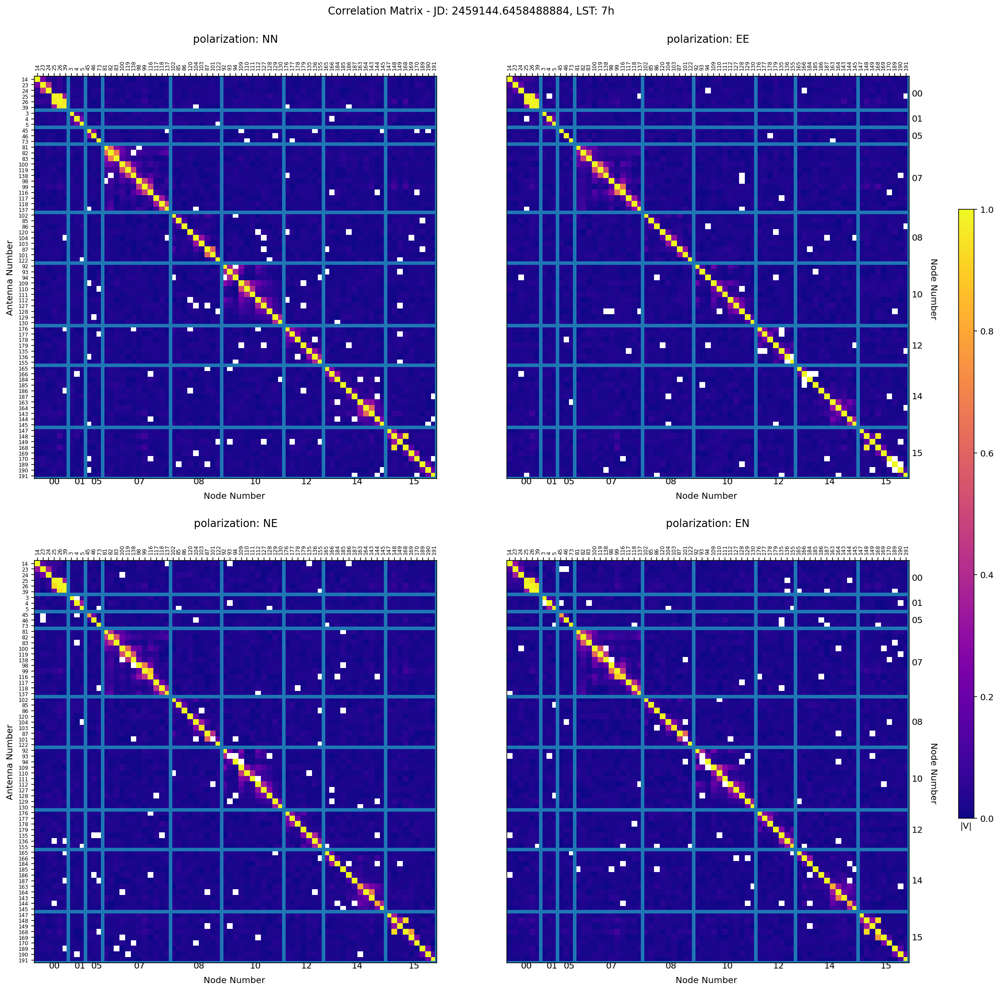

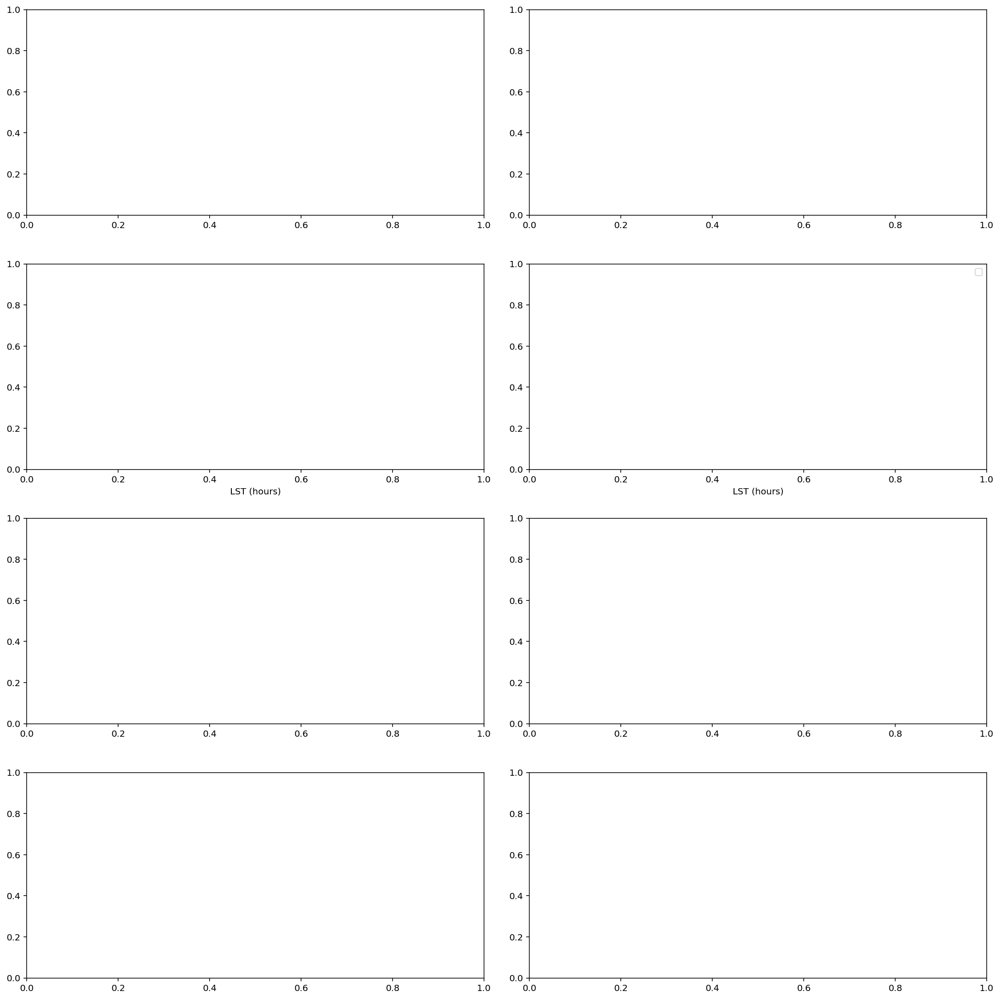

In [9]:
badAnts = []
badAnts = utils.plotNodeAveragedSummary(uvd,HHfiles,JD,use_ants,mat_pols=['xx','yy','xy','yx'])

Visibility amplitude spectra for a set of redundant baselines, labeled by inter vs. intranode baselines. The red and blue should exhibit the same bandpass shape - if the red are consistently different from the blue, this indicates an issue with internode correlations.

Note: antennas that were identified as bad by the correlation matrix have been removed from this plot.

Note: only a small number of baselines of orientation 14m NW-SE are available
Note: only a small number of baselines of orientation 14m E-W are available
Note: only a small number of baselines of orientation 29m E-W are available


<Figure size 432x288 with 0 Axes>

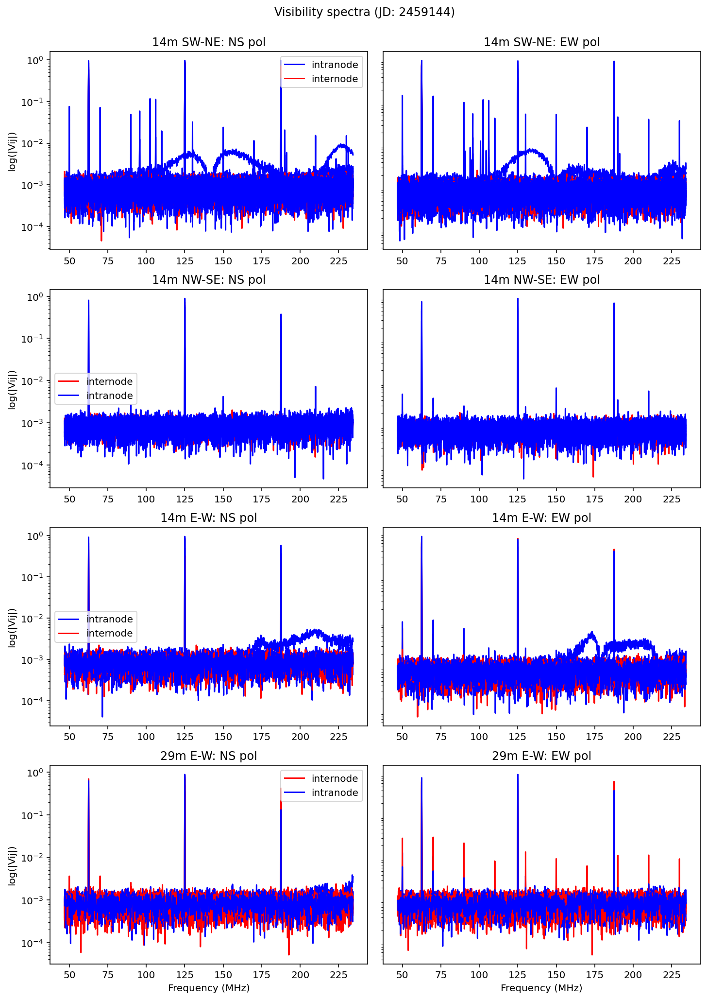

In [10]:
utils.plotVisibilitySpectra(HHfiles[len(HHfiles)//2+1], JD, use_ants, badAnts=badAnts)

## Even and Odd File Checks

A waterfall showing the ratio between the even and odd visibilities. The purpose of this is to highlight xengine failures, which will cause this value to fall to zero or go to infinity. If things are working properly, this value should be stable at 1. The boundaries between different x-engines are shown by the vertical white lines.

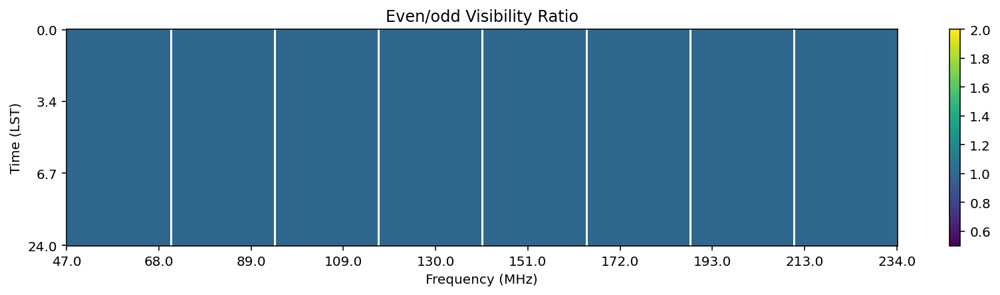

In [11]:
if len(HHautos) == len(diffautos):
    uvd_diff = UVData()
    uvd_diff.read(diffautos[::10], skip_bad_files=True, antenna_nums=use_ants)
    rat = utils.plotEvenOddWaterfalls(uvd,uvd_diff)
else:
    uvd_diff = UVData()
    use_diffs = [f for f in diffautos if '%s/zen.%s.%s.sum.autos.uvh5' % (data_path,f.split('.')[1],f.split('.')[2]) in HHautos[::10]]
    uvd_diff.read(use_diffs, skip_bad_files=True, antenna_nums = use_ants)
    uvd_sum = uvd.select(times=np.unique(uvd_diff.time_array),inplace=False)
    rat = utils.plotEvenOddWaterfalls(uvd_sum,uvd_diff)

## Crossed Antenna Check

These are differences between different panels of the correlation matrices shown above (see panel titles for specifics). Antennas showing as consistently blue are ones which are correlating stronger in the cross pols than in the auto pols, indicating that the antenna polarizations are likely crossed.

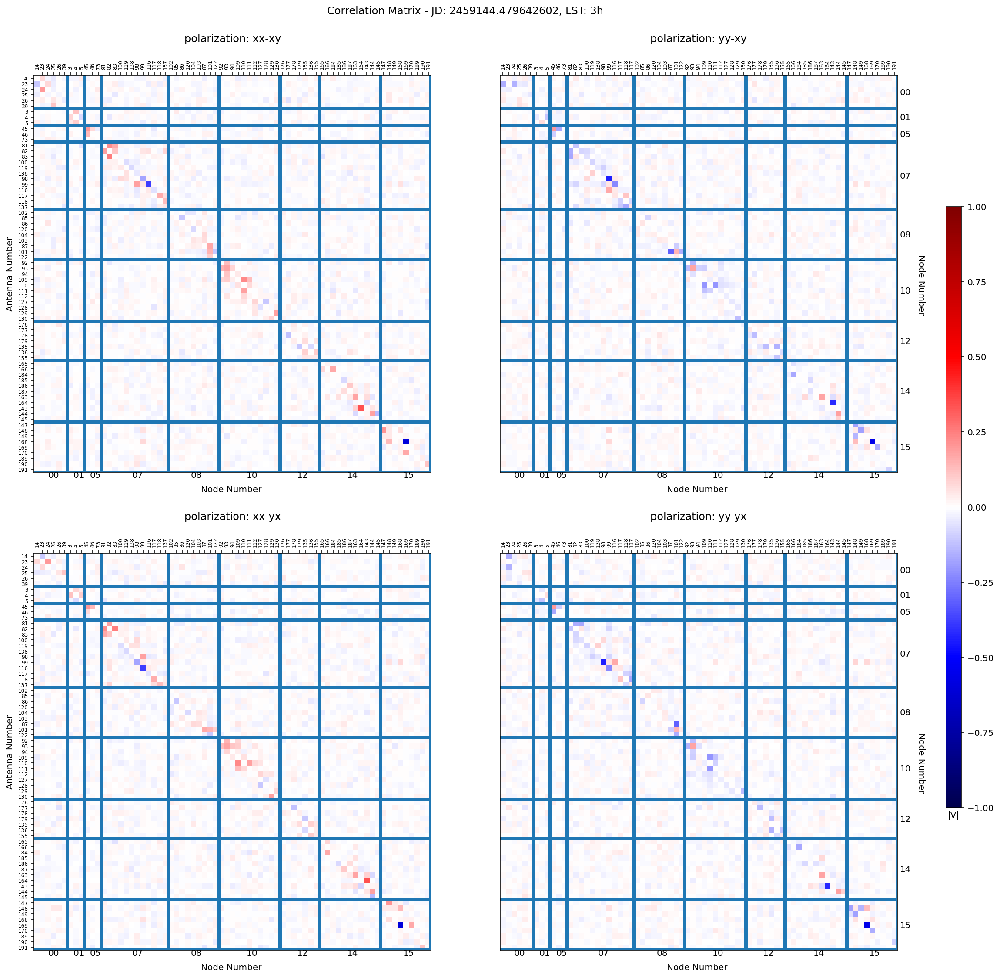

In [12]:
crossedAnts = utils.plotNodeAveragedSummary(uvd,HHfiles,JD,use_ants,mat_pols=['xx','yy','xy','yx'],plotRatios=True,
                                       plotSummary=False)

## Antenna Positions

Antennas outlined in black here have been identified by the correlation matrix as bad antennas. Antennas with a colorful outline correspond to their status as identified by ant_metrics (see above plot). Faded antennas are those not meeting the apriori status requirement for this notebook run. Gold stars are node box locations.

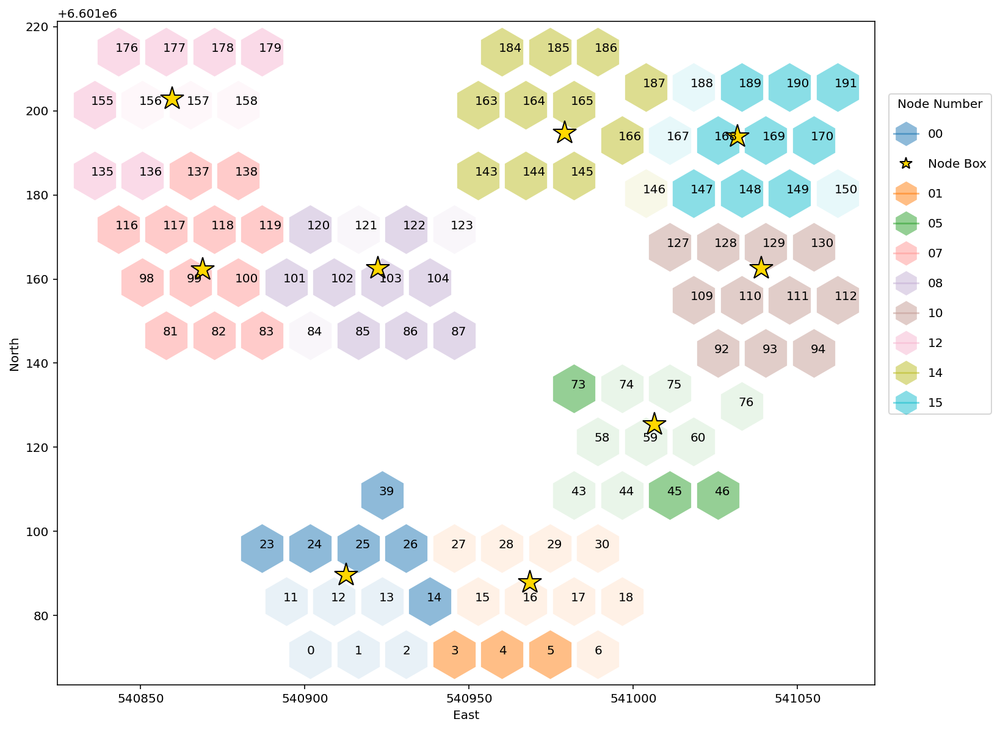

In [13]:
uvd1 = UVData()
uvd1.read(HHfiles[readInd], skip_bad_files=True)
utils.plot_antenna_positions(uvd1, badAnts=badAnts,use_ants=use_ants)

## Observer Inspection Plots

Antennas of status digital_OK or better that are flagged as bad by any of the above metrics are plotted here so observers can inspect their failures in more detail. Additionally, a 'good' template has been used to identify outliers. The upper line plots are averages over the whole observation, and the lower line plots are slices of a single time in the middle of the observation. These plots are recommended diagnostics for demoting antennas to lower statuses or reporting issues. If the plots below look OK, check other plots in notebook to hunt why the antenna was flagged. NOTE: The colorbar/power scales in these plots are NOT locked between antennas OR polarizations so that the detail will be visible on all plots. Be sure to check for reasonable power levels, as this may be the reason the antenna was flagged for inspection.

In [14]:
d, tempAnts = utils.flag_by_template(uvd,HHautos,JD,use_ants=use_ants,pols=['XX','YY'],plotMap=False)

No template for lst=0.0 - skipping
No template for lst=1.0 - skipping
No template for lst=2.0 - skipping
No template for lst=3.0 - skipping
No template for lst=4.0 - skipping


Antennas that require further inspection are:
[  5  85  98  99 111 143 144 147 163 177 178 189]


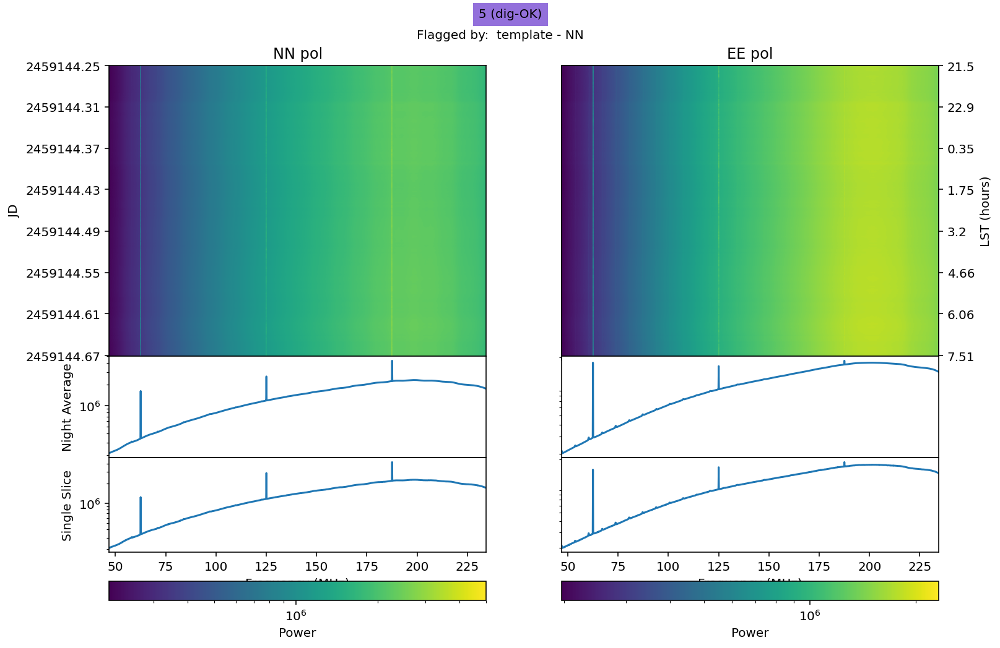

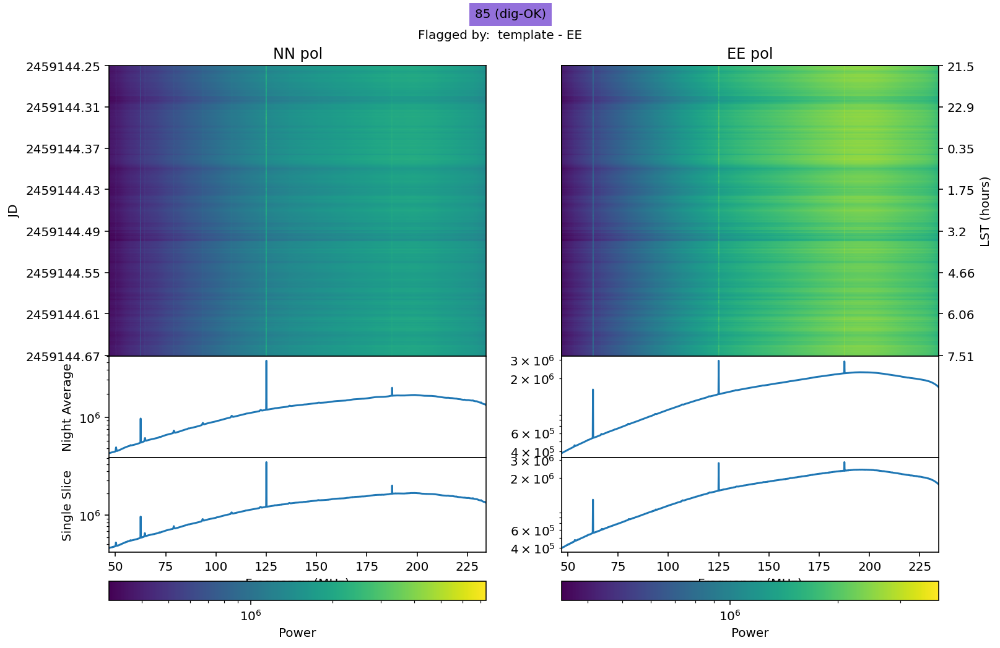

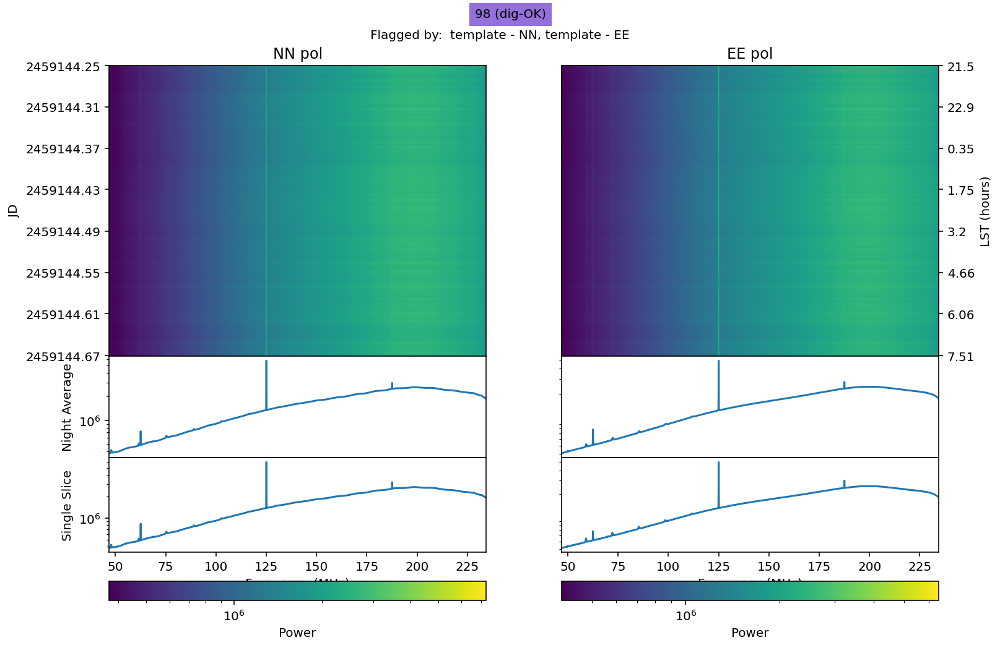

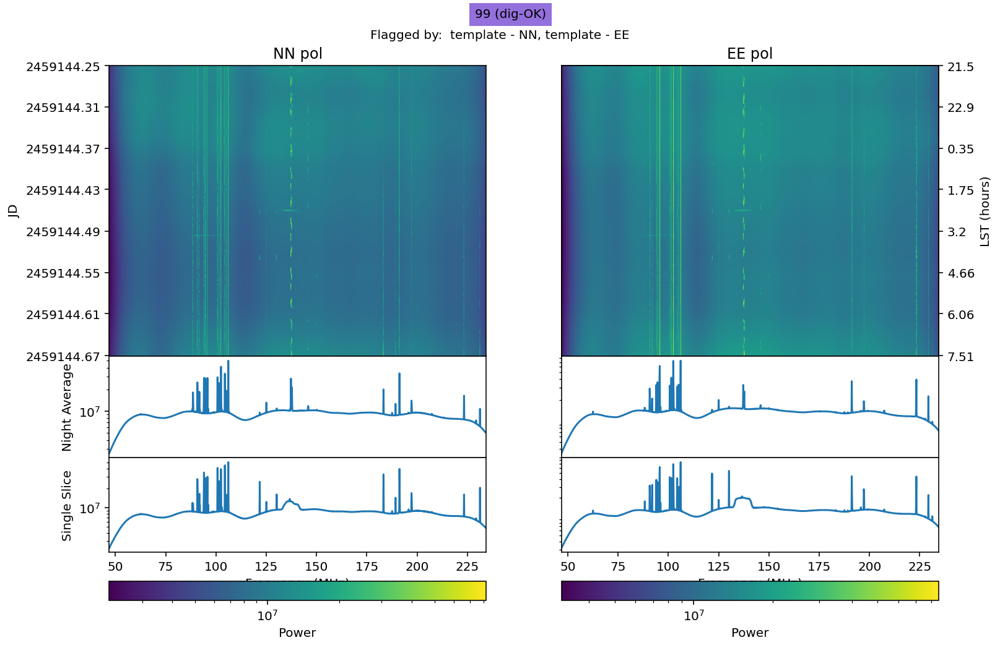

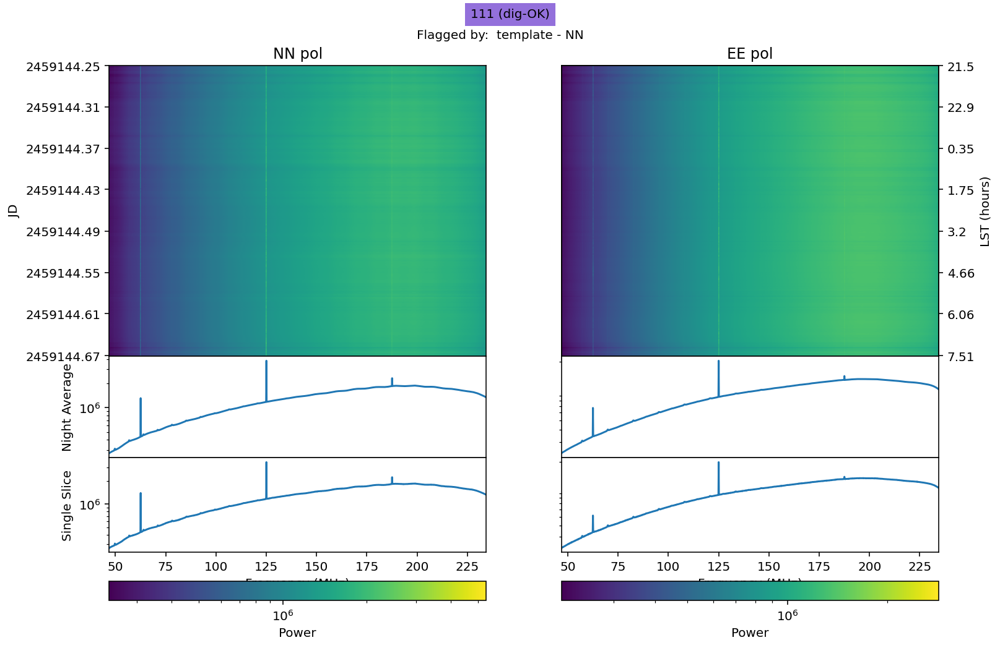

...

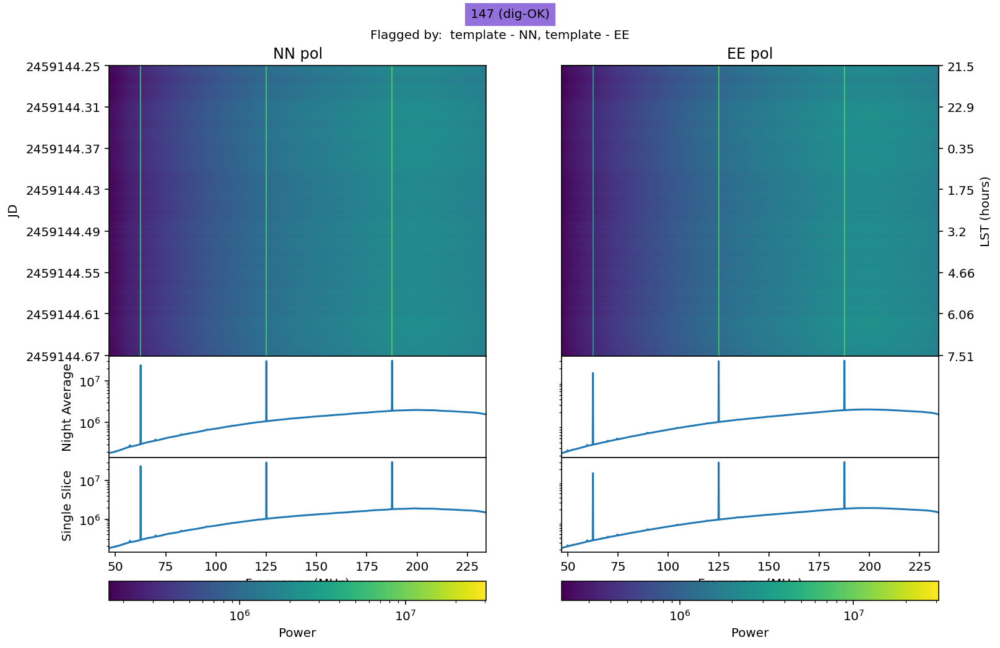

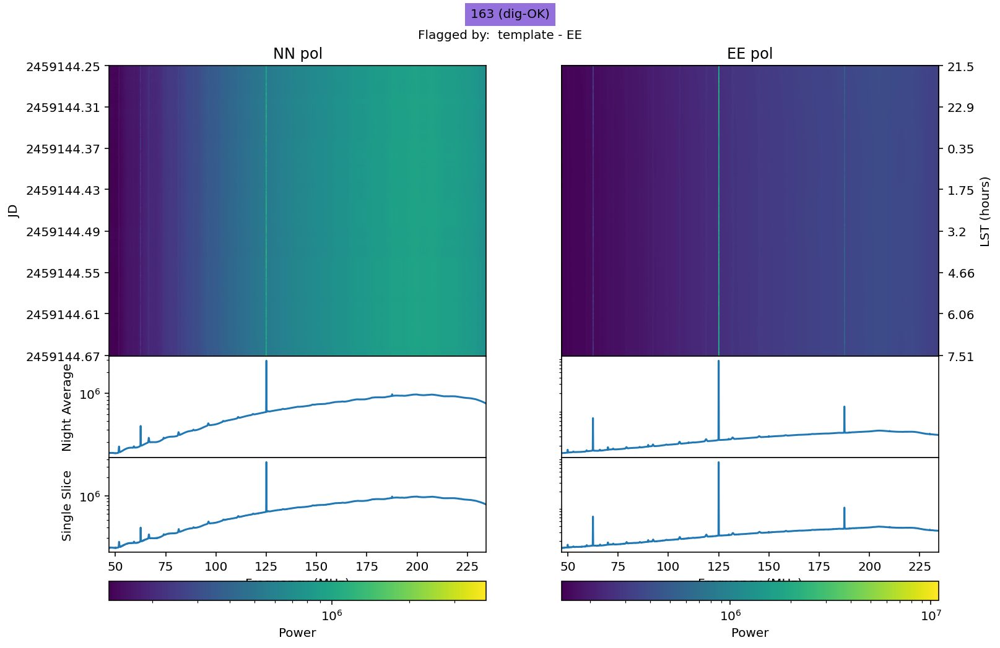

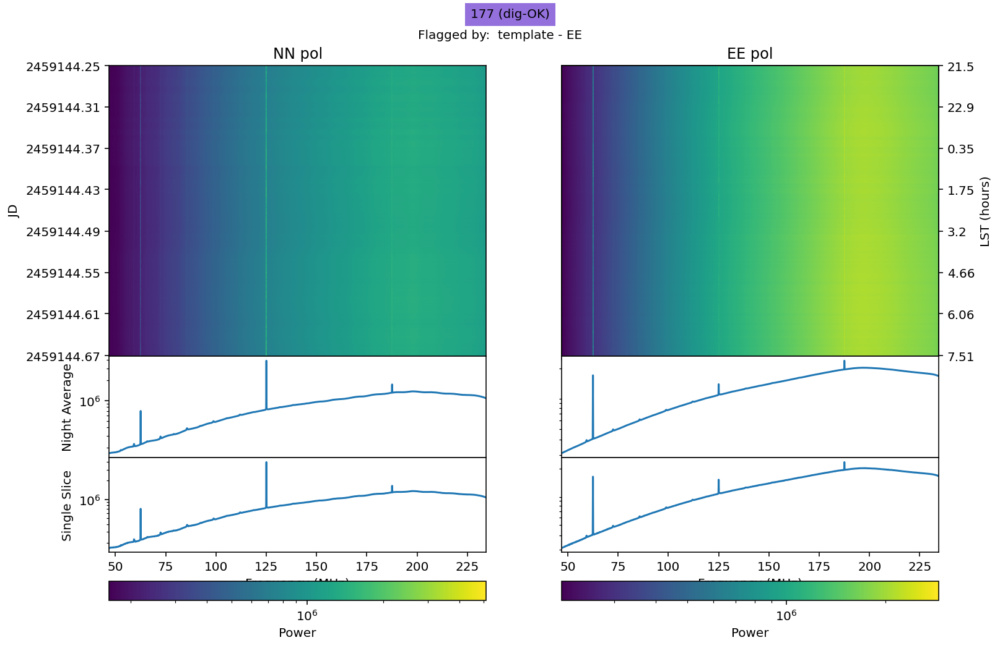

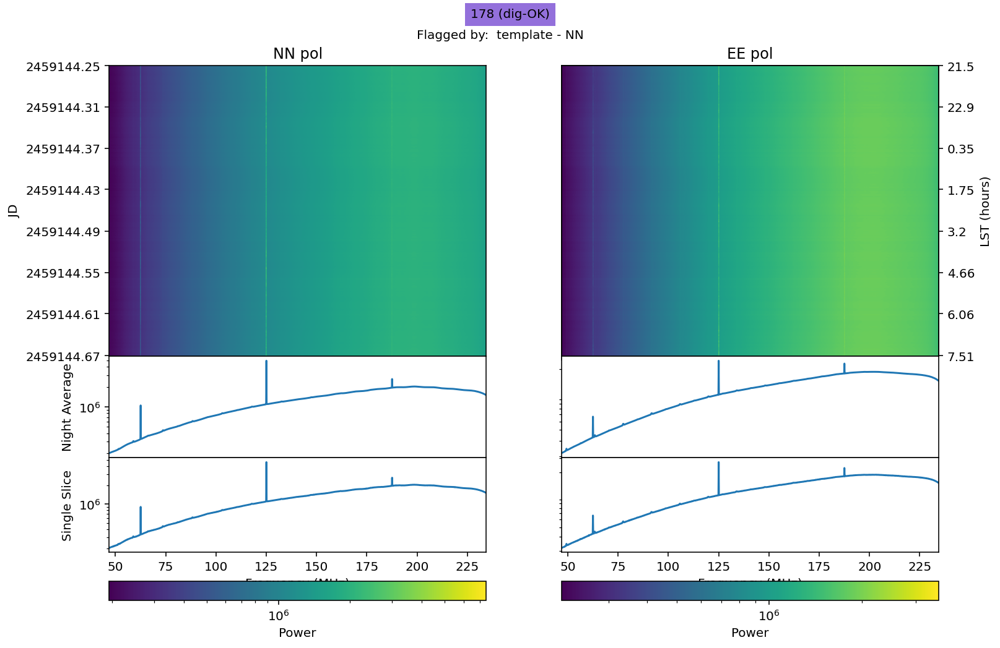

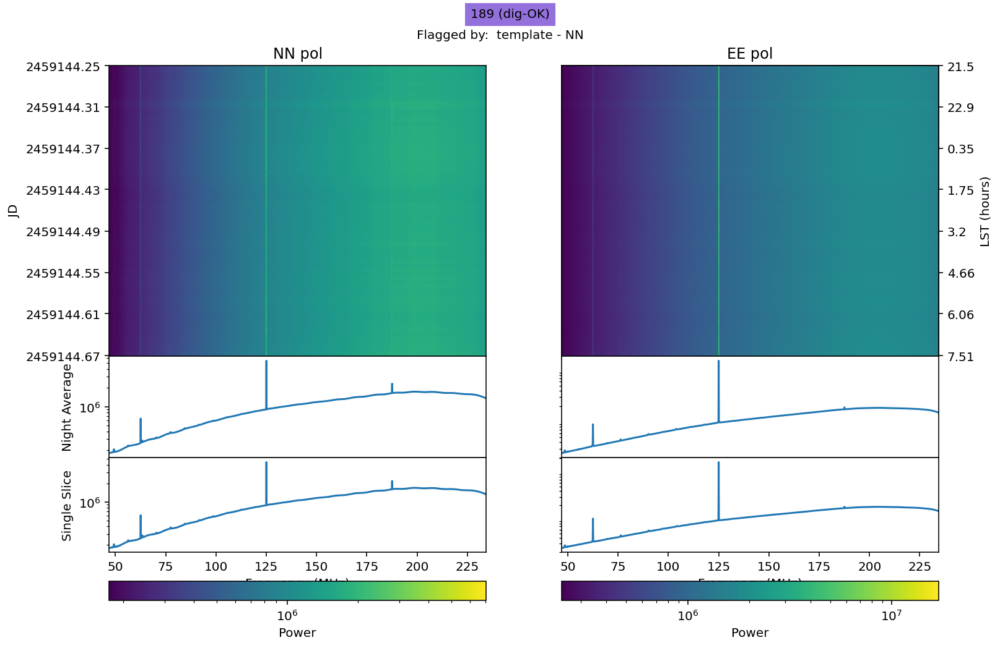

In [15]:
inspectAnts = utils.plot_inspect_ants(uvd,JD,badAnts=badAnts,use_ants=use_ants,
                                     tempAnts=tempAnts,crossedAnts=crossedAnts)

## Mean-Subtracted Waterfalls

Here the mean value in each frequency bin has been subtracted out. This effectively subtracts out the bandpass shape, making time variations more visible.

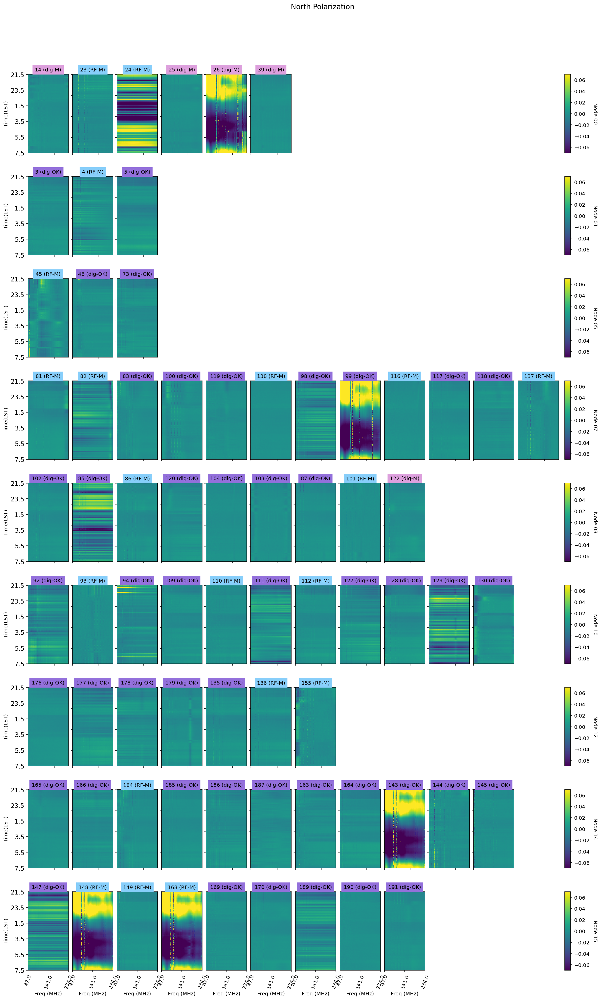

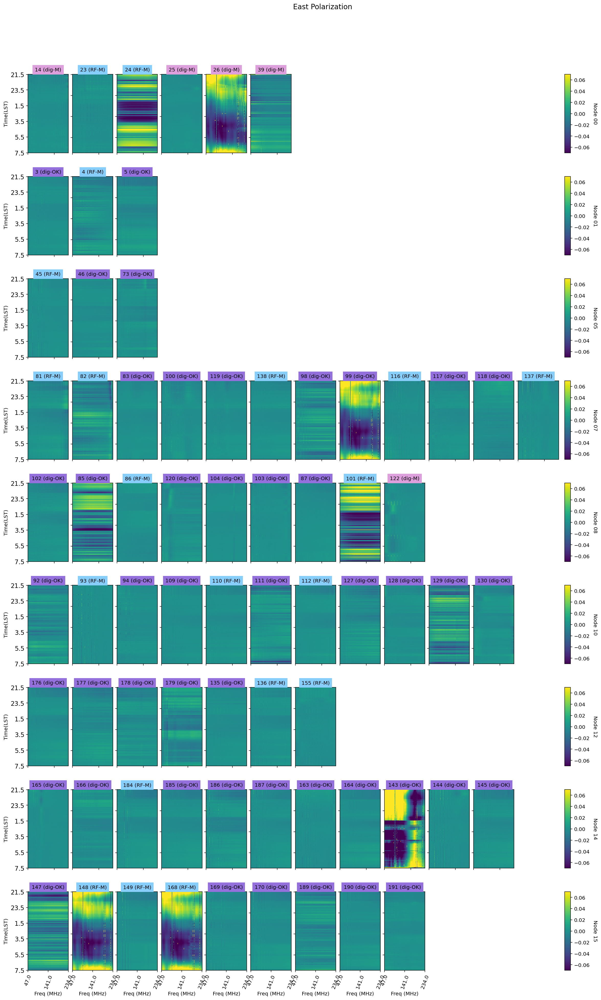

In [16]:
utils.plot_wfs(uvd,0,mean_sub=True,jd=JD)
utils.plot_wfs(uvd,1,mean_sub=True,jd=JD)